Screening attention heads for pretrained PixArt model with T5 embedding

In [ ]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
from os.path import join

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import torch
import torch.nn.functional as F

from diffusers import AutoencoderKL, Transformer2DModel, PixArtAlphaPipeline, DPMSolverMultistepScheduler
from transformers import T5Tokenizer, T5EncoderModel

sys.path.append("/n/home12/binxuwang/Github/DiffusionObjectRelation/PixArt-alpha")
from diffusion import IDDPM
from diffusion.data.builder import build_dataset, build_dataloader, set_data_root
from diffusion.model.builder import build_model
from diffusion.utils.misc import set_random_seed, read_config, init_random_seed, DebugUnderflowOverflow
from diffusion.model.nets.PixArt import get_2d_sincos_pos_embed

sys.path.append("/n/home12/binxuwang/Github/DiffusionObjectRelation")
from utils.pixart_sampling_utils import pipeline_inference_custom, PixArtAlphaPipeline_custom
from utils.pixart_utils import state_dict_convert
from utils.text_encoder_control_lib import RandomEmbeddingEncoder_wPosEmb
from utils.image_utils import pil_images_to_grid
from utils.attention_map_store_utils import replace_attn_processor, AttnProcessor2_0_Store, PixArtAttentionVisualizer_Store
from utils.cv2_eval_utils import find_classify_object_masks

/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


In [ ]:
import torch
from transformers import T5Tokenizer, T5EncoderModel
from diffusers import PixArtAlphaPipeline
from utils.pixart_sampling_utils import PixArtAlphaPipeline_custom
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
from transformers import T5Tokenizer, T5EncoderModel
T5_path = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/PixArt/output/pretrained_models/t5_ckpts/t5-v1_1-xxl"
tokenizer = T5Tokenizer.from_pretrained(T5_path, )#subfolder="tokenizer")
text_encoder = T5EncoderModel.from_pretrained(T5_path, load_in_8bit=False, torch_dtype=torch.float16, )
# 1. Load a real T5 tokenizer
# tokenizer = T5Tokenizer.from_pretrained("t5-large")

# 2. (Optionally) load the text encoder if you want to do 8-bit low-VRAM
# text_encoder = T5EncoderModel.from_pretrained(
#     "PixArt-alpha/PixArt-XL-2-512x512",
#     subfolder="text_encoder",
#     load_in_8bit=False,
#     torch_dtype=torch.float16, 
#     device_map="auto",
# )

# 3. Now load the pipeline with your actual tokenizer (and text encoder)
pipe = PixArtAlphaPipeline_custom.from_pretrained(
    "PixArt-alpha/PixArt-XL-2-512x512",
    tokenizer=tokenizer,
    text_encoder=text_encoder,
    torch_dtype=torch.float16, use_safetensors=True,
    device="cuda"
)

/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Keyword arguments {'device': 'cuda'} are not expected by PixArtAlphaPipeline_custom and will be ignored.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

Some weights of the model checkpoint were not used when initializing PixArtTransformer2DModel: 
 ['caption_projection.y_embedding']


In [32]:
pipe.transformer.to("cuda") 
pipe.vae.to("cuda") 
pipe.text_encoder.to("cuda") ;

torch.Size([2, 120, 4096])
torch.Size([2, 120])


  0%|          | 0/20 [00:00<?, ?it/s]

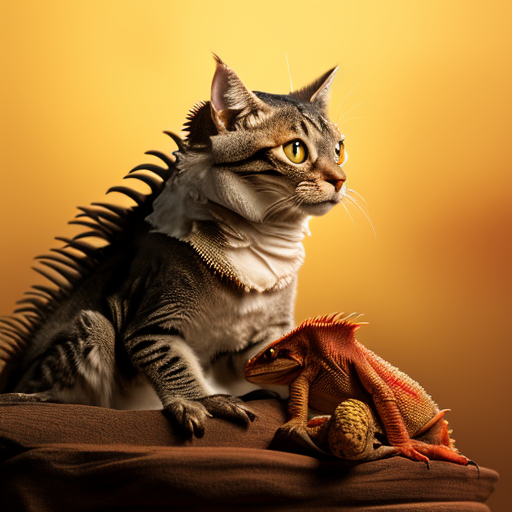

In [34]:
prompt = "A cat cat cat sitting on top of an iguana"
image = pipe(prompt, device="cuda", ).images[0]
image

In [35]:
prompt = "A cat cat cat sitting on top of an iguana"
image = pipe(prompt, device="cuda", num_inference_steps=20, num_images_per_prompt=1, guidance_scale=4.5, output_type="latent").images[0]
image

torch.Size([2, 120, 4096])
torch.Size([2, 120])


  0%|          | 0/20 [00:00<?, ?it/s]

tensor([[[-1.5078, -1.2090, -1.2559,  ..., -1.2002, -1.1758, -1.2373],
         [-1.4268, -1.1865, -1.0508,  ..., -1.0420, -0.9956, -1.1660],
         [-1.2500, -0.9917, -1.0557,  ..., -0.9849, -0.9355, -1.1396],
         ...,
         [-1.4326, -1.7686, -0.3218,  ...,  0.6699,  0.6968,  1.0059],
         [-1.8525, -1.5771,  0.1453,  ...,  0.3643,  0.2115,  0.3494],
         [-1.3125, -1.6230, -1.0166,  ...,  0.0732, -0.1570, -0.8257]],

        [[-2.5508, -2.4453, -2.3984,  ..., -2.3477, -2.4453, -1.9697],
         [-2.5859, -2.4160, -2.4922,  ..., -2.3965, -2.4707, -2.4414],
         [-2.4238, -2.5625, -2.4824,  ..., -2.3613, -2.4805, -2.4766],
         ...,
         [-2.5918, -2.6719, -1.3623,  ..., -0.0327, -0.2314, -1.3066],
         [-2.6035, -2.5078, -1.2100,  ..., -0.2712,  0.2412, -0.7036],
         [-2.6309, -2.1973, -1.2588,  ...,  0.2207,  0.1175, -1.2217]],

        [[ 0.6846,  0.9067,  0.9028,  ...,  1.0293,  1.0059,  1.2002],
         [ 0.5493,  1.3467,  1.2275,  ...,  1

In [29]:
image.shape

torch.Size([4, 64, 64])

### PixArt Alpha

In [38]:
pipe.transformer.transformer_blocks[2].attn2.heads

16

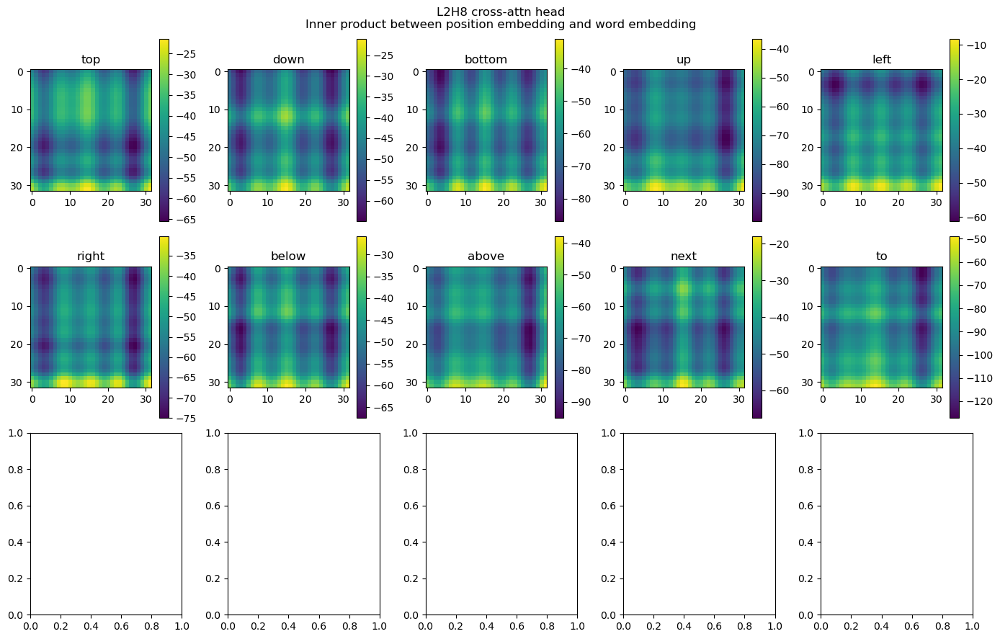

In [58]:
hidden_size = 1152
base_size = 64 // 2
num_heads = 16
head_dim = hidden_size // num_heads
head_idx = 8
layer_idx = 10
device = "cuda"
prompt = "top down bottom up left right below above next to"
prompt_tokenized = prompt.split(" ")
token_ids = pipe.tokenizer.encode(" ".join(prompt_tokenized), max_length=30, truncation=False, return_tensors="pt").to(device)
with torch.no_grad():
    word_embeds = pipe.text_encoder(token_ids).last_hidden_state # , attn_mask
word_embeds_proj = pipe.transformer.caption_projection(word_embeds)
word_embed_2k = pipe.transformer.transformer_blocks[layer_idx].attn2.to_k(word_embeds_proj)
word_embed_2k_h8 = word_embed_2k[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
word_embed_2v = pipe.transformer.transformer_blocks[layer_idx].attn2.to_v(word_embeds_proj)
word_embed_2v_h8 = word_embed_2v[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
# word_embed_2v_h8_zero_pad = torch.zeros_like(word_embed_2v)
# word_embed_2v_h8_zero_pad[:, head_idx*head_dim:(head_idx+1)*head_dim] = word_embed_2v_h8

pos_embed = get_2d_sincos_pos_embed(hidden_size, (base_size, base_size), base_size=base_size)
pos_embed = torch.from_numpy(pos_embed).unsqueeze(0).to(torch.float32).to(device)
pos_embed_2q = pipe.transformer.transformer_blocks[layer_idx].attn2.to_q(pos_embed.half().cuda())
pos_embed_2q_h8 = pos_embed_2q[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
figh, axs = plt.subplots(3, 5, figsize=(14, 9))
axs = axs.flatten()
inner_prods = (pos_embed_2q_h8 @ word_embed_2k_h8.T).detach().cpu()
for i_word in range(len(prompt_tokenized)):
    plt.sca(axs[i_word])
    inner_prod = inner_prods[:, i_word:i_word+1]
    plt.imshow(inner_prod.view(base_size, base_size).detach().cpu().numpy(), )
    plt.colorbar()
    plt.title(prompt_tokenized[i_word])
plt.suptitle(f"L2H8 cross-attn head\nInner product between position embedding and word embedding")
plt.tight_layout()
plt.show()

In [59]:
pipe.transformer.config

FrozenDict([('num_attention_heads', 16),
            ('attention_head_dim', 72),
            ('in_channels', 4),
            ('out_channels', 8),
            ('num_layers', 28),
            ('dropout', 0.0),
            ('norm_num_groups', 32),
            ('cross_attention_dim', 1152),
            ('attention_bias', True),
            ('sample_size', 64),
            ('patch_size', 2),
            ('activation_fn', 'gelu-approximate'),
            ('num_embeds_ada_norm', 1000),
            ('upcast_attention', False),
            ('norm_type', 'ada_norm_single'),
            ('norm_elementwise_affine', False),
            ('norm_eps', 1e-06),
            ('interpolation_scale', None),
            ('use_additional_conditions', None),
            ('caption_channels', 4096),
            ('attention_type', 'default'),
            ('_use_default_values',
             ['use_additional_conditions', 'interpolation_scale']),
            ('_class_name', 'PixArtTransformer2DModel'),
            

Layer 0, Head 0
Layer 1, Head 0
Layer 2, Head 0
Layer 3, Head 0
Layer 4, Head 0
Layer 5, Head 0
Layer 6, Head 0
Layer 7, Head 0
Layer 8, Head 0
Layer 9, Head 0
Layer 10, Head 0
Layer 11, Head 0
Layer 12, Head 0
Layer 12, Head 0 has max inner product 13.4140625 | Padding inner product 22.46875 Examine.


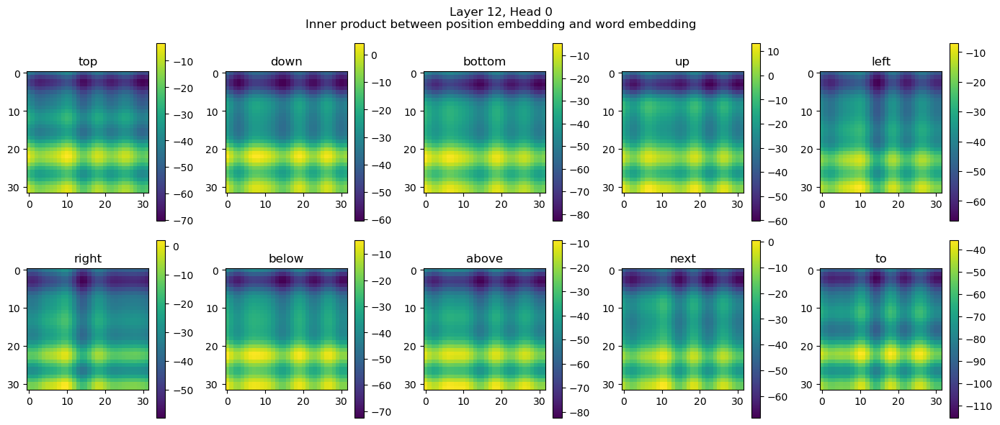

Layer 13, Head 0
Layer 13, Head 0 has max inner product 12.8125 | Padding inner product 32.53125 Examine.


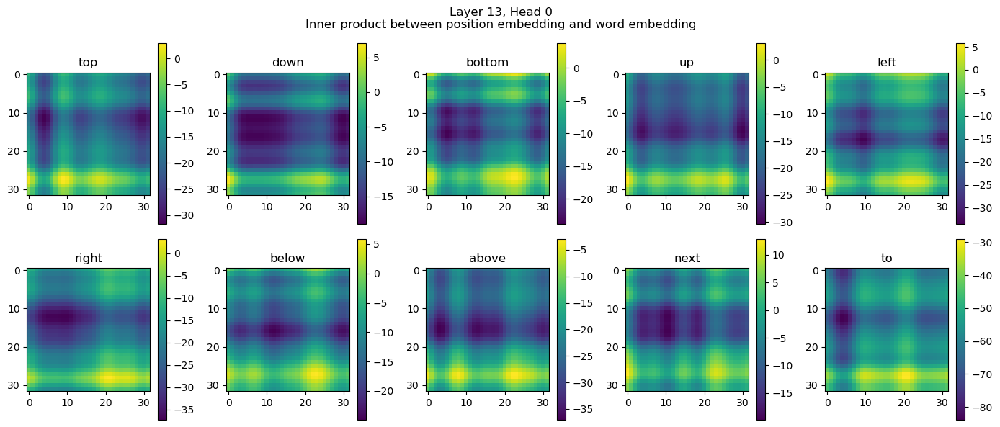

Layer 14, Head 0
Layer 14, Head 0 has max inner product 19.09375 | Padding inner product 4.22265625 Examine.


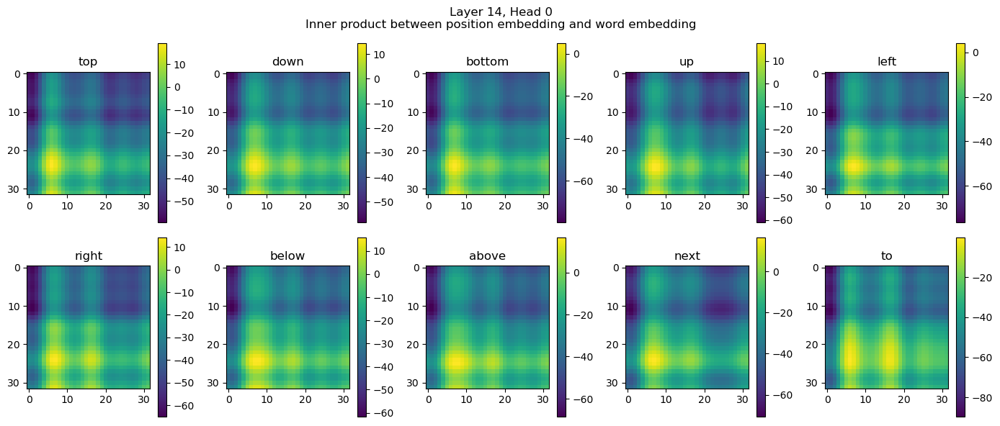

Layer 15, Head 0
Layer 15, Head 0 has max inner product 350.0 | Padding inner product 363.5 Examine.


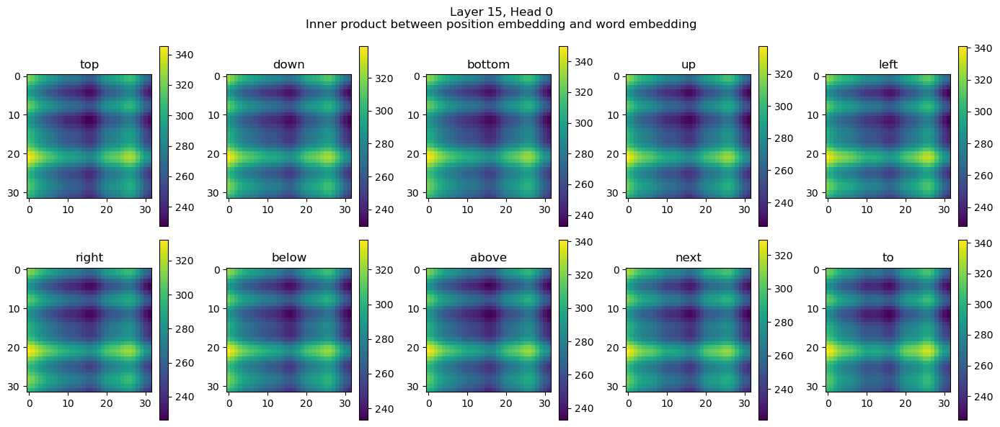

Layer 16, Head 0
Layer 17, Head 0
Layer 17, Head 0 has max inner product 710.0 | Padding inner product 714.0 Examine.


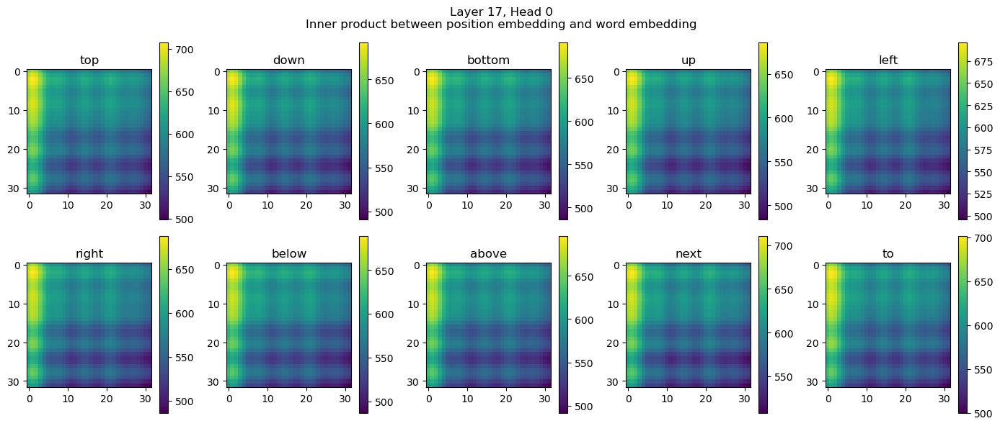

Layer 18, Head 0
Layer 18, Head 0 has max inner product 329.75 | Padding inner product 337.5 Examine.


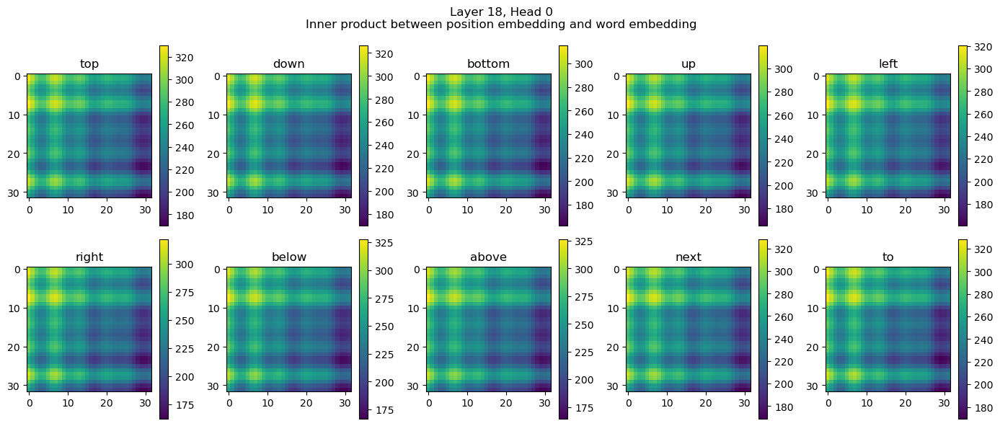

Layer 19, Head 0
Layer 19, Head 0 has max inner product 141.125 | Padding inner product 135.25 Examine.


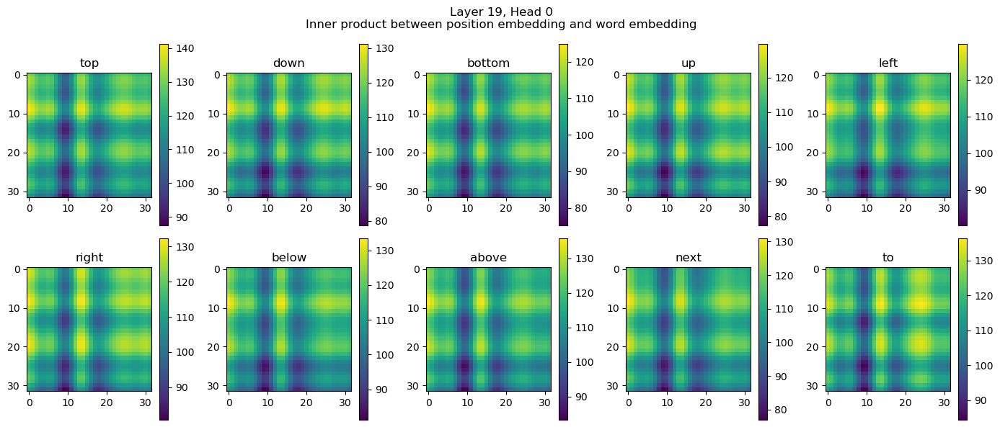

Layer 20, Head 0
Layer 20, Head 0 has max inner product 125.0625 | Padding inner product 131.5 Examine.


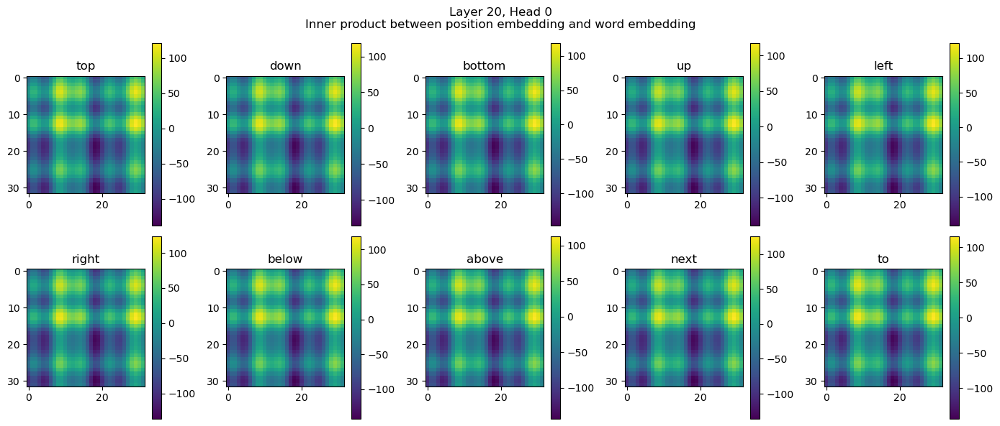

Layer 21, Head 0
Layer 22, Head 0
Layer 23, Head 0
Layer 23, Head 0 has max inner product 191.625 | Padding inner product 195.25 Examine.


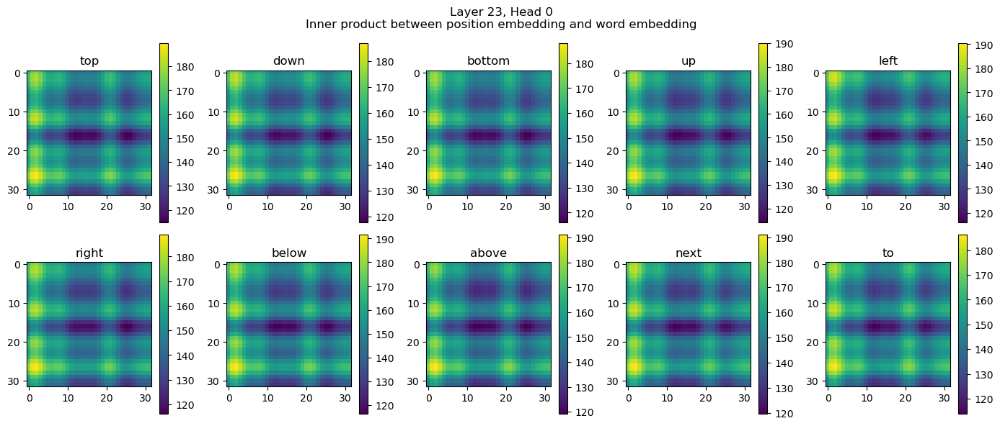

Layer 24, Head 0
Layer 24, Head 0 has max inner product 865.5 | Padding inner product 865.5 Examine.


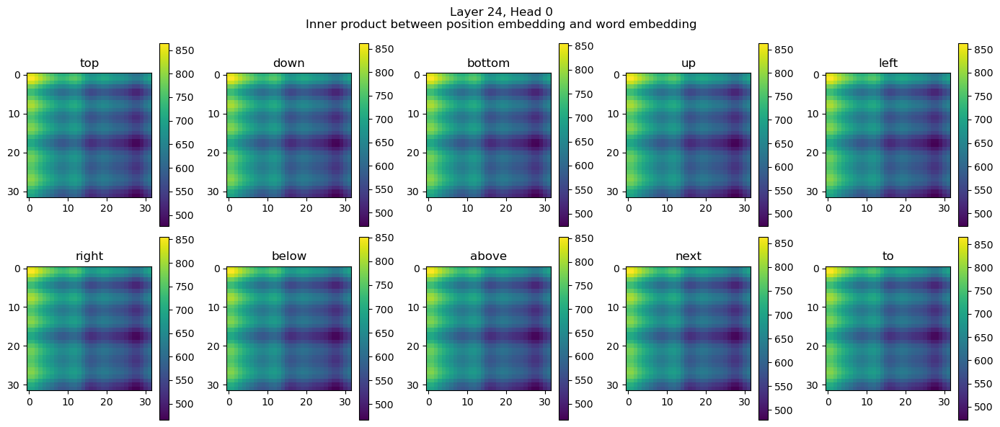

Layer 25, Head 0
Layer 25, Head 0 has max inner product 5732.0 | Padding inner product 5756.0 Examine.


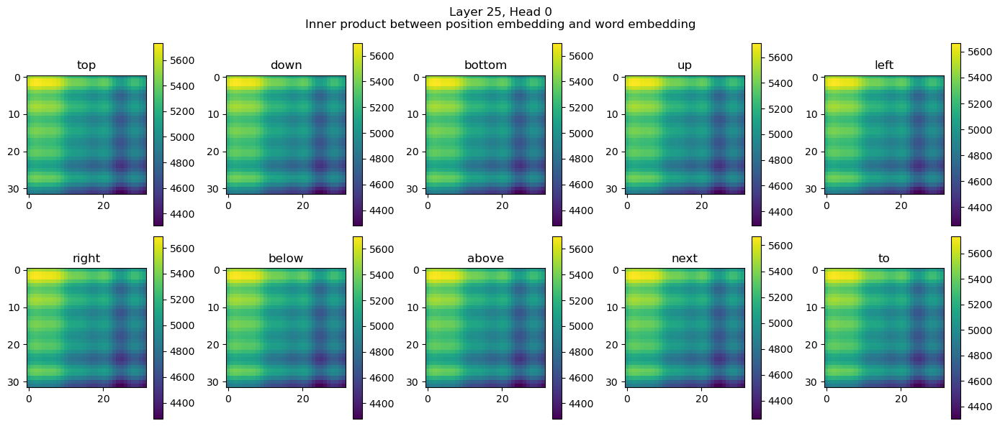

Layer 26, Head 0
Layer 26, Head 0 has max inner product 879.0 | Padding inner product 879.5 Examine.


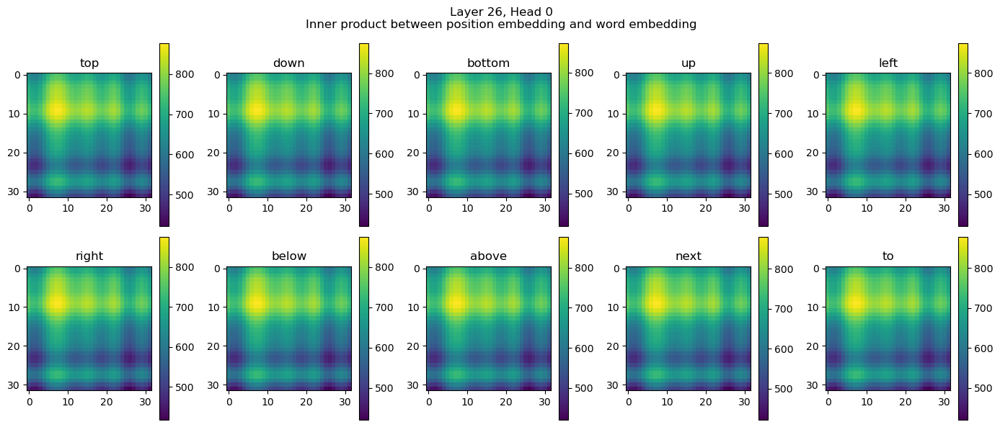

Layer 27, Head 0
Layer 27, Head 0 has max inner product 29.515625 | Padding inner product 49.0 Examine.


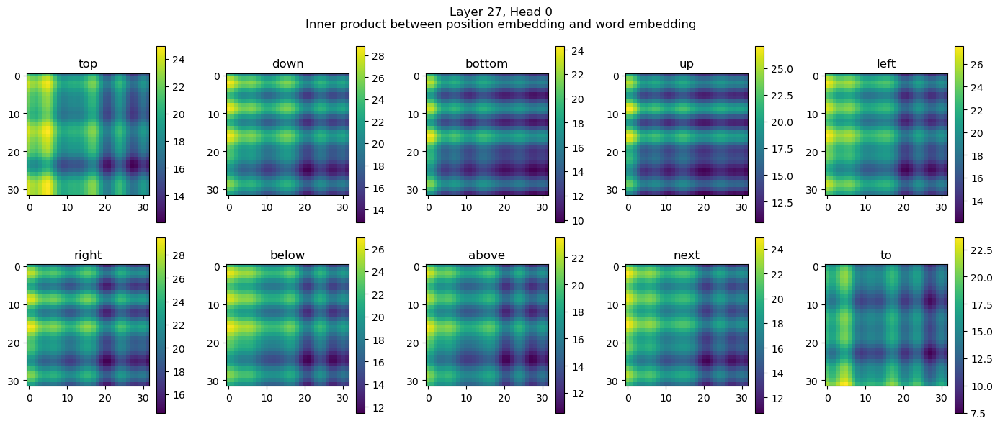

Layer 0, Head 1
Layer 1, Head 1
Layer 2, Head 1
Layer 3, Head 1
Layer 4, Head 1
Layer 5, Head 1
Layer 6, Head 1
Layer 7, Head 1
Layer 8, Head 1
Layer 9, Head 1
Layer 10, Head 1
Layer 10, Head 1 has max inner product 72.4375 | Padding inner product 72.8125 Examine.


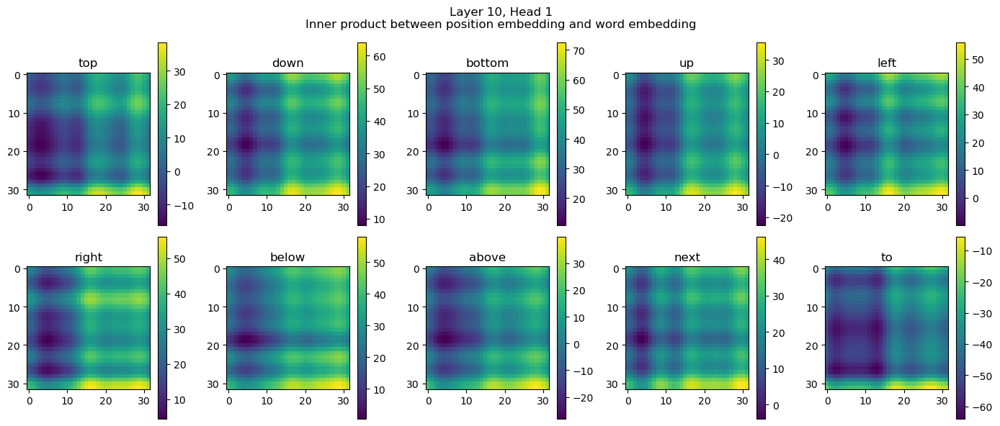

Layer 11, Head 1
Layer 11, Head 1 has max inner product 61.03125 | Padding inner product 51.4375 Examine.


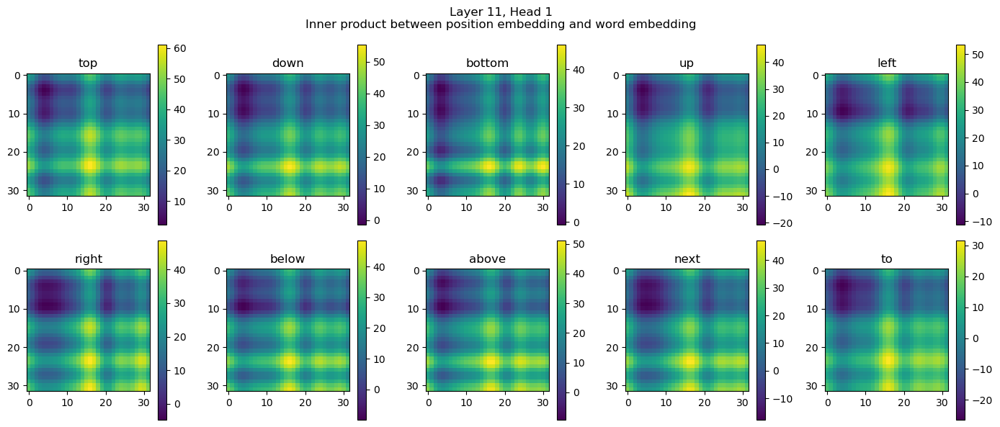

Layer 12, Head 1
Layer 12, Head 1 has max inner product 32.71875 | Padding inner product 29.1875 Examine.


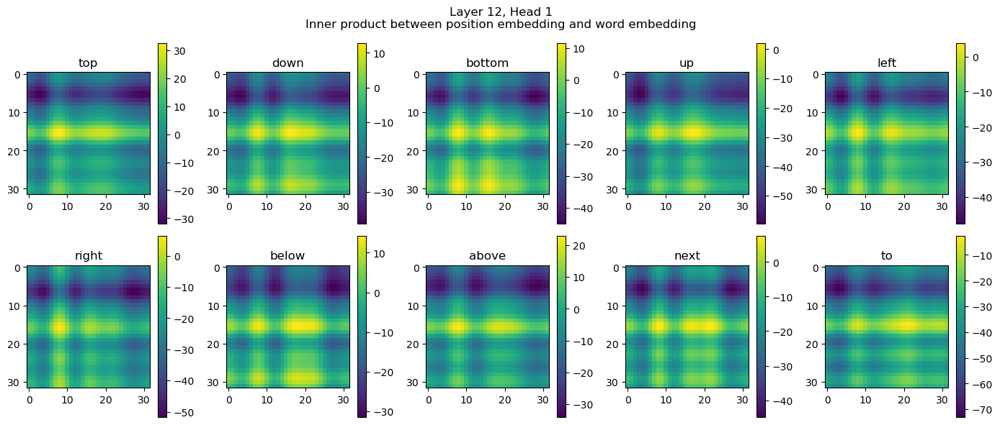

Layer 13, Head 1
Layer 13, Head 1 has max inner product 38.28125 | Padding inner product 61.625 Examine.


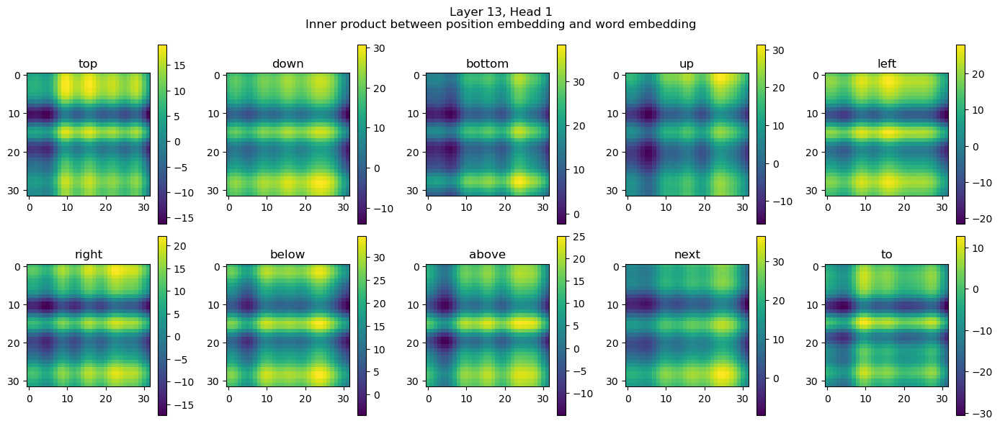

Layer 14, Head 1
Layer 15, Head 1
Layer 16, Head 1
Layer 17, Head 1
Layer 18, Head 1
Layer 19, Head 1
Layer 19, Head 1 has max inner product 78.3125 | Padding inner product 84.125 Examine.


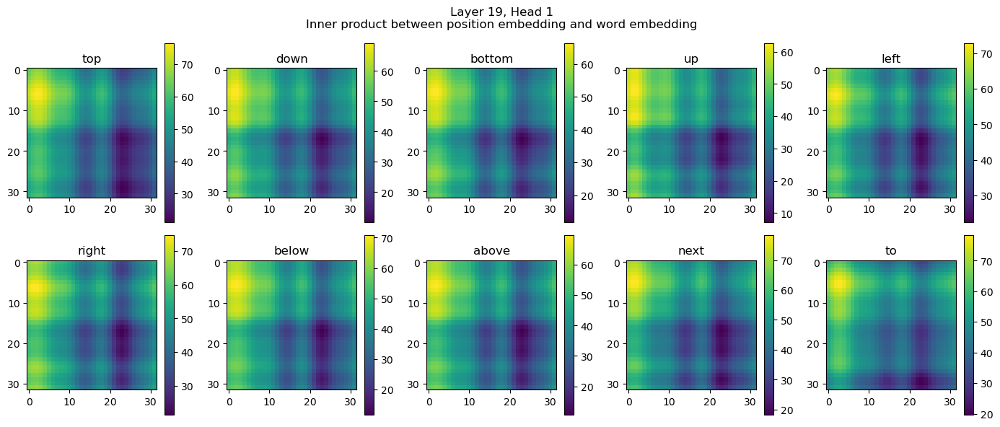

Layer 20, Head 1
Layer 21, Head 1
Layer 22, Head 1
Layer 23, Head 1
Layer 24, Head 1
Layer 25, Head 1
Layer 25, Head 1 has max inner product 29.34375 | Padding inner product 30.796875 Examine.


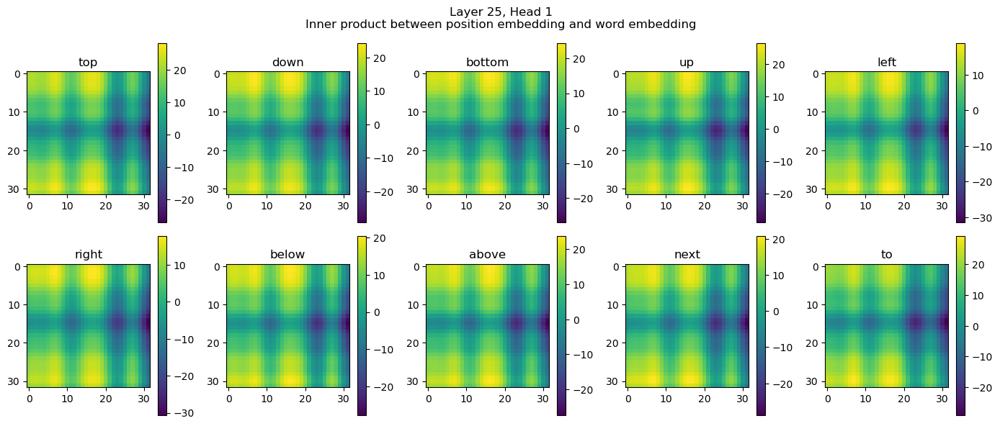

Layer 26, Head 1
Layer 27, Head 1
Layer 0, Head 2
Layer 1, Head 2
Layer 2, Head 2
Layer 3, Head 2
Layer 4, Head 2
Layer 5, Head 2
Layer 6, Head 2
Layer 7, Head 2
Layer 7, Head 2 has max inner product 59.90625 | Padding inner product 189.5 Examine.


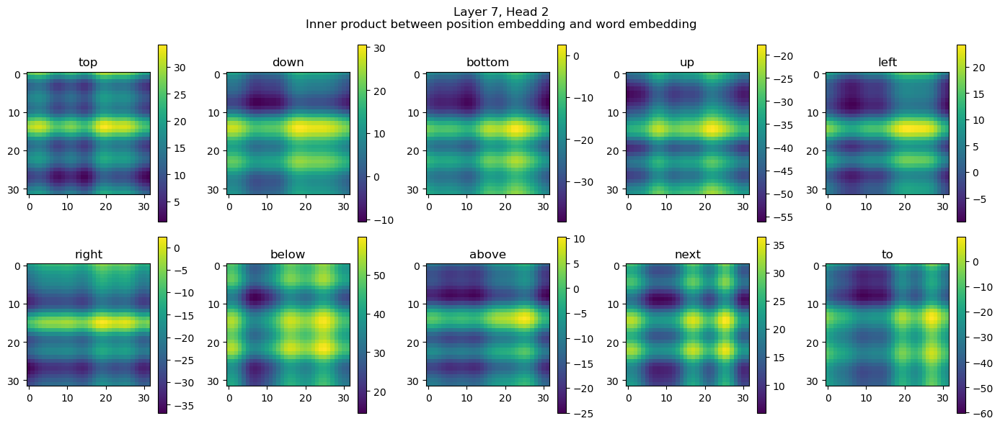

Layer 8, Head 2
Layer 9, Head 2
Layer 10, Head 2
Layer 10, Head 2 has max inner product 44.5 | Padding inner product 86.5 Examine.


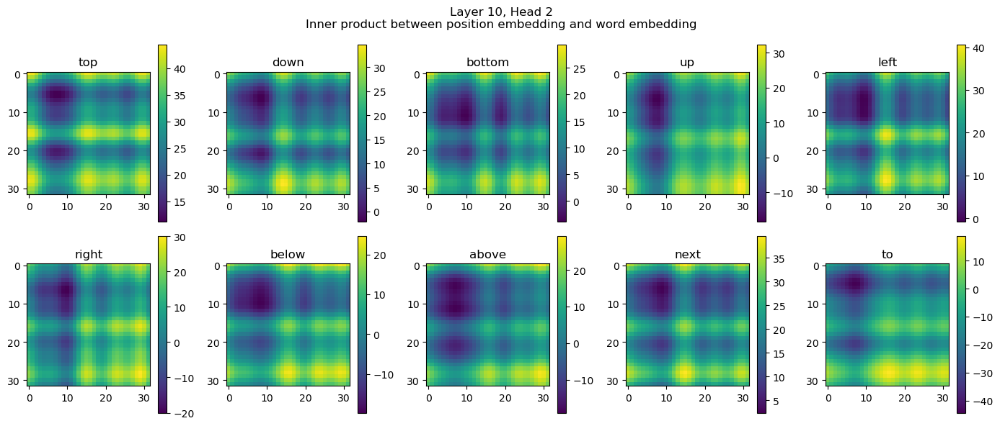

Layer 11, Head 2
Layer 12, Head 2
Layer 13, Head 2
Layer 13, Head 2 has max inner product 35.4375 | Padding inner product 34.5 Examine.


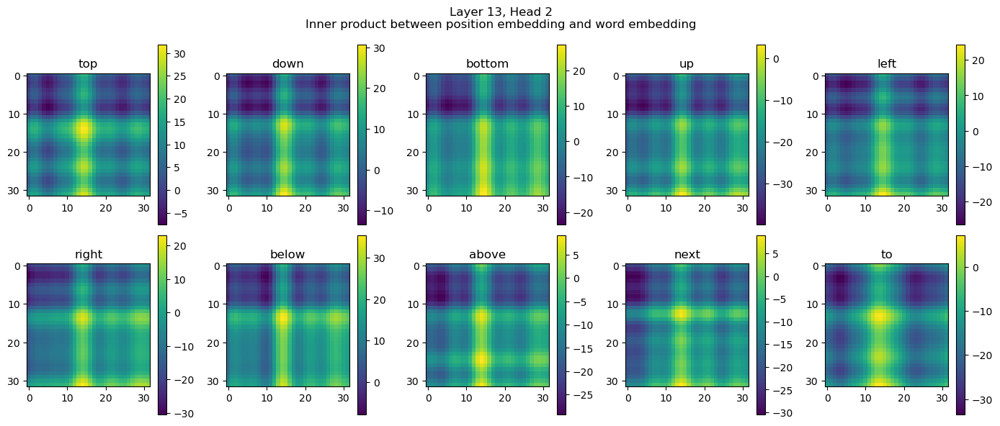

Layer 14, Head 2
Layer 14, Head 2 has max inner product 67.8125 | Padding inner product 66.625 Examine.


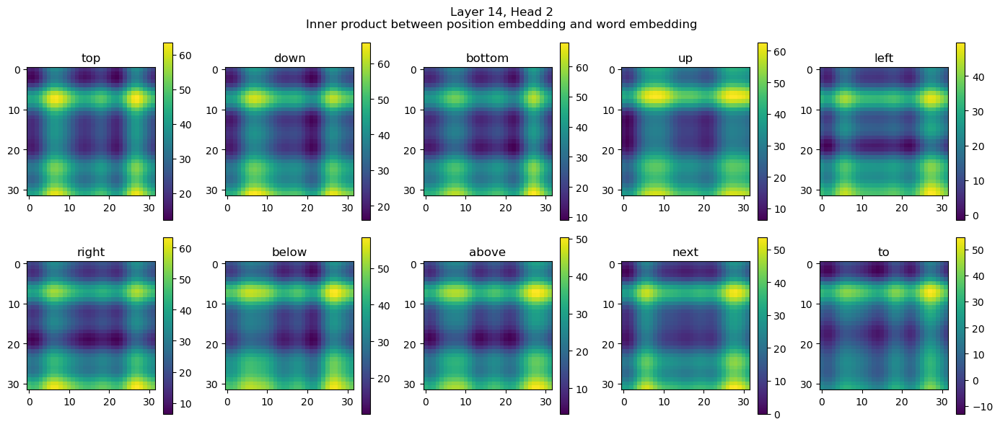

Layer 15, Head 2
Layer 15, Head 2 has max inner product 22.5625 | Padding inner product 30.71875 Examine.


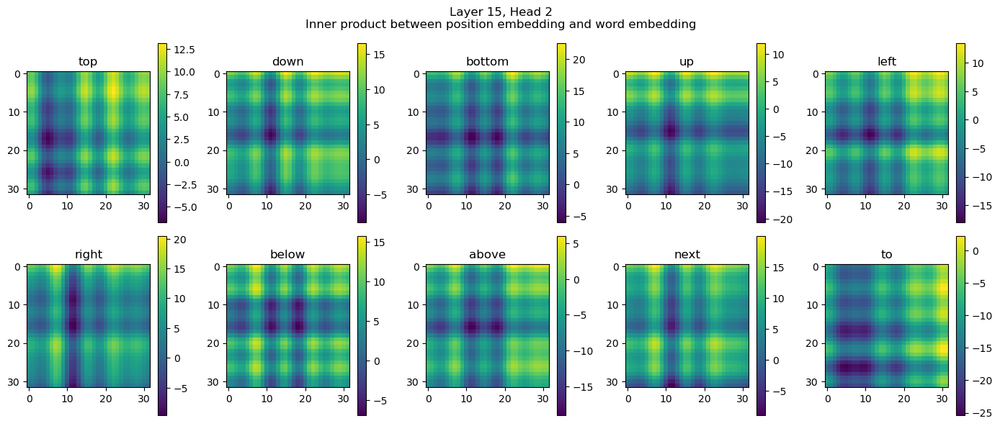

Layer 16, Head 2
Layer 17, Head 2
Layer 17, Head 2 has max inner product 1968.0 | Padding inner product 1991.0 Examine.


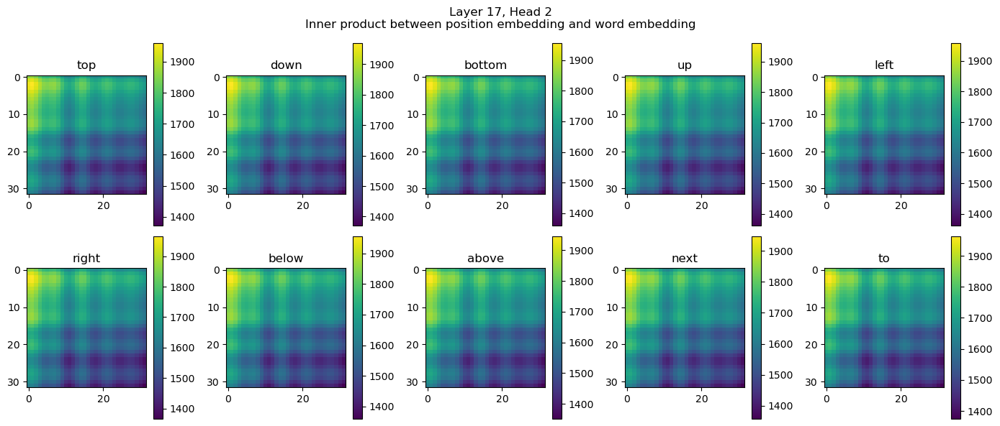

Layer 18, Head 2
Layer 18, Head 2 has max inner product 25232.0 | Padding inner product 25280.0 Examine.


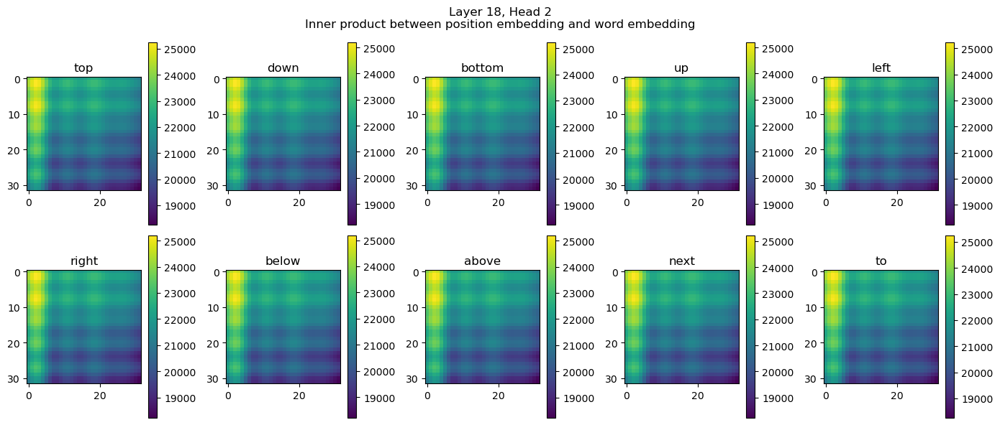

Layer 19, Head 2
Layer 20, Head 2
Layer 21, Head 2
Layer 22, Head 2
Layer 23, Head 2
Layer 23, Head 2 has max inner product 37.125 | Padding inner product 39.75 Examine.


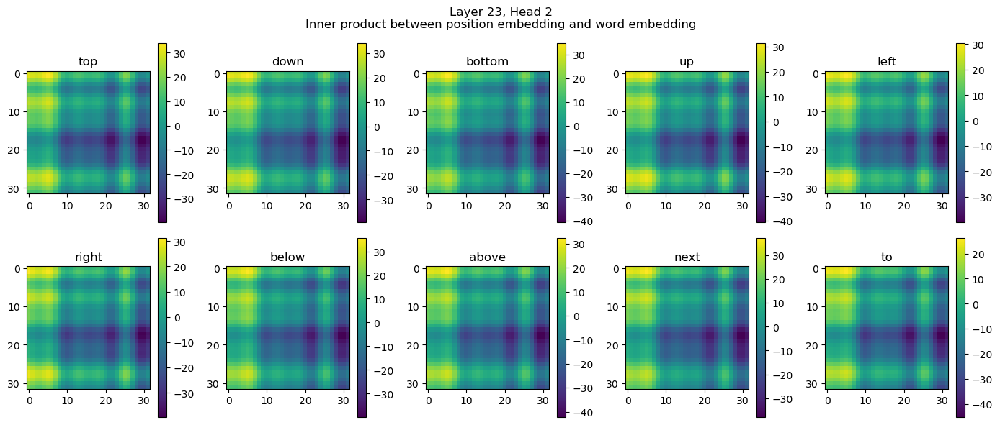

Layer 24, Head 2
Layer 24, Head 2 has max inner product 5752.0 | Padding inner product 5760.0 Examine.


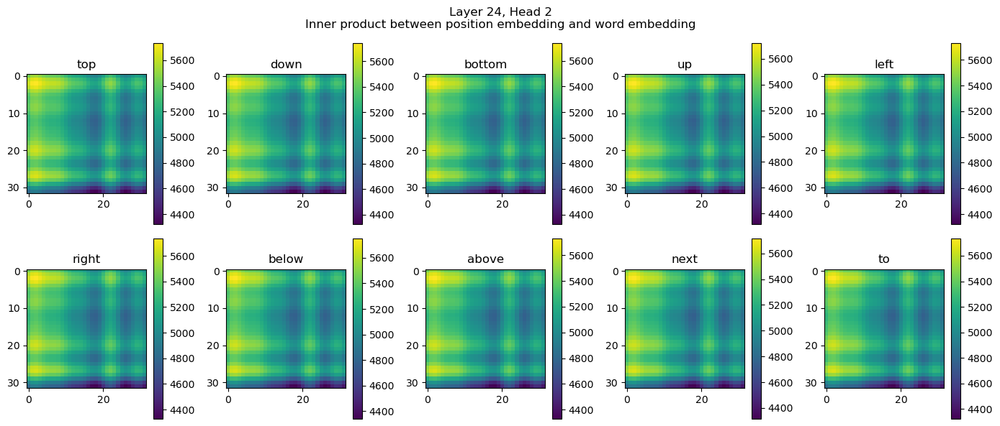

Layer 25, Head 2
Layer 26, Head 2
Layer 27, Head 2
Layer 0, Head 3
Layer 1, Head 3
Layer 2, Head 3
Layer 3, Head 3
Layer 4, Head 3
Layer 5, Head 3
Layer 6, Head 3
Layer 7, Head 3
Layer 8, Head 3
Layer 9, Head 3
Layer 9, Head 3 has max inner product 35.96875 | Padding inner product 96.375 Examine.


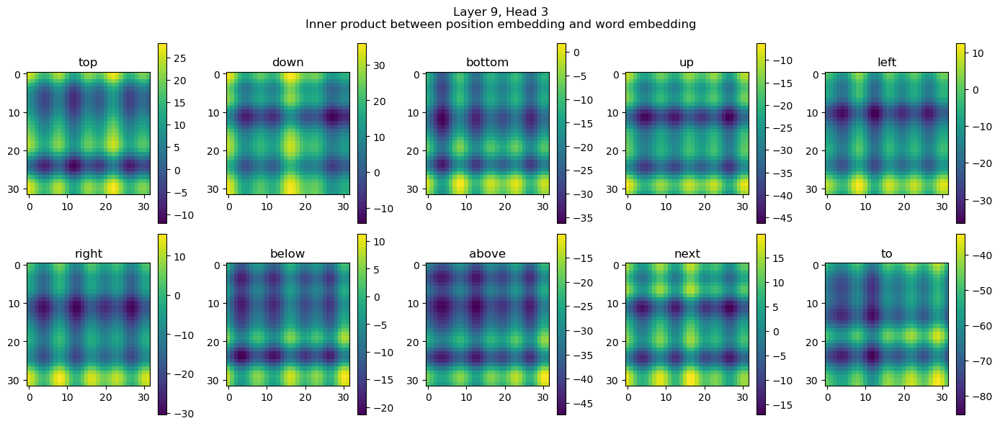

Layer 10, Head 3
Layer 11, Head 3
Layer 11, Head 3 has max inner product 79.0625 | Padding inner product 96.375 Examine.


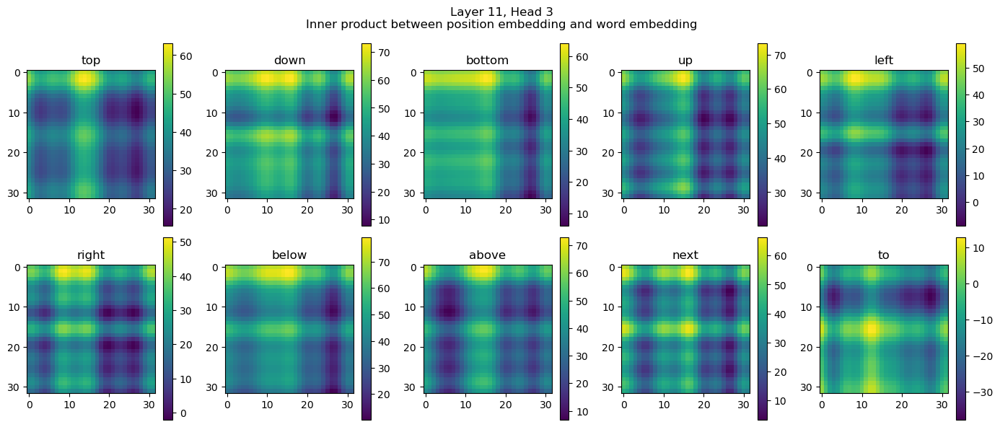

Layer 12, Head 3
Layer 12, Head 3 has max inner product 26.015625 | Padding inner product 36.9375 Examine.


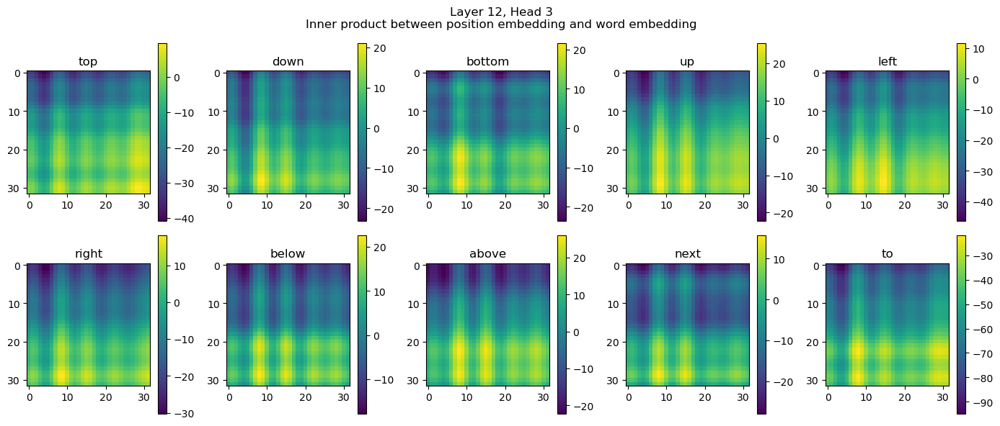

Layer 13, Head 3
Layer 14, Head 3
Layer 15, Head 3
Layer 15, Head 3 has max inner product 39.34375 | Padding inner product 45.4375 Examine.


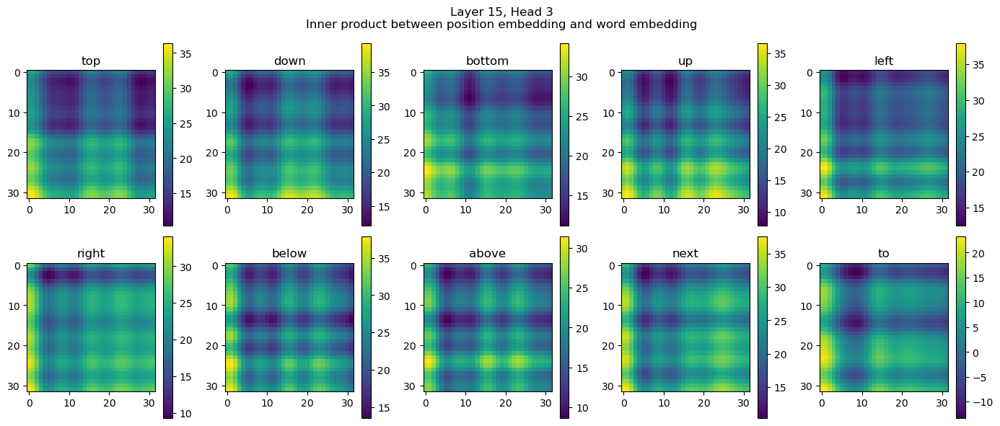

Layer 16, Head 3
Layer 16, Head 3 has max inner product 423.25 | Padding inner product 435.75 Examine.


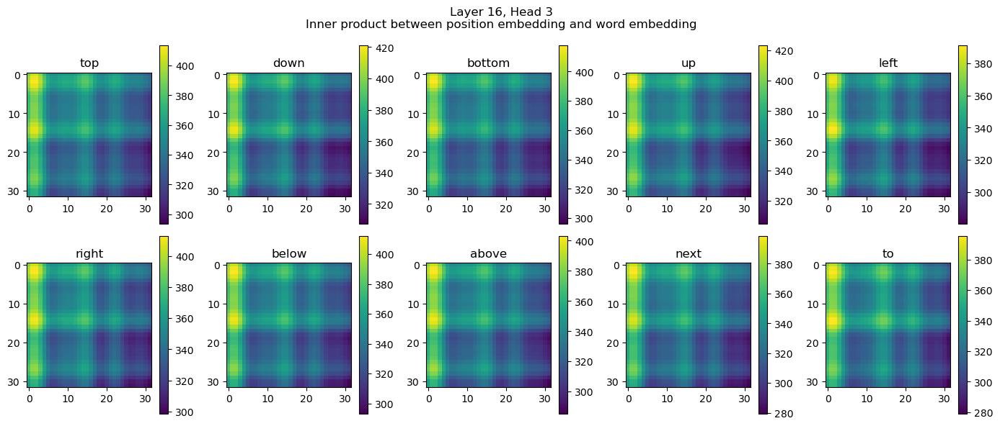

Layer 17, Head 3
Layer 18, Head 3
Layer 19, Head 3
Layer 20, Head 3
Layer 21, Head 3
Layer 21, Head 3 has max inner product 43.0 | Padding inner product 49.46875 Examine.


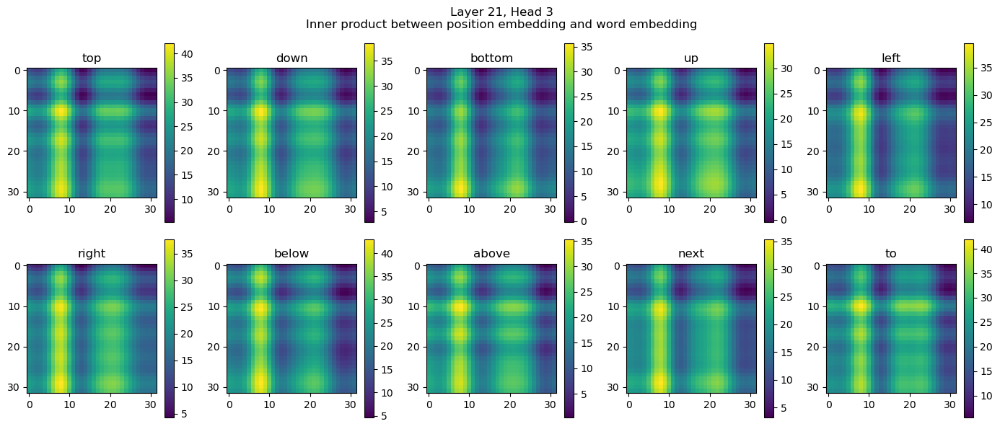

Layer 22, Head 3
Layer 22, Head 3 has max inner product 13.296875 | Padding inner product 12.625 Examine.


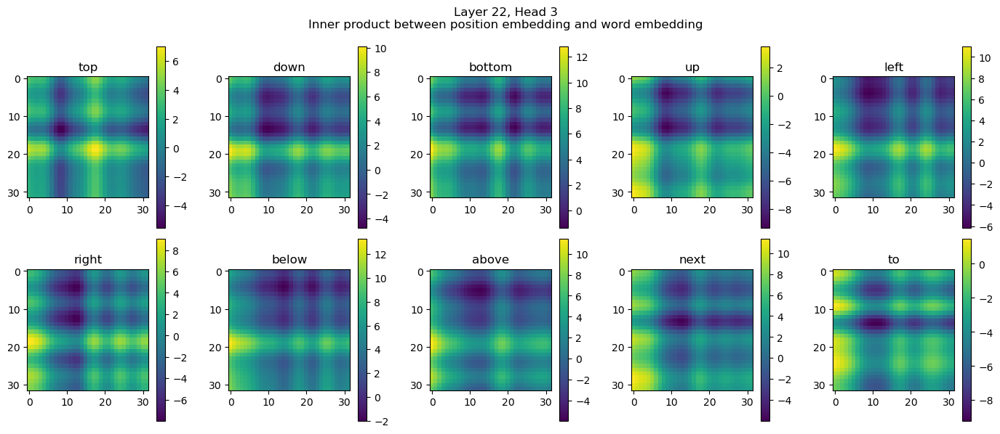

Layer 23, Head 3
Layer 24, Head 3
Layer 24, Head 3 has max inner product 65.75 | Padding inner product 55.625 Examine.


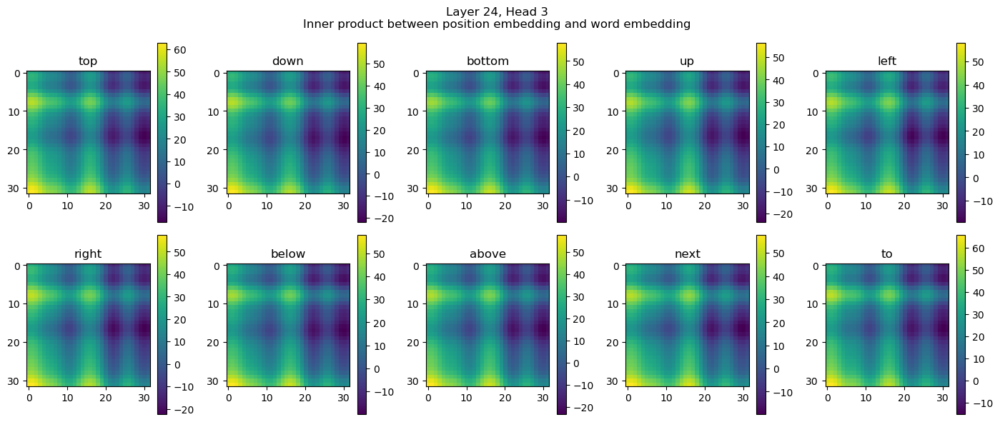

Layer 25, Head 3
Layer 26, Head 3
Layer 27, Head 3
Layer 27, Head 3 has max inner product 809.5 | Padding inner product 816.5 Examine.


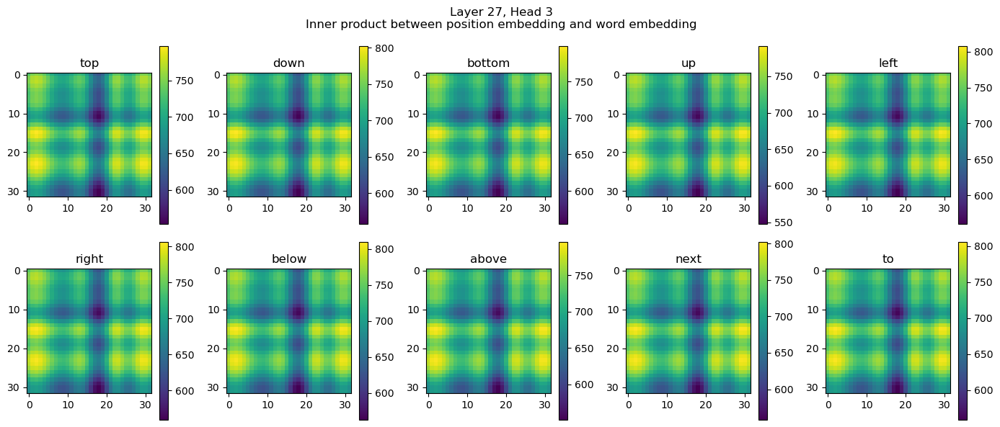

Layer 0, Head 4
Layer 1, Head 4
Layer 2, Head 4
Layer 3, Head 4
Layer 4, Head 4
Layer 5, Head 4
Layer 6, Head 4
Layer 7, Head 4
Layer 8, Head 4
Layer 8, Head 4 has max inner product 47.875 | Padding inner product 93.75 Examine.


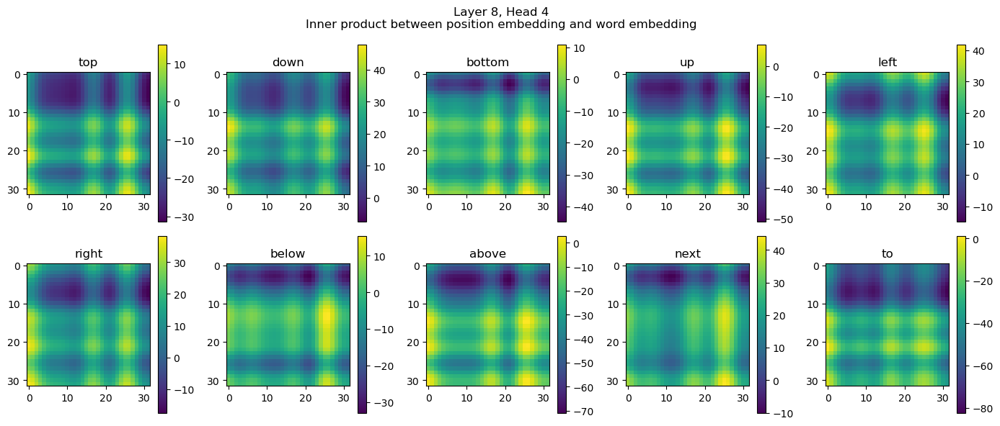

Layer 9, Head 4
Layer 10, Head 4
Layer 11, Head 4
Layer 12, Head 4
Layer 12, Head 4 has max inner product 39.9375 | Padding inner product 50.40625 Examine.


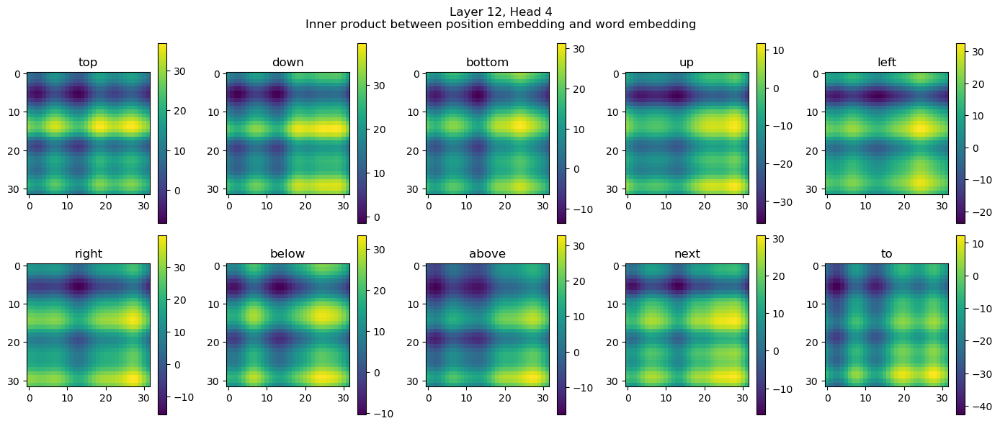

Layer 13, Head 4
Layer 14, Head 4
Layer 14, Head 4 has max inner product 34.34375 | Padding inner product 50.46875 Examine.


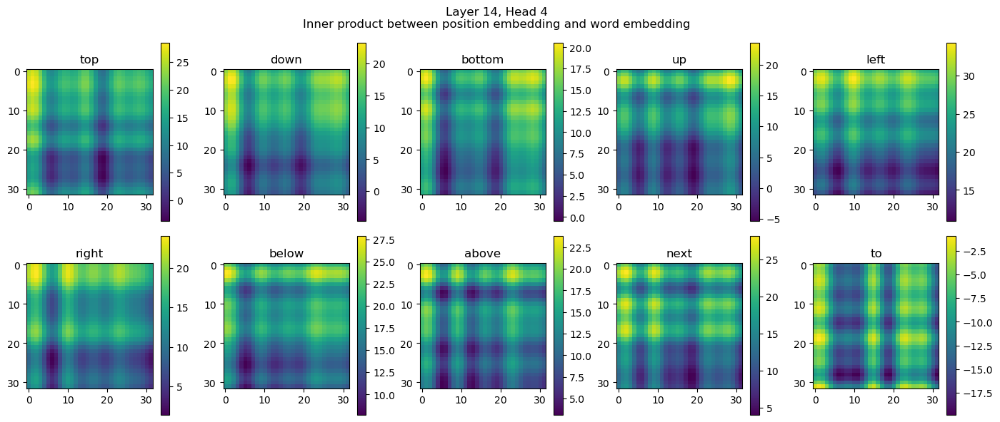

Layer 15, Head 4
Layer 15, Head 4 has max inner product 32.65625 | Padding inner product 34.5 Examine.


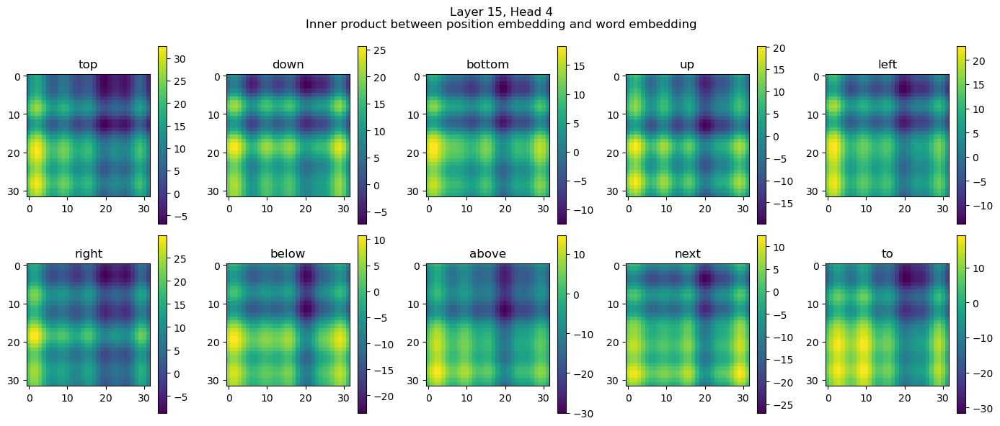

Layer 16, Head 4
Layer 17, Head 4
Layer 18, Head 4
Layer 18, Head 4 has max inner product 66.0625 | Padding inner product 61.6875 Examine.


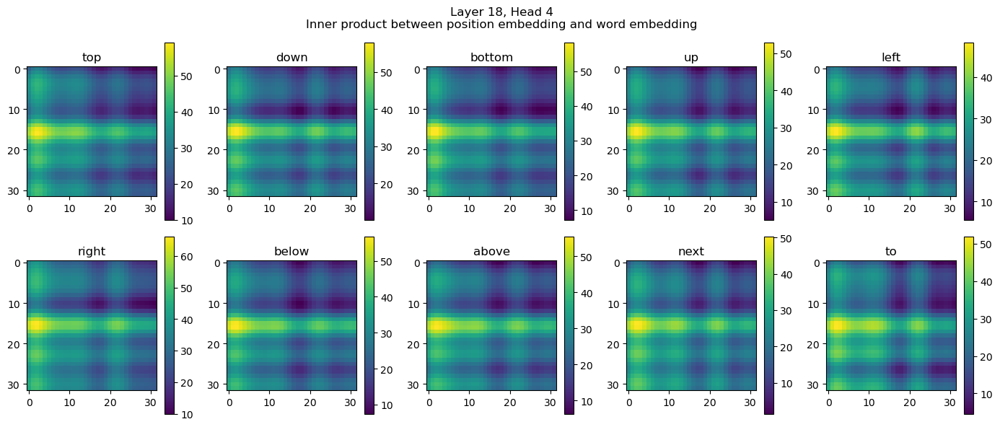

Layer 19, Head 4
Layer 19, Head 4 has max inner product 19.03125 | Padding inner product 23.03125 Examine.


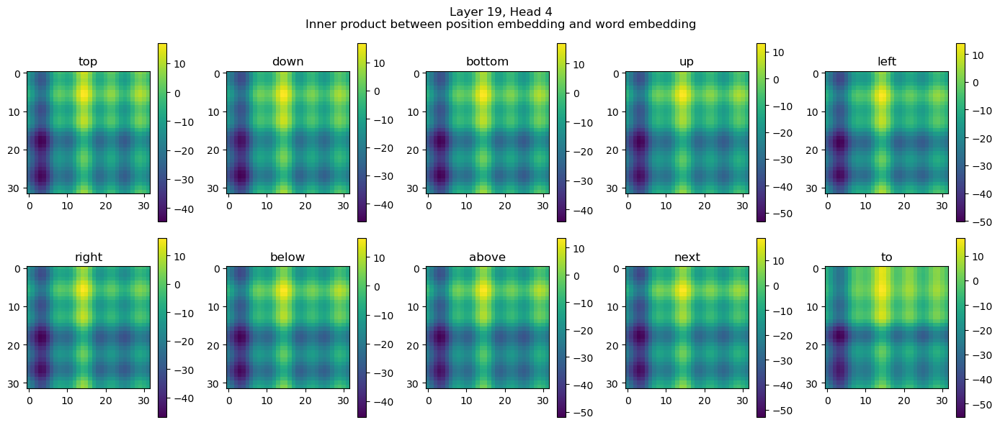

Layer 20, Head 4
Layer 21, Head 4
Layer 21, Head 4 has max inner product 6492.0 | Padding inner product 6524.0 Examine.


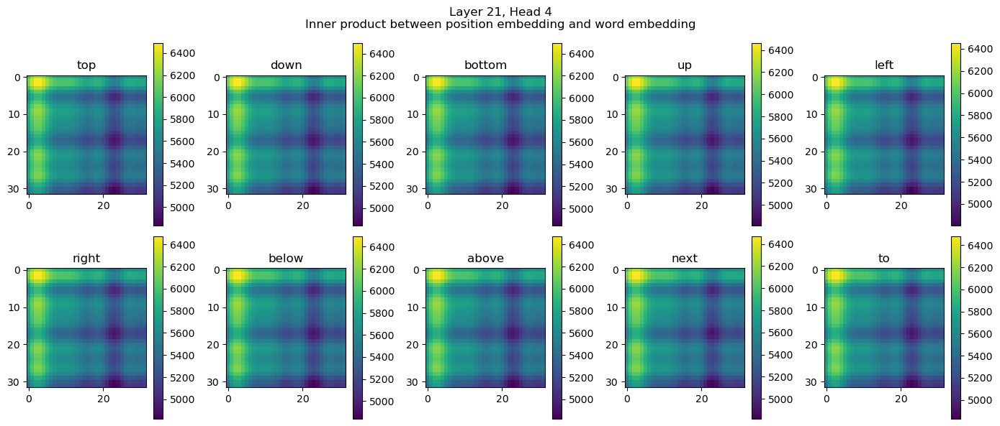

Layer 22, Head 4
Layer 23, Head 4
Layer 24, Head 4
Layer 25, Head 4
Layer 26, Head 4
Layer 27, Head 4
Layer 0, Head 5
Layer 1, Head 5
Layer 2, Head 5
Layer 3, Head 5
Layer 4, Head 5
Layer 5, Head 5
Layer 6, Head 5
Layer 7, Head 5
Layer 7, Head 5 has max inner product 72.9375 | Padding inner product 201.0 Examine.


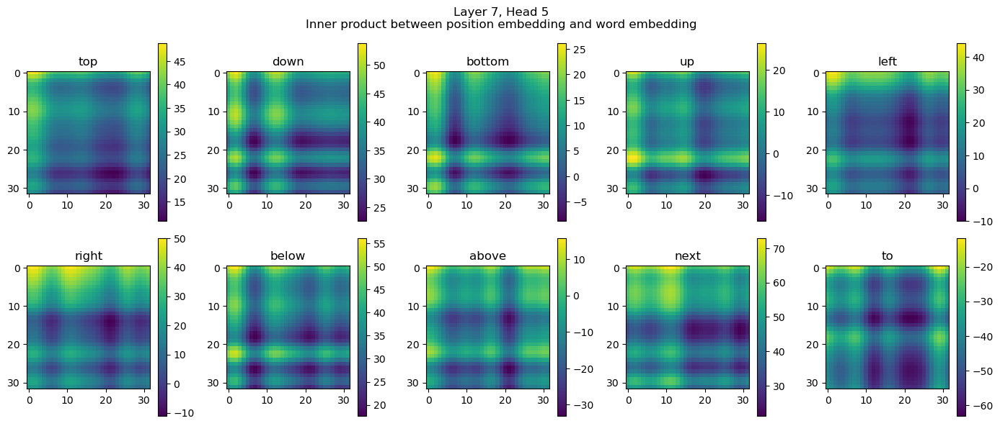

Layer 8, Head 5
Layer 9, Head 5
Layer 9, Head 5 has max inner product 38.84375 | Padding inner product 115.5625 Examine.


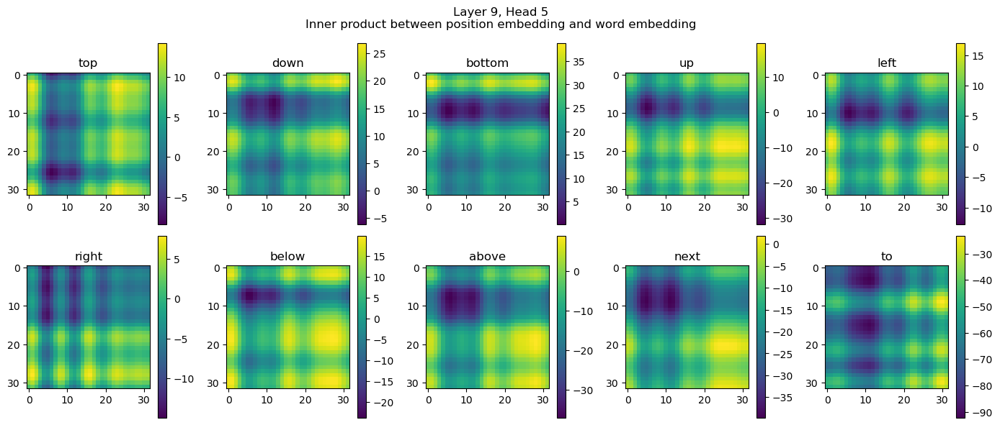

Layer 10, Head 5
Layer 10, Head 5 has max inner product 30.109375 | Padding inner product 30.5 Examine.


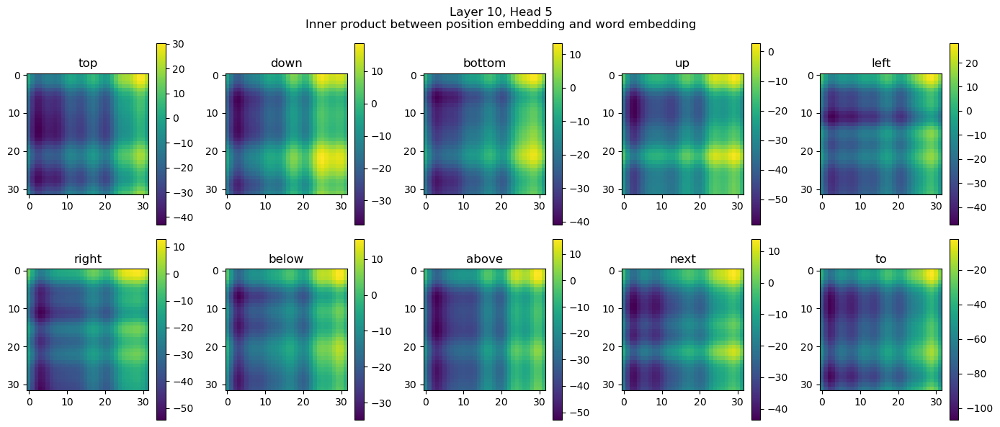

Layer 11, Head 5
Layer 11, Head 5 has max inner product 20.953125 | Padding inner product 52.71875 Examine.


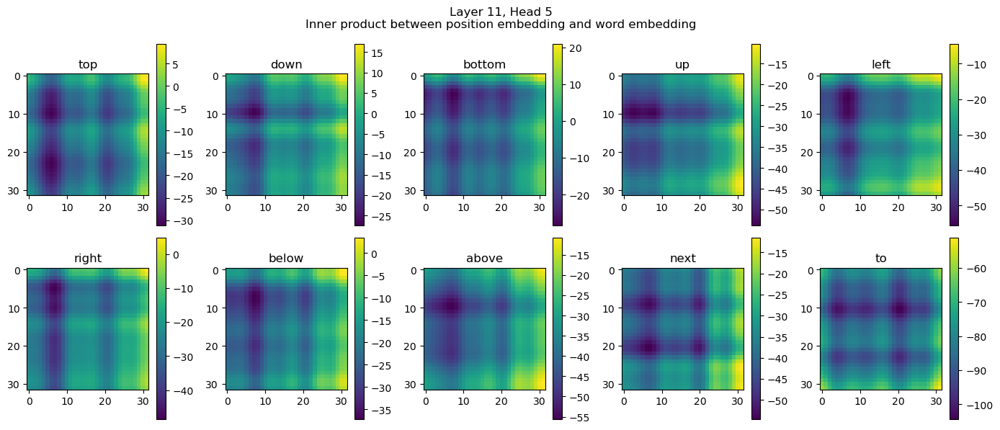

Layer 12, Head 5
Layer 12, Head 5 has max inner product 121.625 | Padding inner product 161.5 Examine.


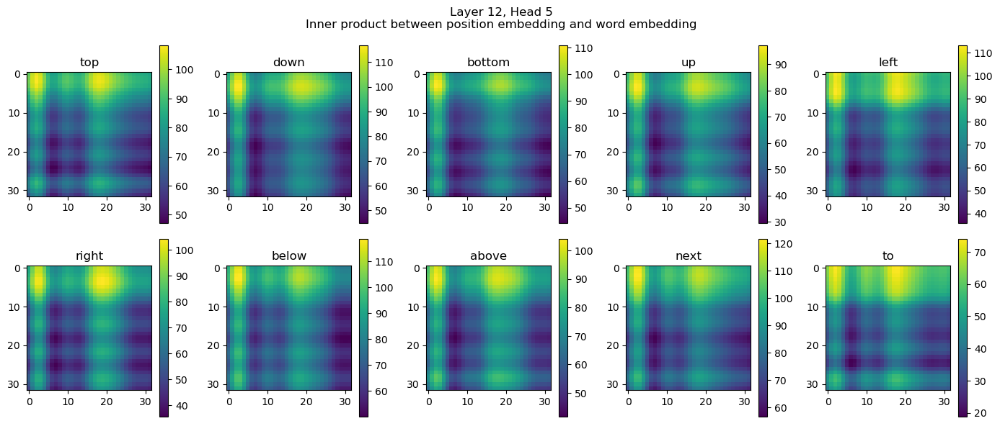

Layer 13, Head 5
Layer 13, Head 5 has max inner product 13.796875 | Padding inner product 16.703125 Examine.


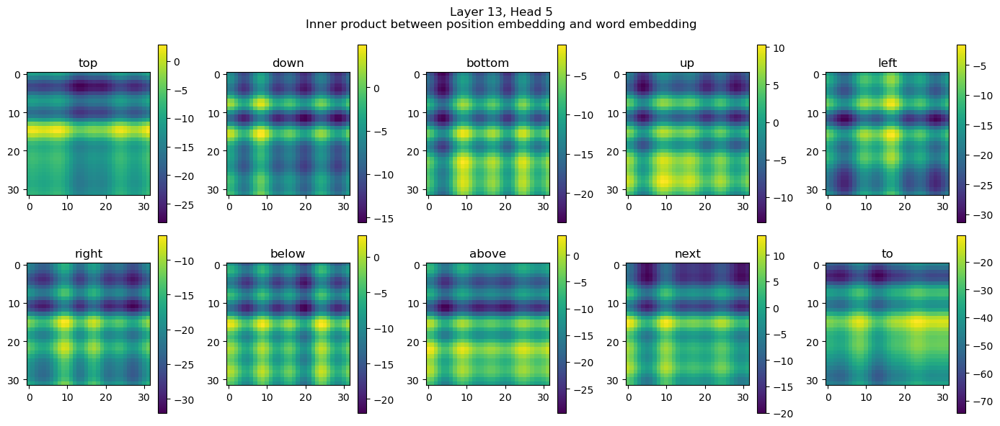

Layer 14, Head 5
Layer 15, Head 5
Layer 15, Head 5 has max inner product 34.21875 | Padding inner product 43.375 Examine.


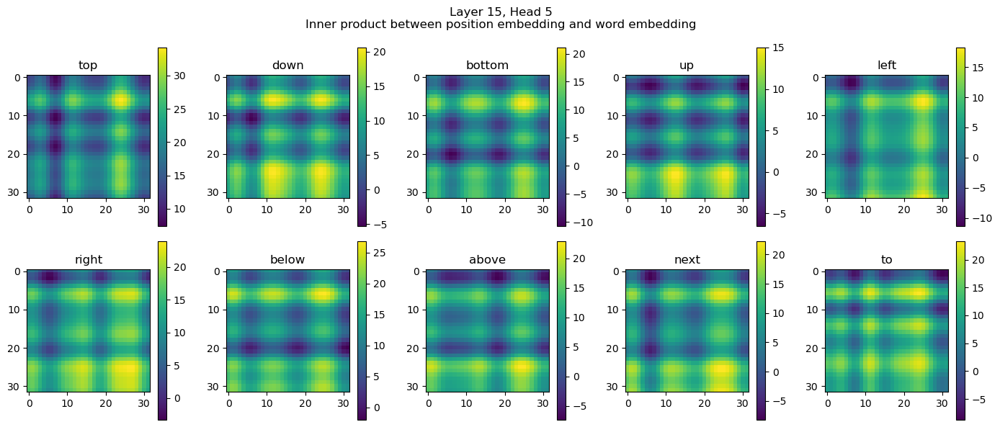

Layer 16, Head 5
Layer 17, Head 5
Layer 17, Head 5 has max inner product 121.625 | Padding inner product 124.5 Examine.


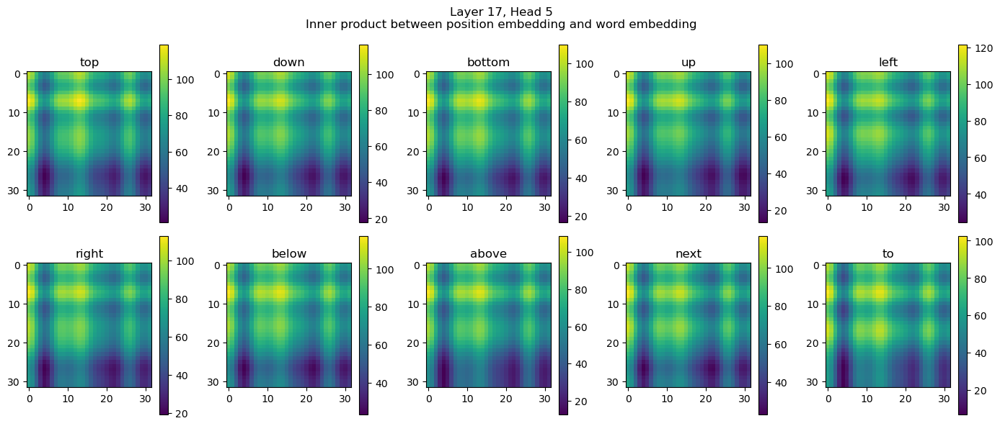

Layer 18, Head 5
Layer 19, Head 5
Layer 20, Head 5
Layer 20, Head 5 has max inner product 657.0 | Padding inner product 673.0 Examine.


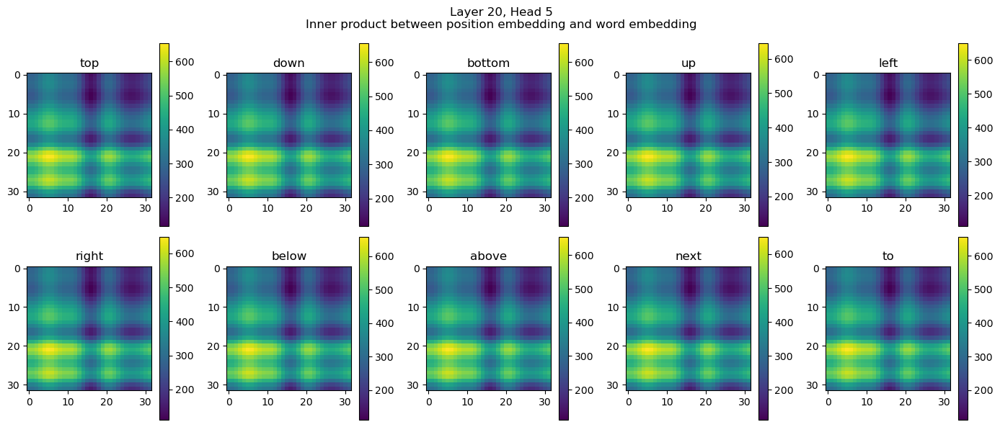

Layer 21, Head 5
Layer 22, Head 5
Layer 23, Head 5
Layer 24, Head 5
Layer 25, Head 5
Layer 25, Head 5 has max inner product 72.0 | Padding inner product 129.625 Examine.


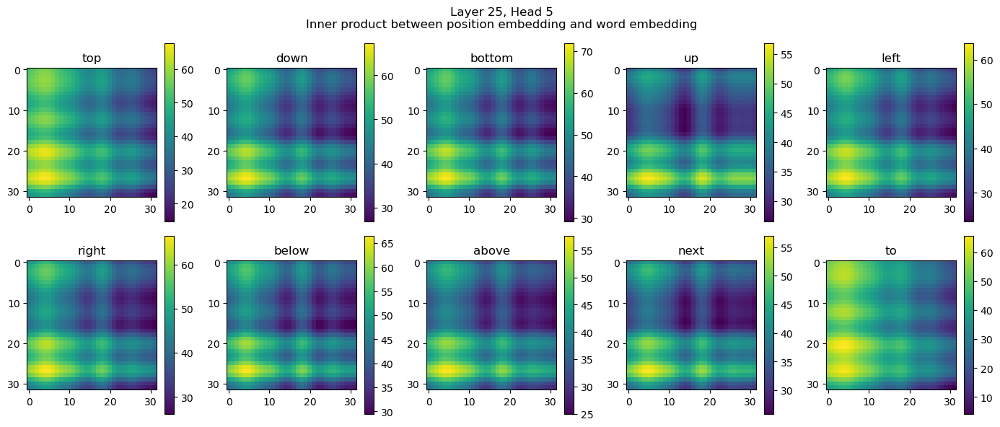

Layer 26, Head 5
Layer 27, Head 5
Layer 27, Head 5 has max inner product 1359.0 | Padding inner product 1374.0 Examine.


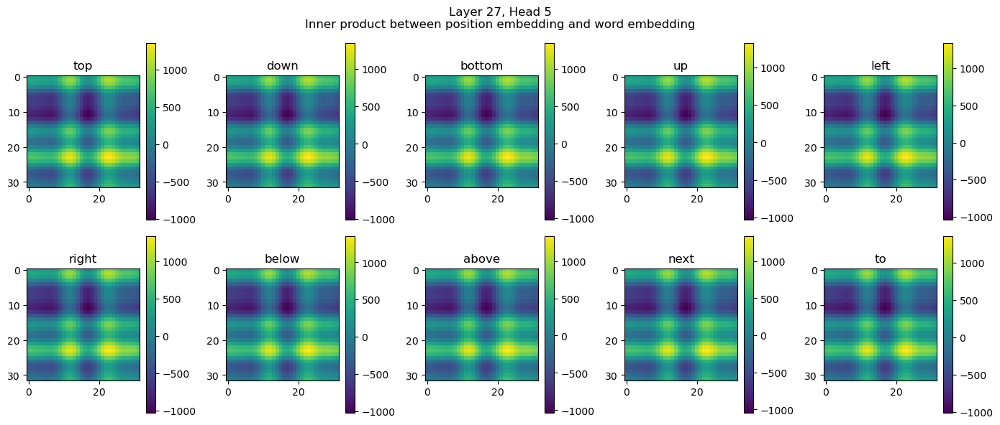

Layer 0, Head 6
Layer 1, Head 6
Layer 2, Head 6
Layer 3, Head 6
Layer 4, Head 6
Layer 5, Head 6
Layer 6, Head 6
Layer 7, Head 6
Layer 8, Head 6
Layer 9, Head 6
Layer 10, Head 6
Layer 11, Head 6
Layer 11, Head 6 has max inner product 145.875 | Padding inner product 181.125 Examine.


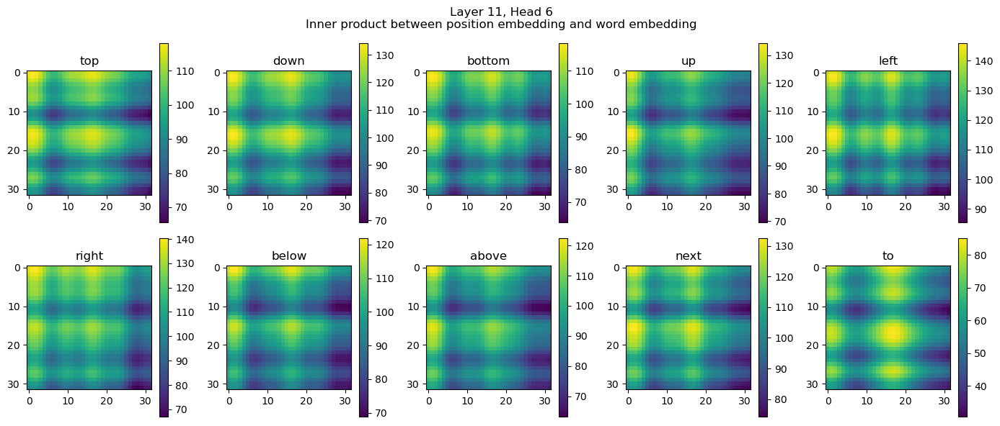

Layer 12, Head 6
Layer 13, Head 6
Layer 13, Head 6 has max inner product 55.28125 | Padding inner product 76.9375 Examine.


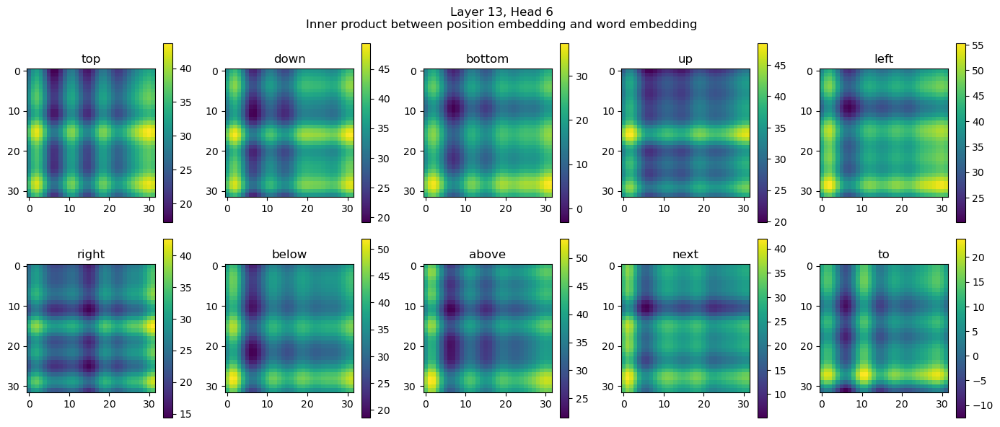

Layer 14, Head 6
Layer 15, Head 6
Layer 16, Head 6
Layer 16, Head 6 has max inner product 20.375 | Padding inner product 15.671875 Examine.


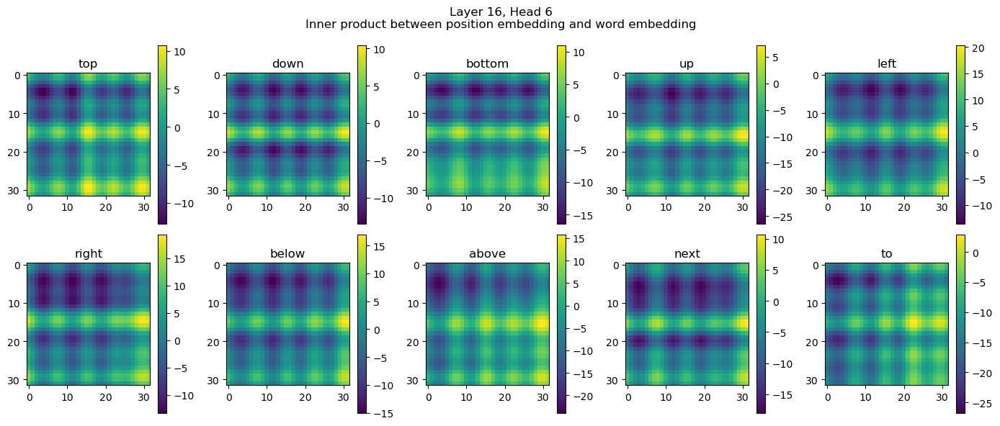

Layer 17, Head 6
Layer 18, Head 6
Layer 18, Head 6 has max inner product 163.375 | Padding inner product 180.125 Examine.


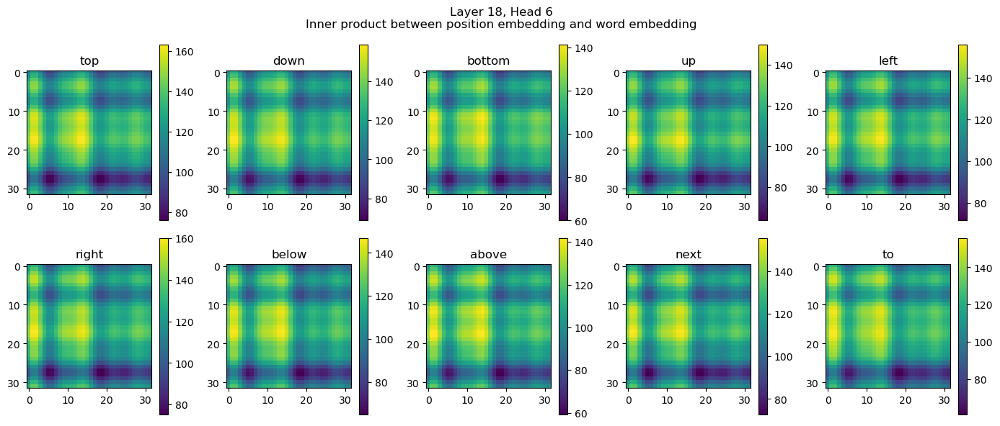

Layer 19, Head 6
Layer 20, Head 6
Layer 20, Head 6 has max inner product 1342.0 | Padding inner product 1350.0 Examine.


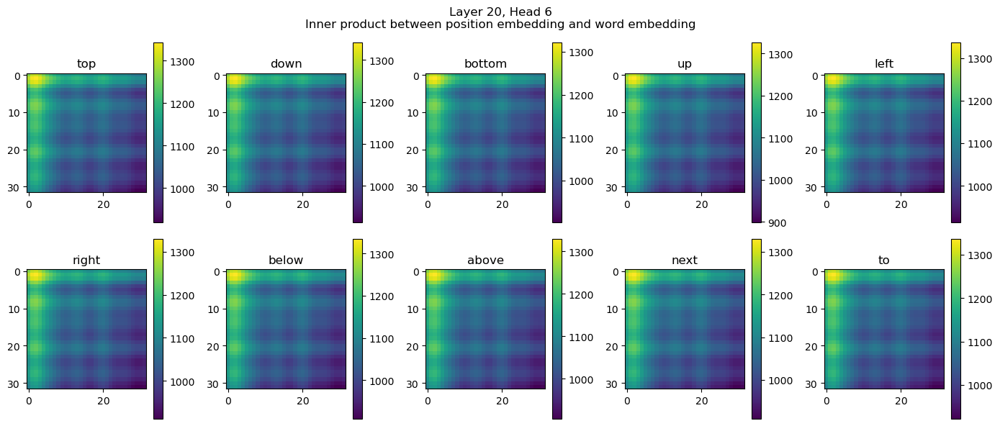

Layer 21, Head 6
Layer 21, Head 6 has max inner product 10.1640625 | Padding inner product 14.734375 Examine.


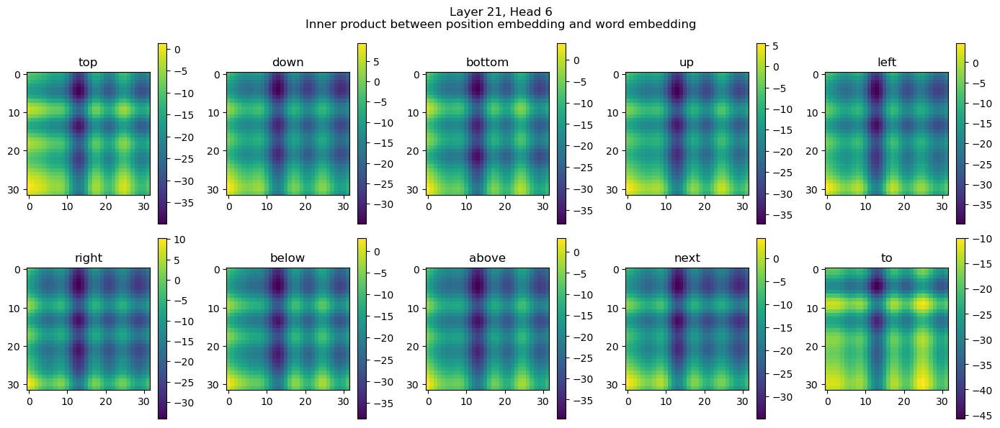

Layer 22, Head 6
Layer 22, Head 6 has max inner product 20.796875 | Padding inner product 23.890625 Examine.


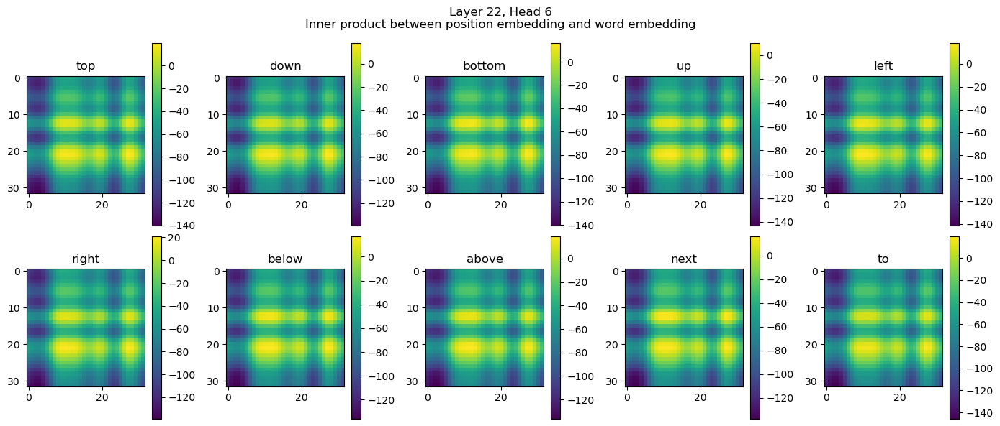

Layer 23, Head 6
Layer 24, Head 6
Layer 24, Head 6 has max inner product 623.0 | Padding inner product 628.5 Examine.


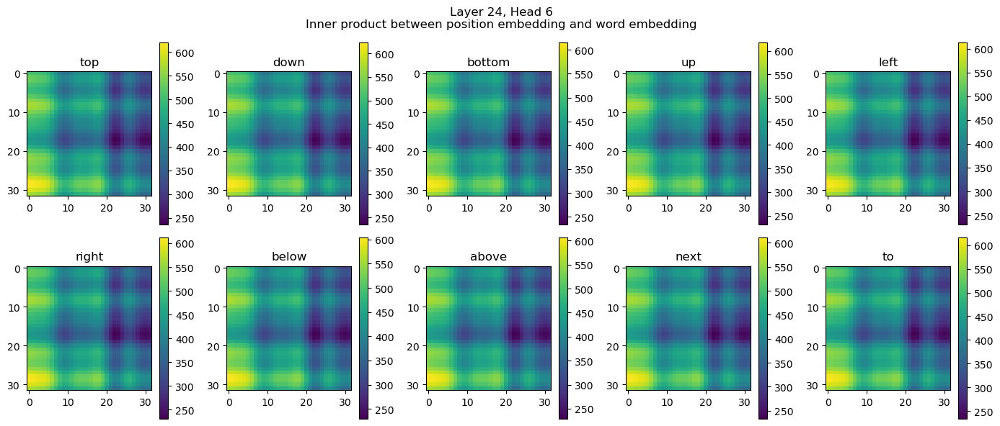

Layer 25, Head 6
Layer 25, Head 6 has max inner product 1163.0 | Padding inner product 1196.0 Examine.


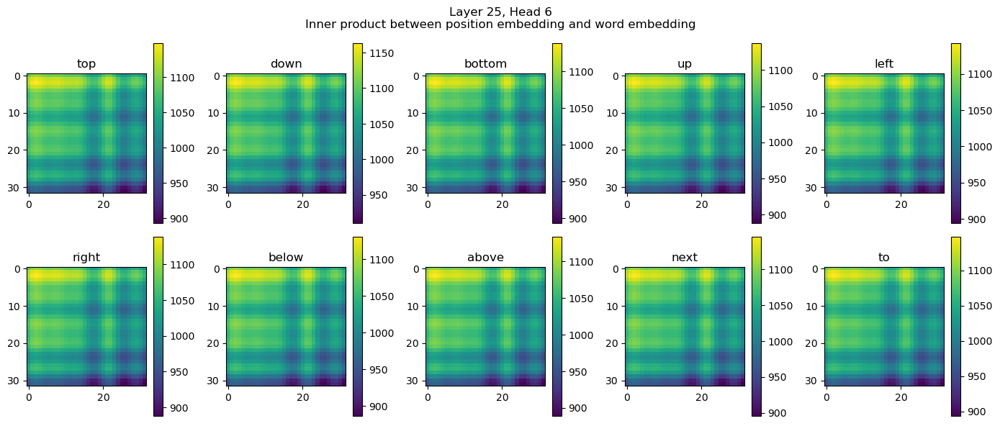

Layer 26, Head 6
Layer 27, Head 6
Layer 27, Head 6 has max inner product 317.5 | Padding inner product 332.75 Examine.


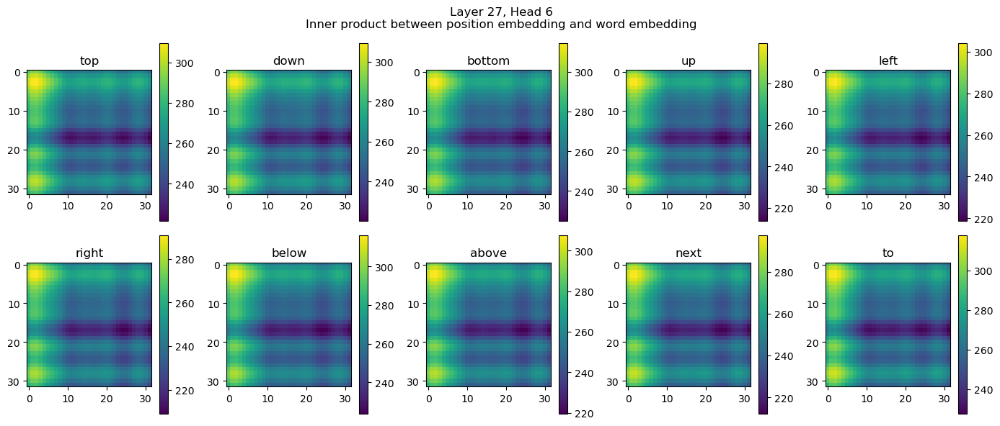

Layer 0, Head 7
Layer 1, Head 7
Layer 2, Head 7
Layer 2, Head 7 has max inner product 54.65625 | Padding inner product 127.4375 Examine.


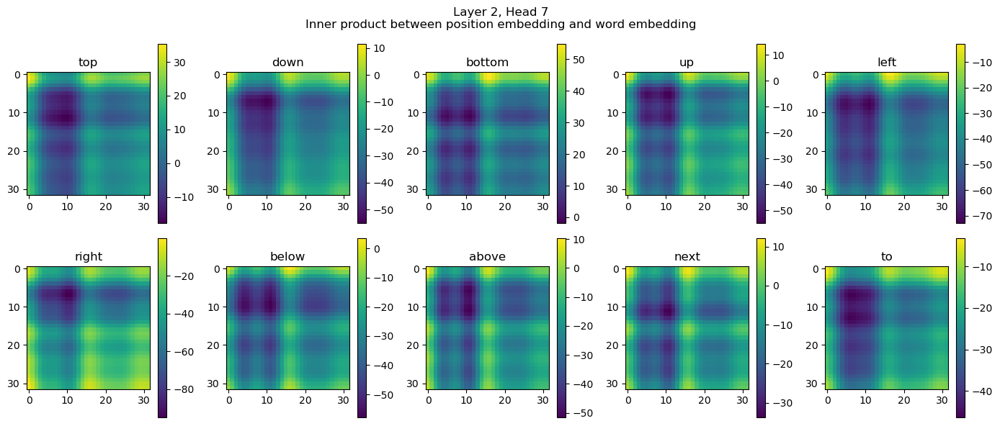

Layer 3, Head 7
Layer 4, Head 7
Layer 5, Head 7
Layer 6, Head 7
Layer 7, Head 7
Layer 8, Head 7
Layer 9, Head 7
Layer 10, Head 7
Layer 11, Head 7
Layer 11, Head 7 has max inner product 19.21875 | Padding inner product 20.90625 Examine.


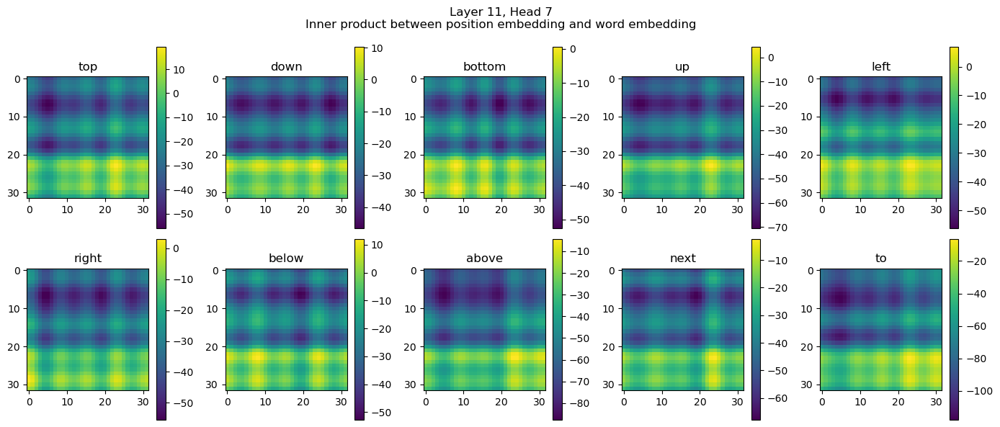

Layer 12, Head 7
Layer 12, Head 7 has max inner product 35.21875 | Padding inner product 25.578125 Examine.


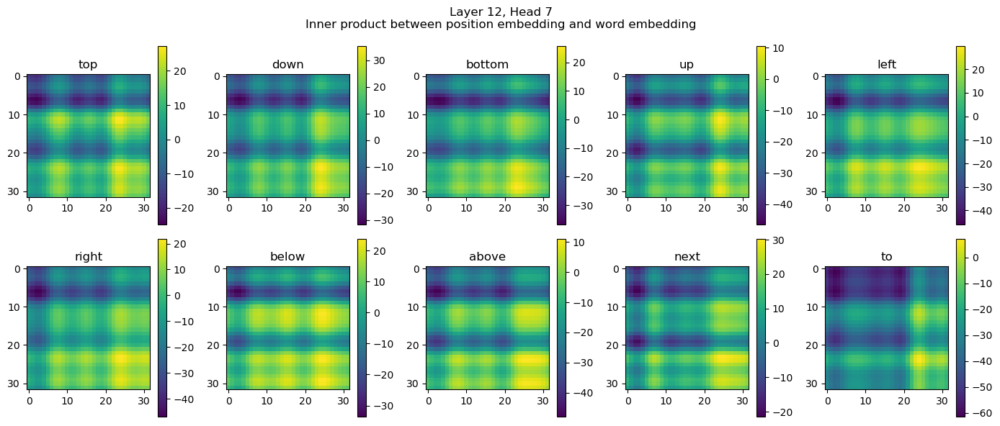

Layer 13, Head 7
Layer 13, Head 7 has max inner product 33.3125 | Padding inner product 26.578125 Examine.


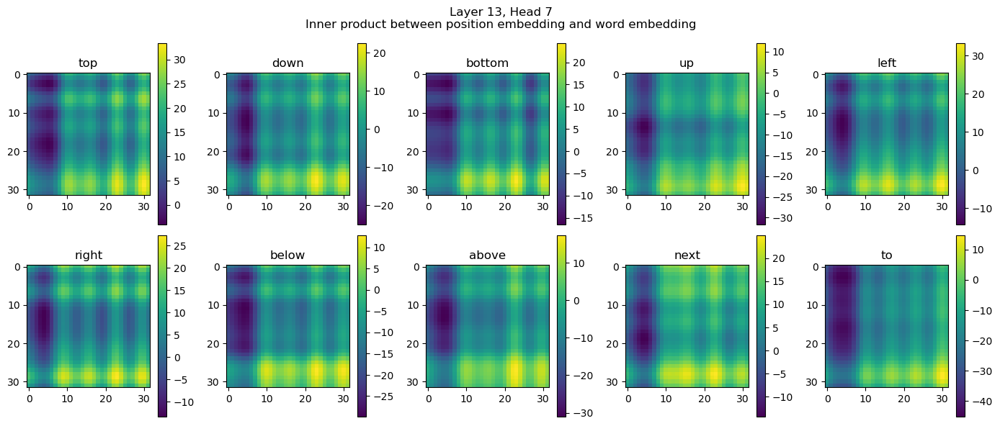

Layer 14, Head 7
Layer 15, Head 7
Layer 16, Head 7
Layer 17, Head 7
Layer 18, Head 7
Layer 19, Head 7
Layer 19, Head 7 has max inner product 311.0 | Padding inner product 313.25 Examine.


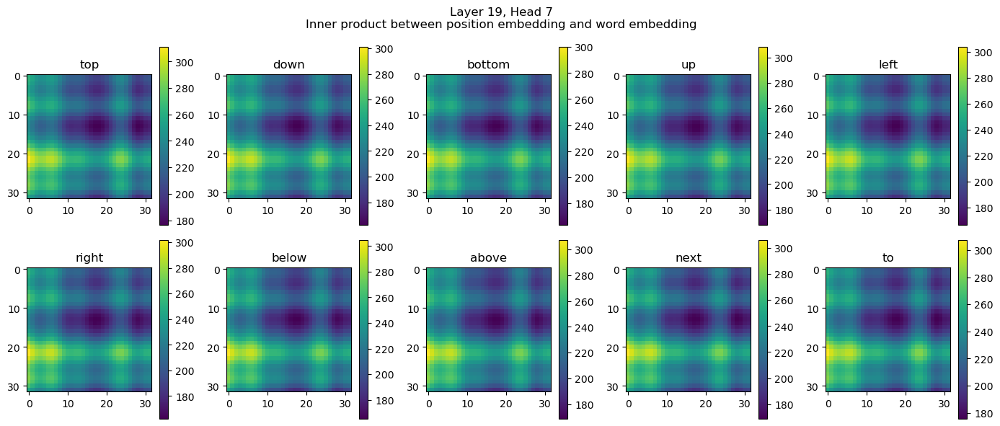

Layer 20, Head 7
Layer 20, Head 7 has max inner product 64.9375 | Padding inner product 64.0 Examine.


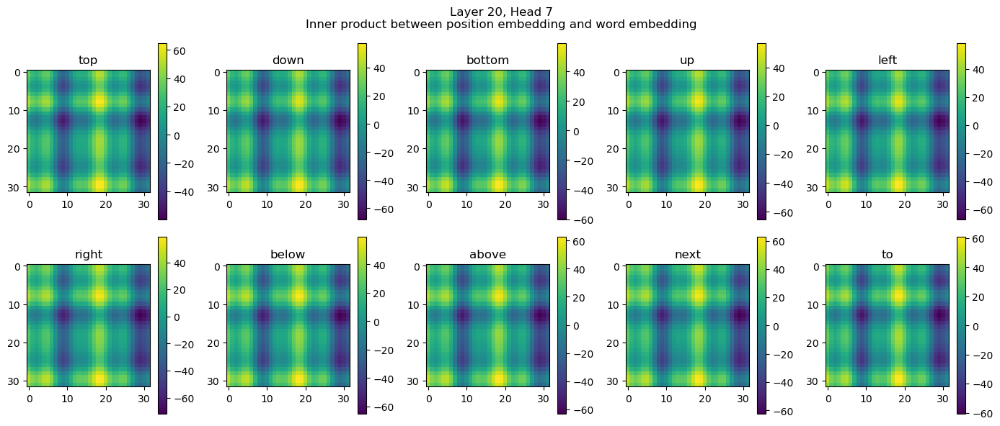

Layer 21, Head 7
Layer 22, Head 7
Layer 22, Head 7 has max inner product 77.875 | Padding inner product 83.125 Examine.


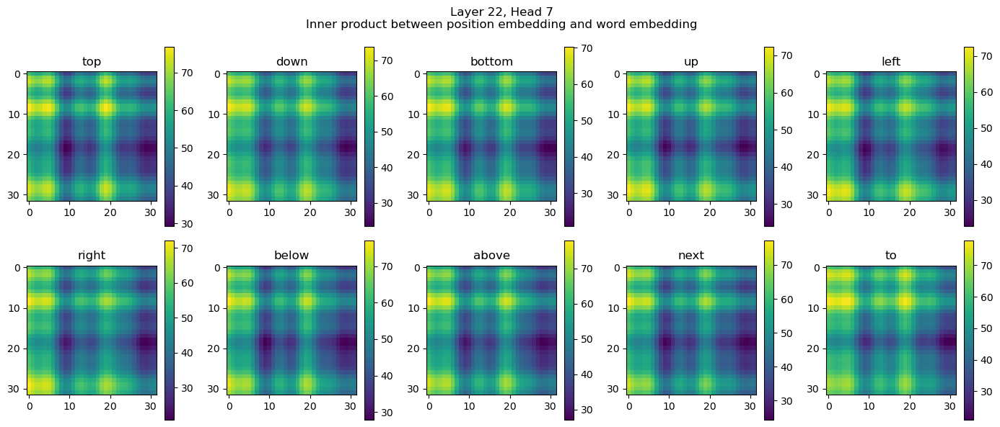

Layer 23, Head 7
Layer 23, Head 7 has max inner product 10936.0 | Padding inner product 10976.0 Examine.


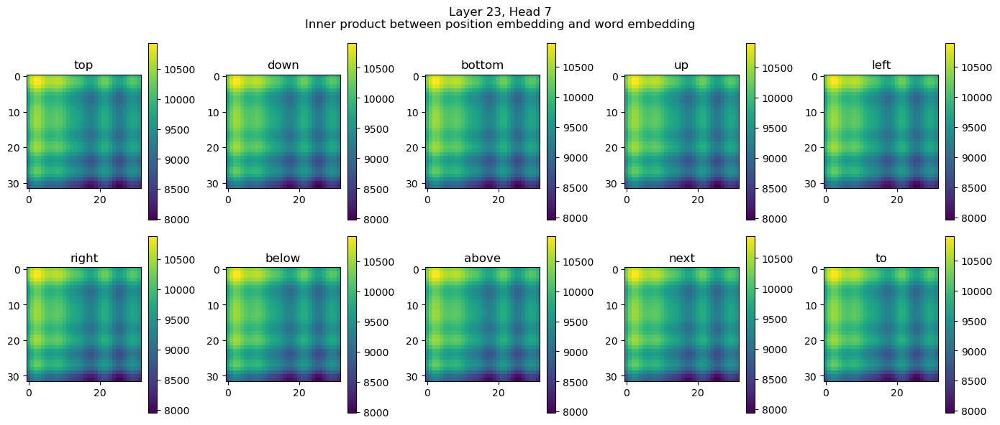

Layer 24, Head 7
Layer 24, Head 7 has max inner product 3522.0 | Padding inner product 3538.0 Examine.


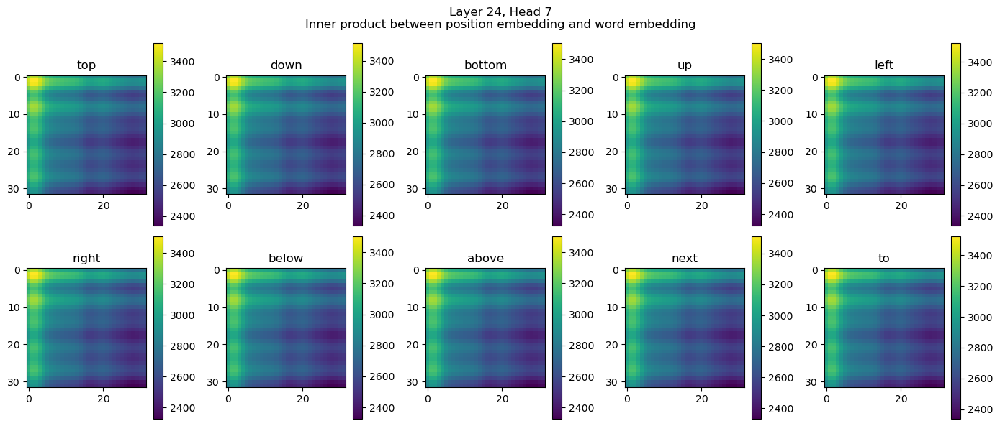

Layer 25, Head 7
Layer 25, Head 7 has max inner product 1370.0 | Padding inner product 1382.0 Examine.


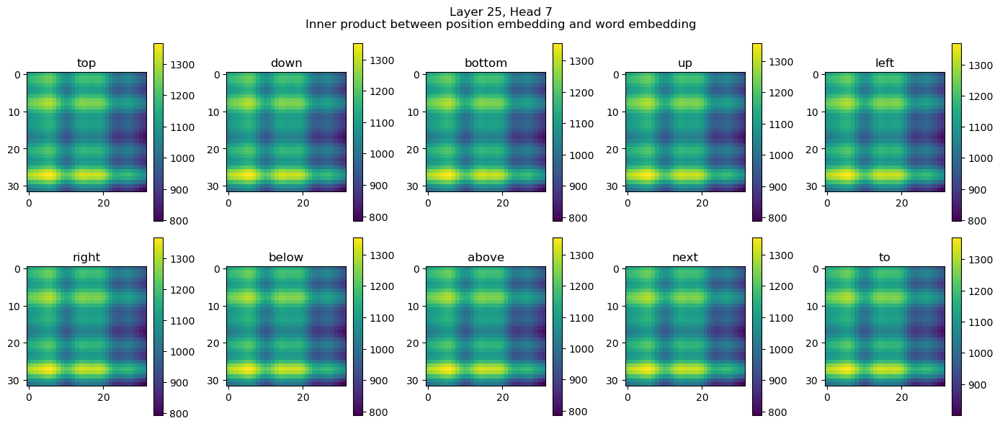

Layer 26, Head 7
Layer 27, Head 7
Layer 0, Head 8
Layer 1, Head 8
Layer 2, Head 8
Layer 3, Head 8
Layer 3, Head 8 has max inner product 21.390625 | Padding inner product 123.5625 Examine.


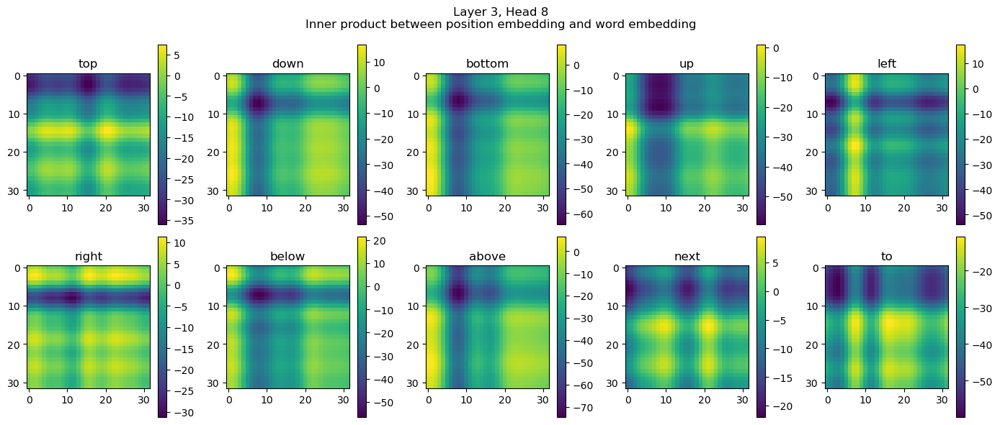

Layer 4, Head 8
Layer 5, Head 8
Layer 6, Head 8
Layer 7, Head 8
Layer 8, Head 8
Layer 9, Head 8
Layer 9, Head 8 has max inner product 21.46875 | Padding inner product 61.15625 Examine.


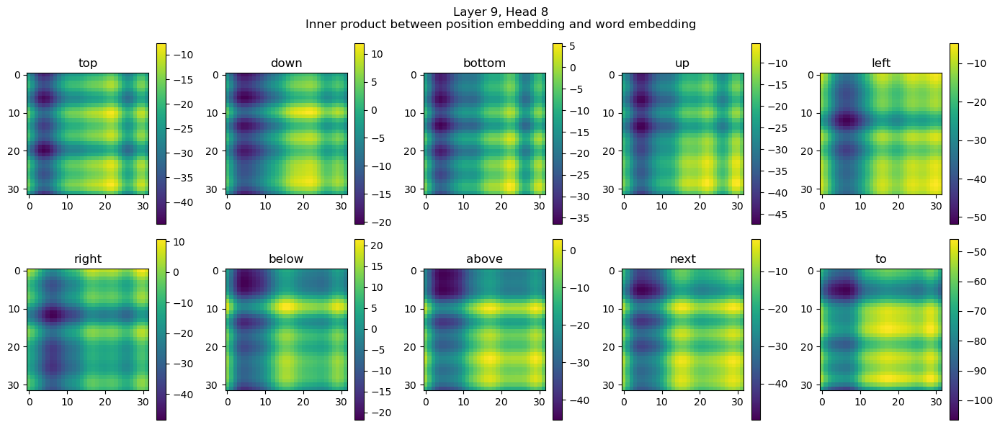

Layer 10, Head 8
Layer 11, Head 8
Layer 12, Head 8
Layer 12, Head 8 has max inner product 18.734375 | Padding inner product 11.328125 Examine.


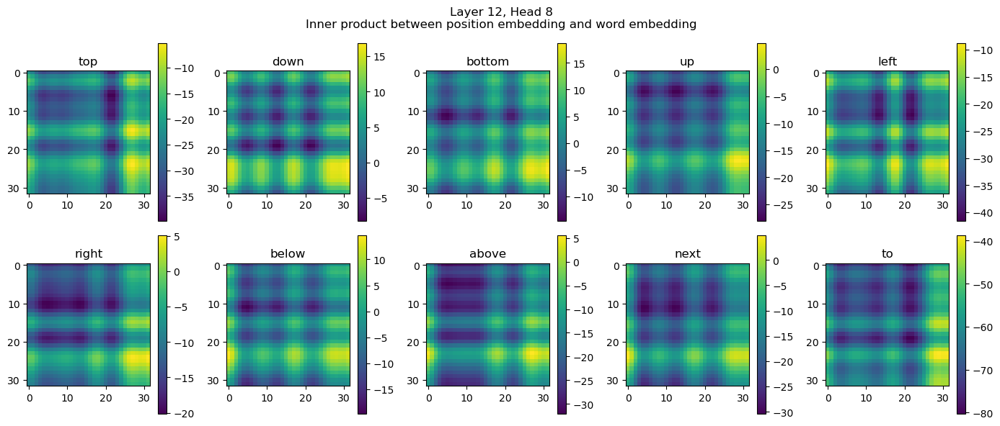

Layer 13, Head 8
Layer 13, Head 8 has max inner product 24.953125 | Padding inner product 20.015625 Examine.


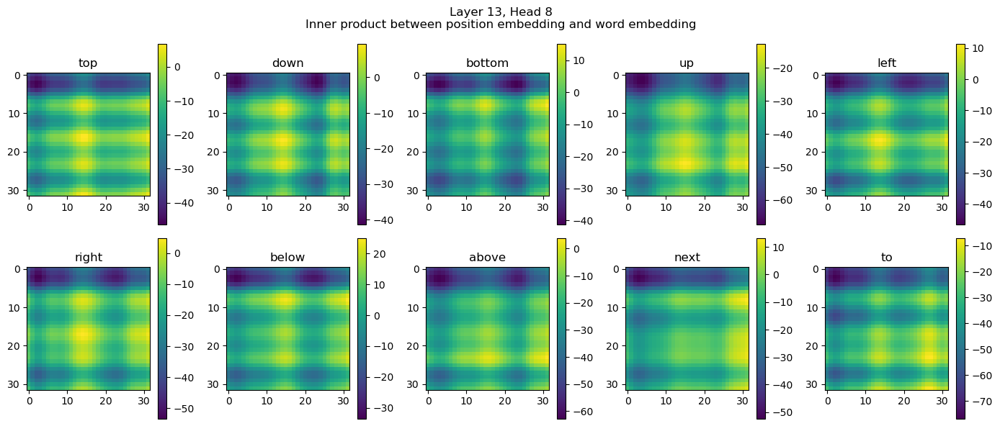

Layer 14, Head 8
Layer 15, Head 8
Layer 15, Head 8 has max inner product 33.09375 | Padding inner product 32.28125 Examine.


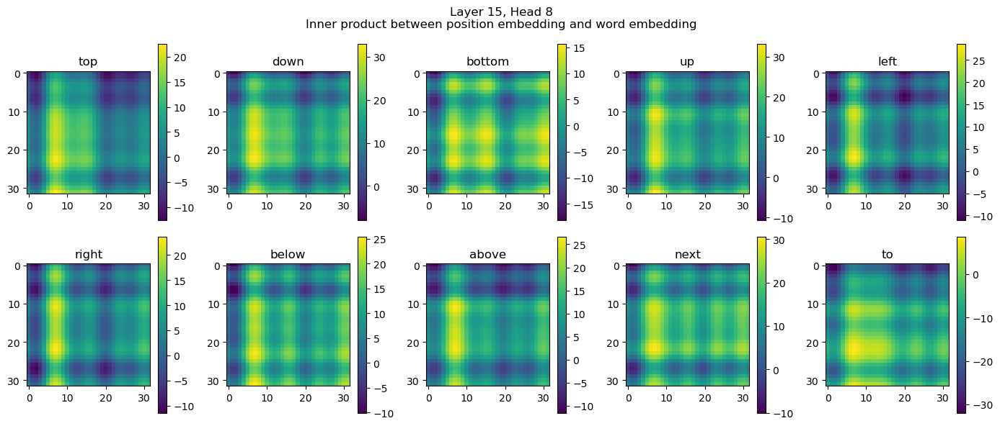

Layer 16, Head 8
Layer 16, Head 8 has max inner product 135.25 | Padding inner product 135.375 Examine.


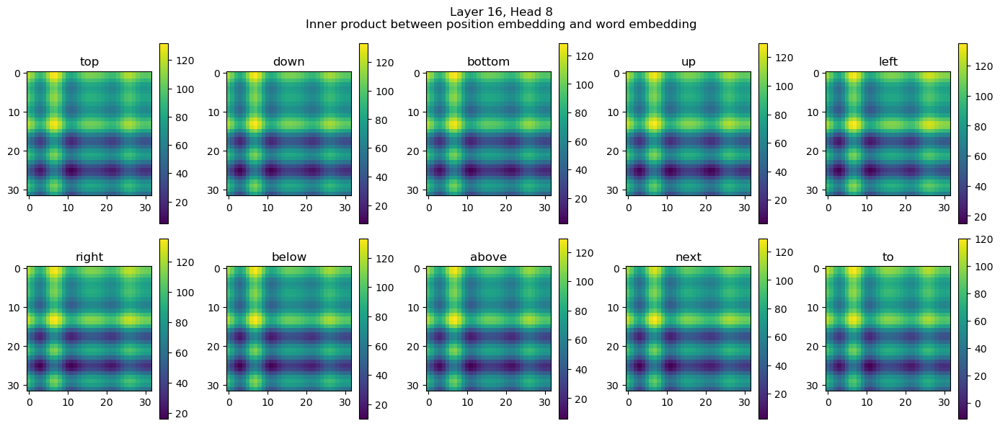

Layer 17, Head 8
Layer 17, Head 8 has max inner product 123.25 | Padding inner product 115.6875 Examine.


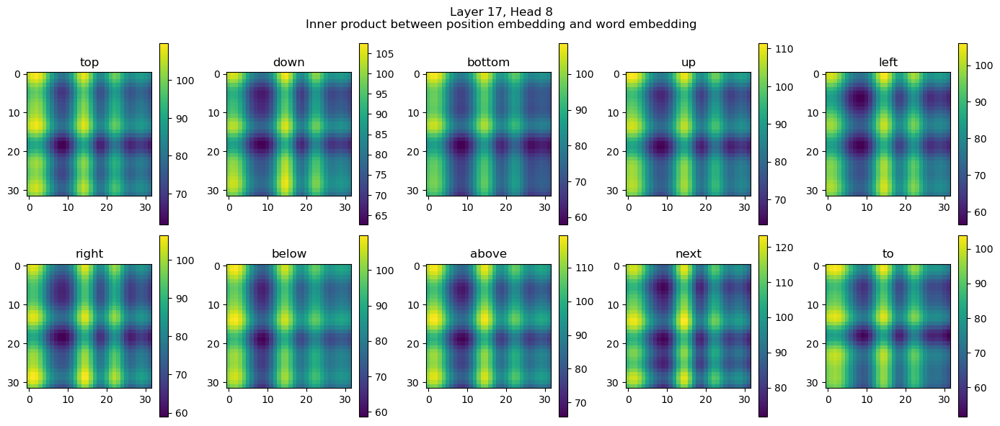

Layer 18, Head 8
Layer 18, Head 8 has max inner product 589.5 | Padding inner product 591.5 Examine.


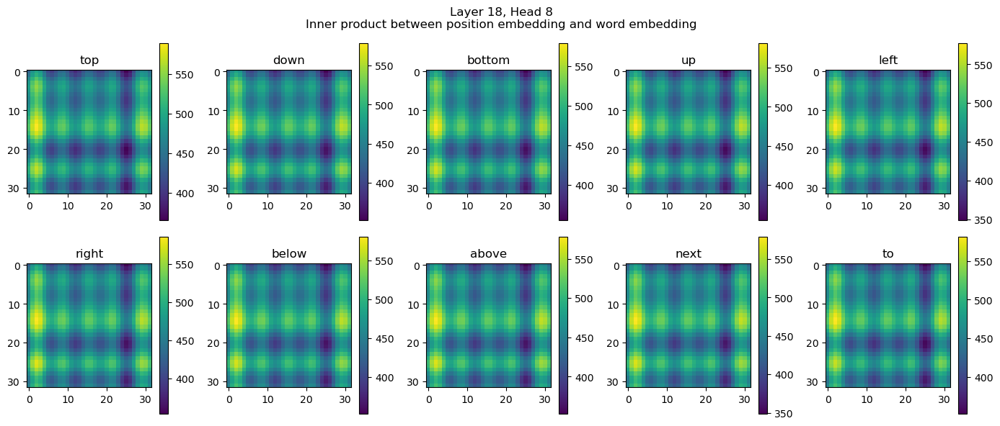

Layer 19, Head 8
Layer 20, Head 8
Layer 20, Head 8 has max inner product 156.625 | Padding inner product 153.375 Examine.


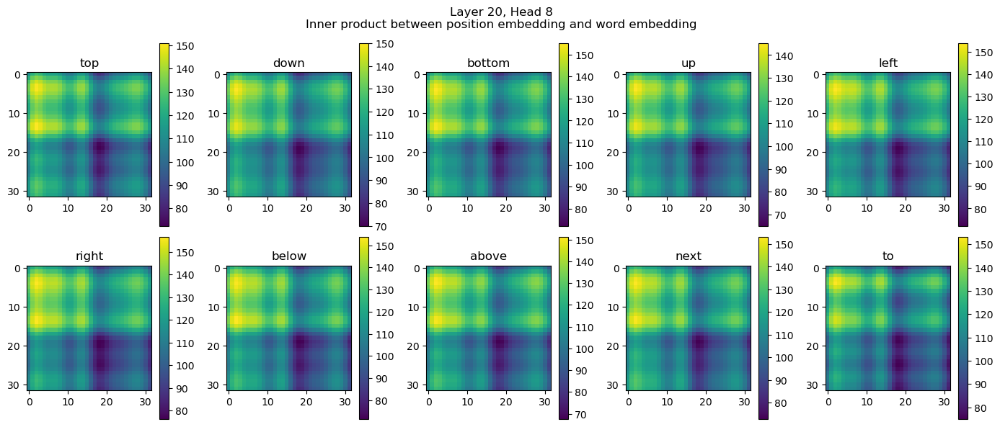

Layer 21, Head 8
Layer 21, Head 8 has max inner product 16.609375 | Padding inner product 16.875 Examine.


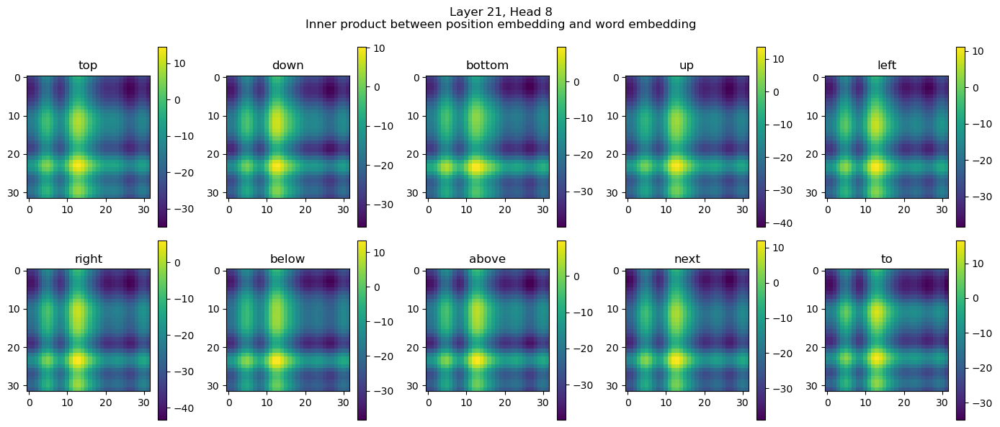

Layer 22, Head 8
Layer 23, Head 8
Layer 24, Head 8
Layer 25, Head 8
Layer 25, Head 8 has max inner product 1605.0 | Padding inner product 1628.0 Examine.


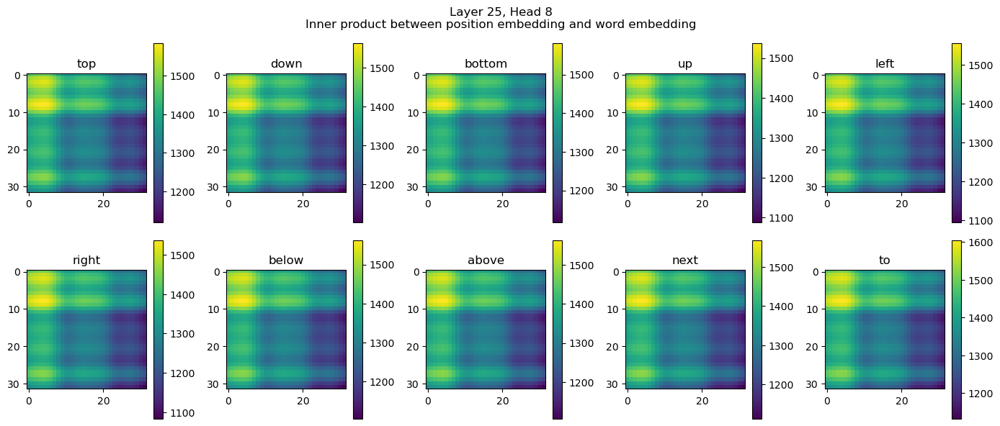

Layer 26, Head 8
Layer 27, Head 8
Layer 0, Head 9
Layer 1, Head 9
Layer 2, Head 9
Layer 3, Head 9
Layer 3, Head 9 has max inner product 51.59375 | Padding inner product 20.09375 Examine.


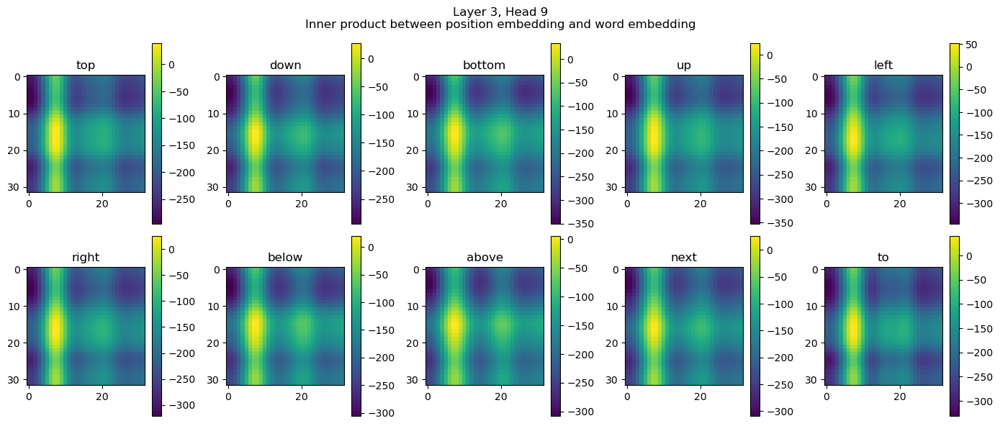

Layer 4, Head 9
Layer 5, Head 9
Layer 6, Head 9
Layer 7, Head 9
Layer 8, Head 9
Layer 9, Head 9
Layer 9, Head 9 has max inner product 33.03125 | Padding inner product 41.875 Examine.


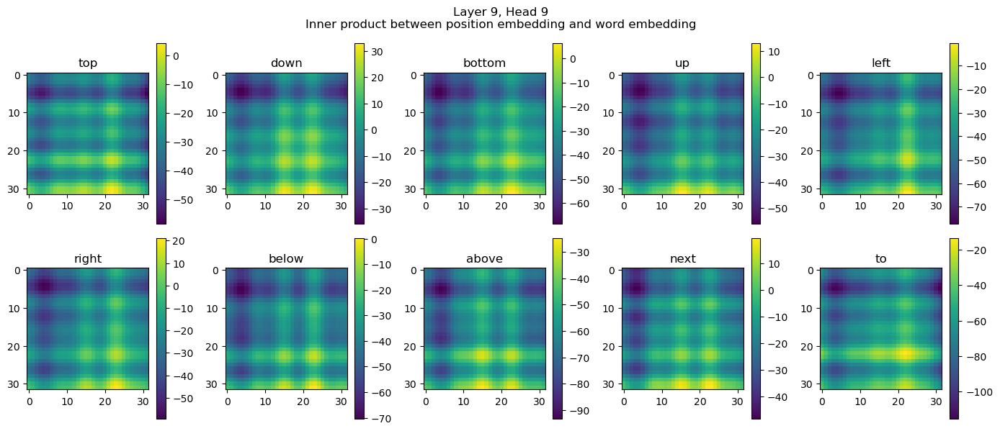

Layer 10, Head 9
Layer 11, Head 9
Layer 11, Head 9 has max inner product 79.1875 | Padding inner product 103.875 Examine.


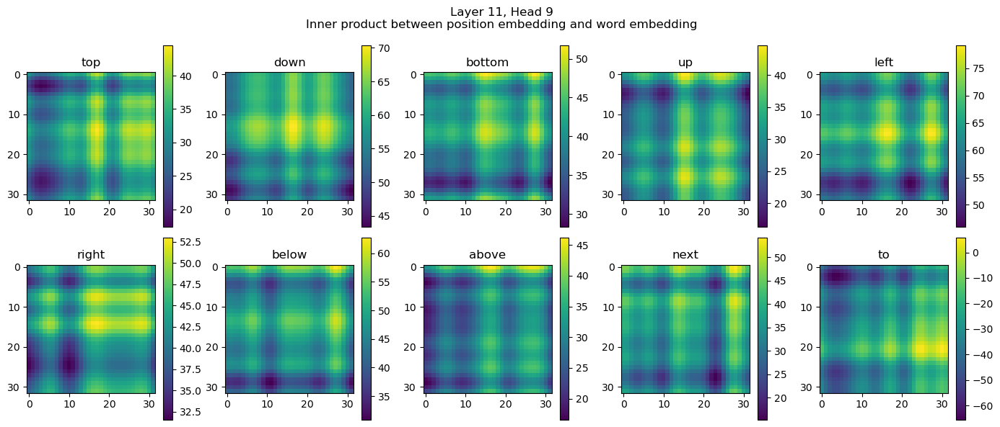

Layer 12, Head 9
Layer 13, Head 9
Layer 13, Head 9 has max inner product 191.0 | Padding inner product 194.375 Examine.


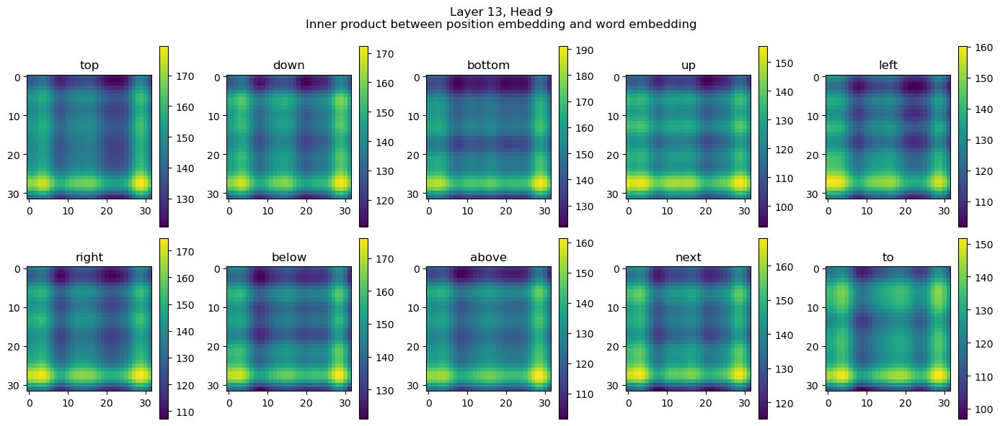

Layer 14, Head 9
Layer 15, Head 9
Layer 15, Head 9 has max inner product 10.1796875 | Padding inner product 20.28125 Examine.


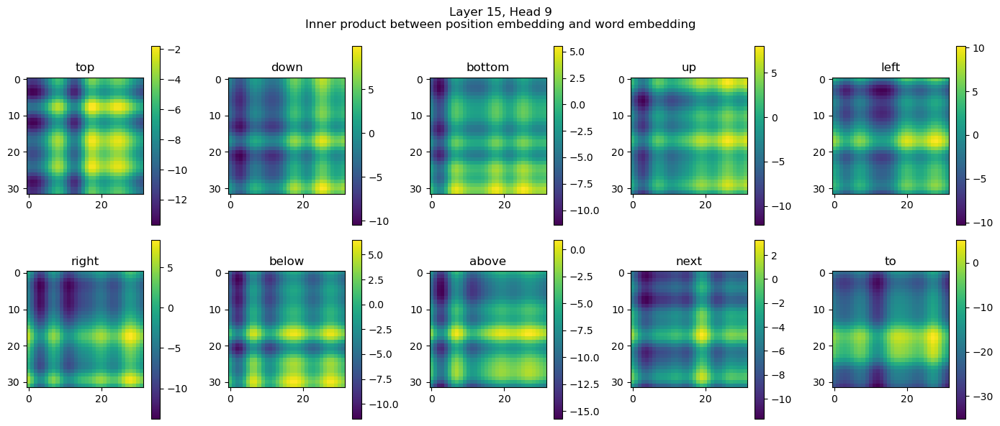

Layer 16, Head 9
Layer 17, Head 9
Layer 18, Head 9
Layer 19, Head 9
Layer 20, Head 9
Layer 20, Head 9 has max inner product 61.875 | Padding inner product 64.0625 Examine.


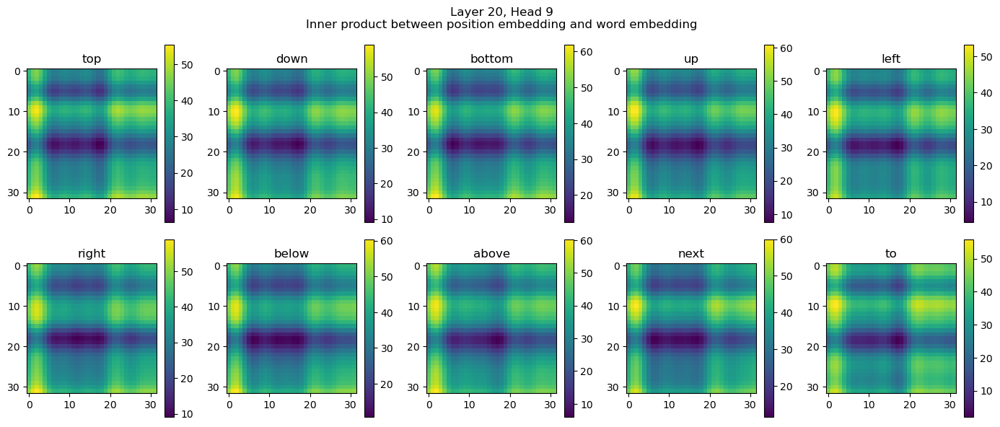

Layer 21, Head 9
Layer 21, Head 9 has max inner product 82.1875 | Padding inner product 89.9375 Examine.


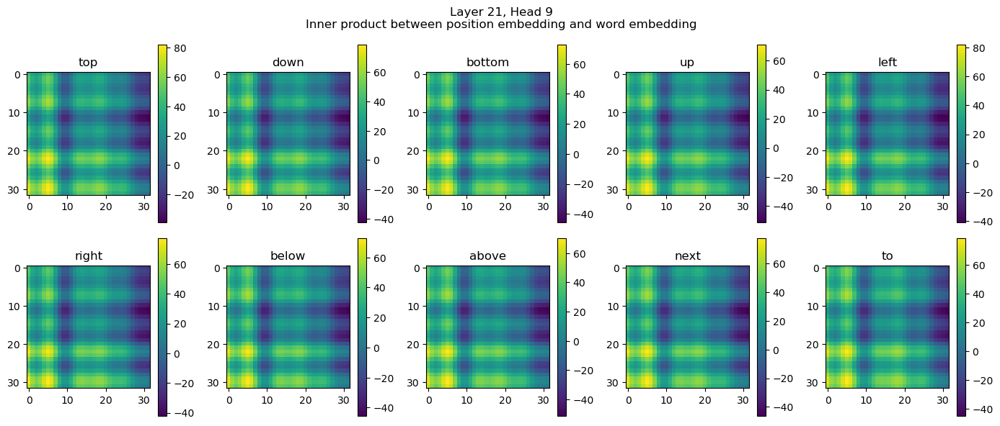

Layer 22, Head 9
Layer 23, Head 9
Layer 23, Head 9 has max inner product 45.90625 | Padding inner product 45.09375 Examine.


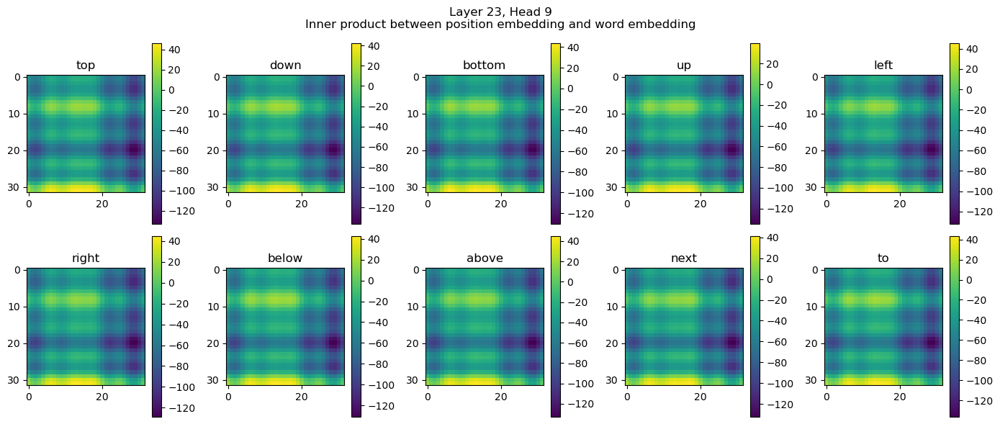

Layer 24, Head 9
Layer 25, Head 9
Layer 26, Head 9
Layer 27, Head 9
Layer 0, Head 10
Layer 1, Head 10
Layer 2, Head 10
Layer 3, Head 10
Layer 4, Head 10
Layer 5, Head 10
Layer 6, Head 10
Layer 7, Head 10
Layer 8, Head 10
Layer 9, Head 10
Layer 9, Head 10 has max inner product 10.4140625 | Padding inner product -1.0654296875 Examine.


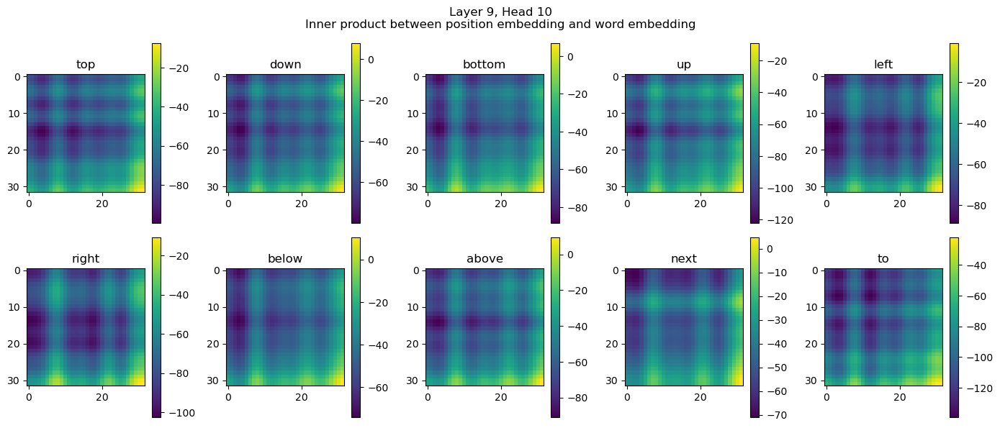

Layer 10, Head 10
Layer 10, Head 10 has max inner product 22.5 | Padding inner product 80.875 Examine.


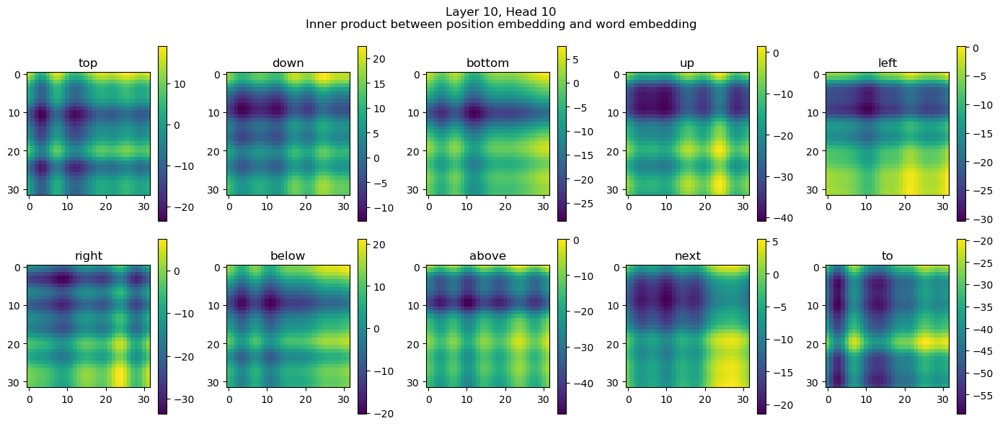

Layer 11, Head 10
Layer 11, Head 10 has max inner product 21.078125 | Padding inner product 34.65625 Examine.


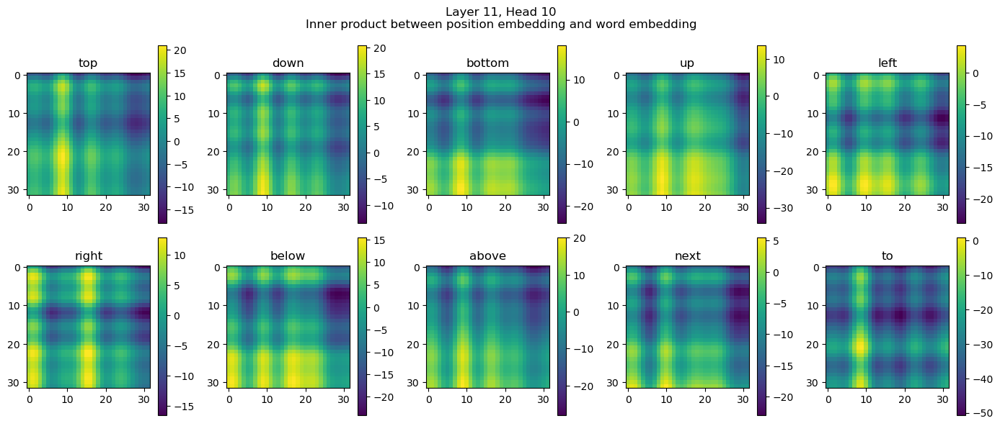

Layer 12, Head 10
Layer 13, Head 10
Layer 13, Head 10 has max inner product 27.28125 | Padding inner product 21.46875 Examine.


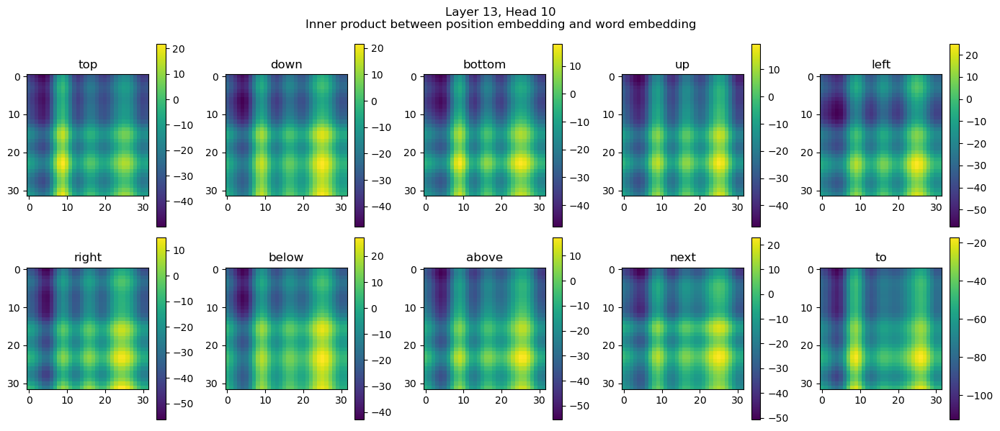

Layer 14, Head 10
Layer 15, Head 10
Layer 15, Head 10 has max inner product 91.8125 | Padding inner product 103.125 Examine.


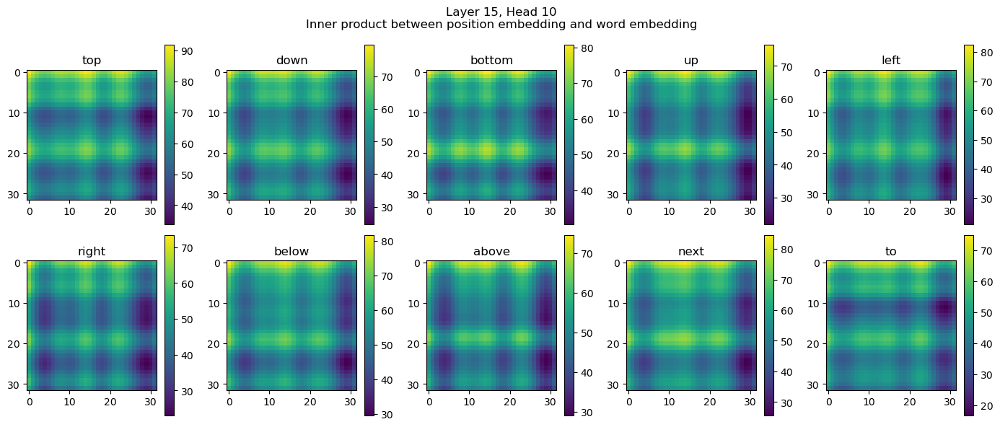

Layer 16, Head 10
Layer 16, Head 10 has max inner product 18.96875 | Padding inner product 17.6875 Examine.


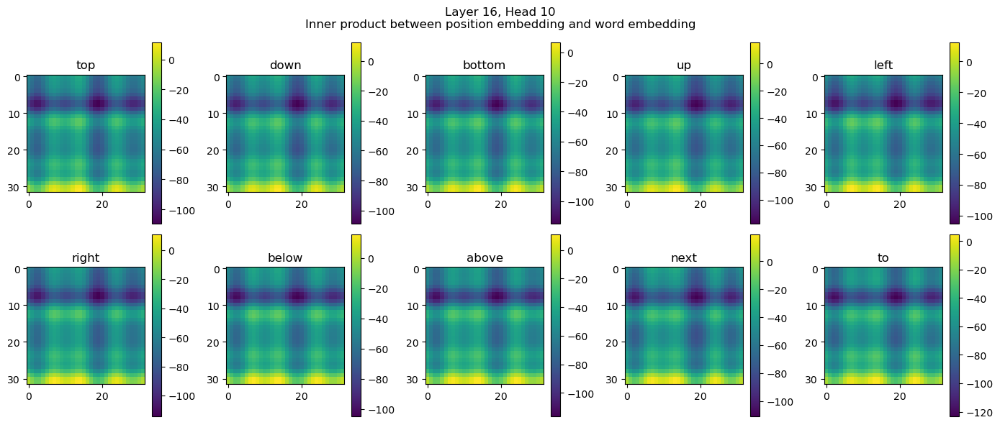

Layer 17, Head 10
Layer 17, Head 10 has max inner product 521.0 | Padding inner product 506.75 Examine.


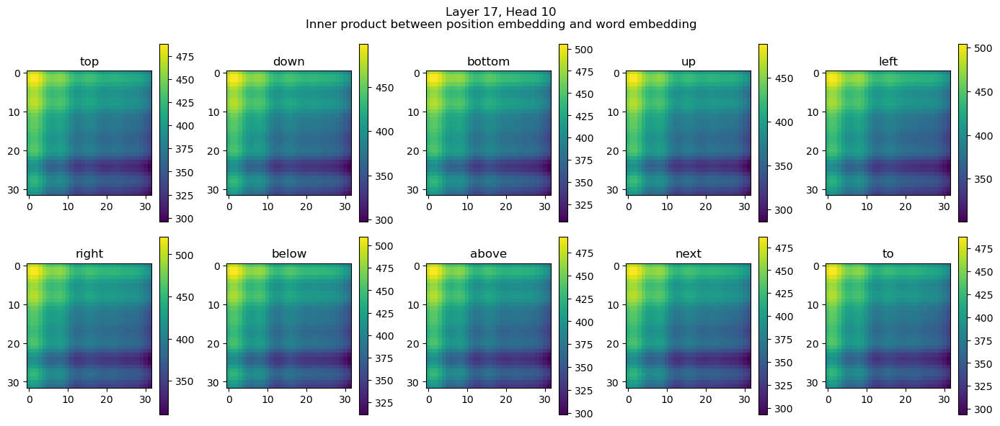

Layer 18, Head 10
Layer 18, Head 10 has max inner product 90.1875 | Padding inner product 98.875 Examine.


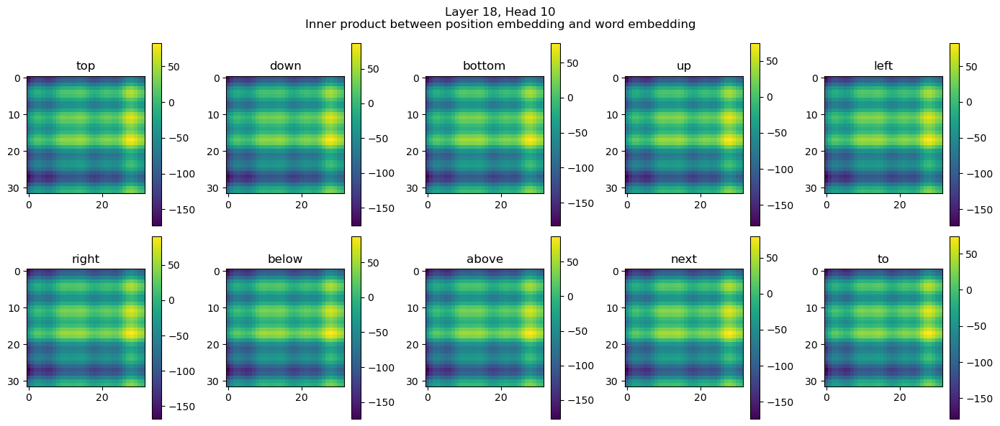

Layer 19, Head 10
Layer 20, Head 10
Layer 21, Head 10
Layer 22, Head 10
Layer 22, Head 10 has max inner product 20.25 | Padding inner product 19.03125 Examine.


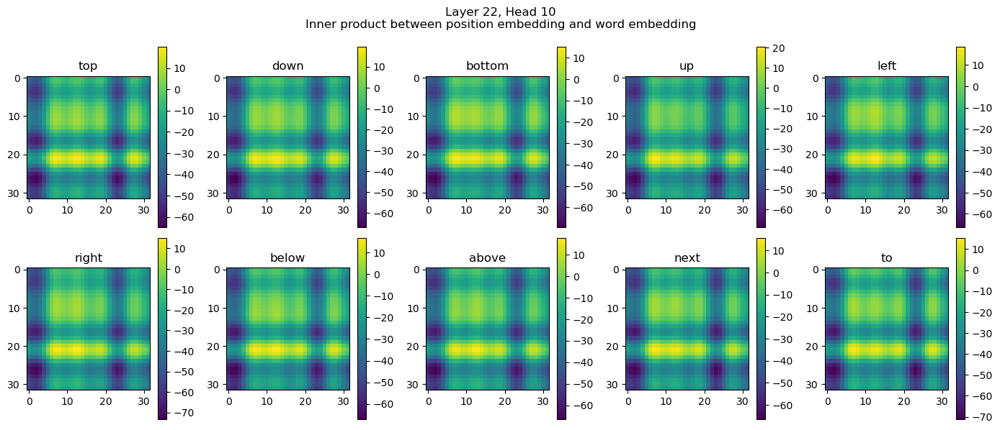

Layer 23, Head 10
Layer 23, Head 10 has max inner product 43.53125 | Padding inner product 48.71875 Examine.


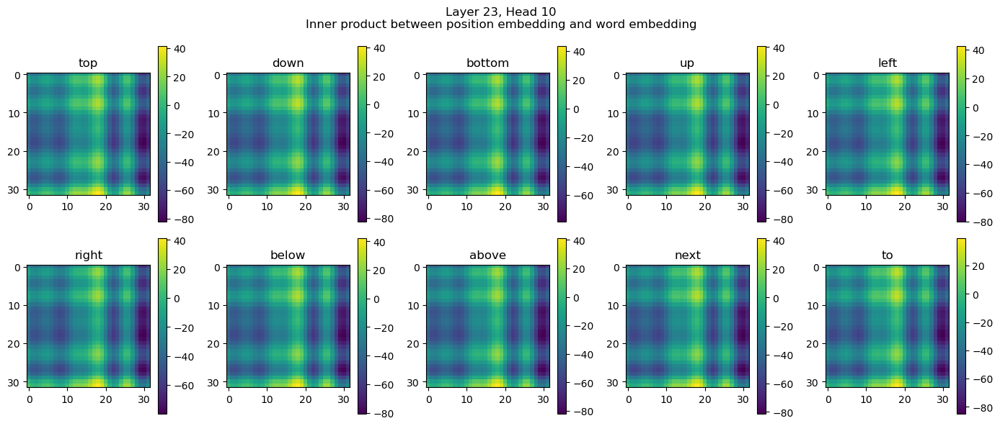

Layer 24, Head 10
Layer 24, Head 10 has max inner product 1049.0 | Padding inner product 1060.0 Examine.


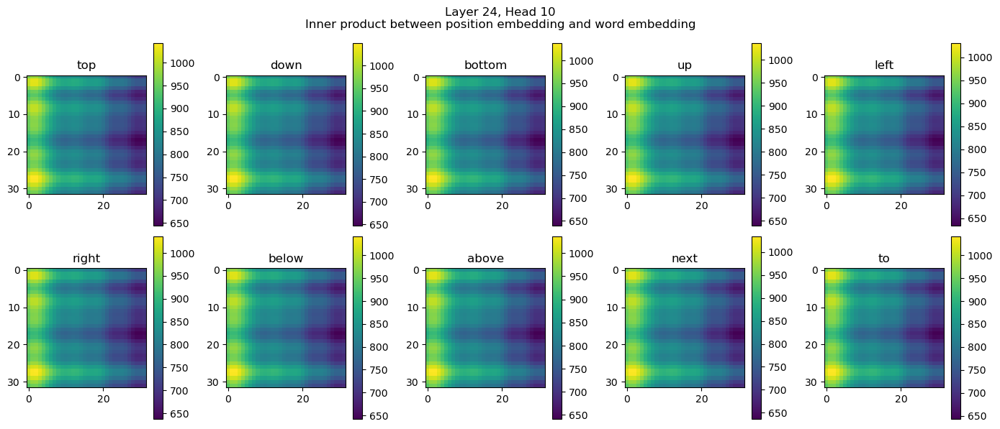

Layer 25, Head 10
Layer 25, Head 10 has max inner product 11672.0 | Padding inner product 11720.0 Examine.


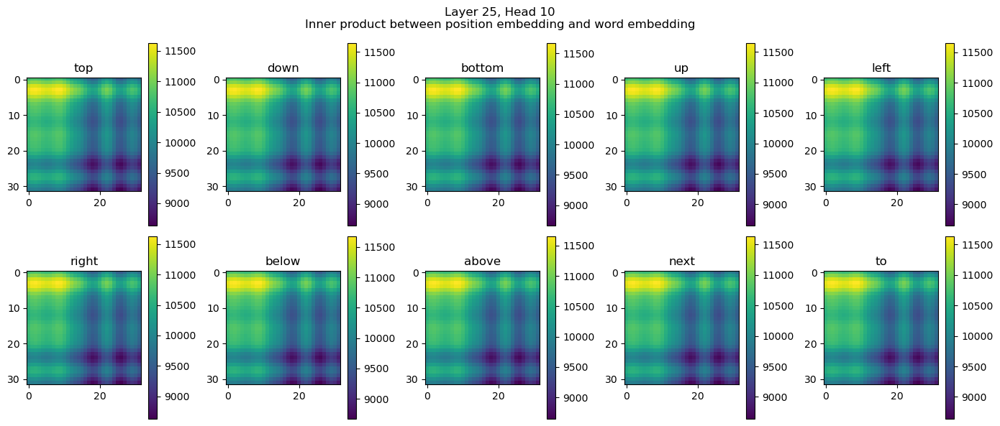

Layer 26, Head 10
Layer 26, Head 10 has max inner product 34.3125 | Padding inner product 35.09375 Examine.


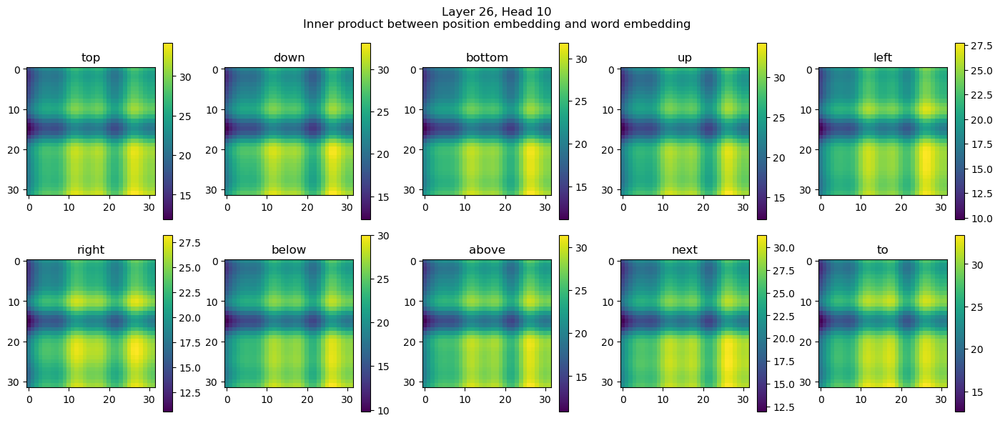

Layer 27, Head 10
Layer 27, Head 10 has max inner product 34.1875 | Padding inner product 71.5625 Examine.


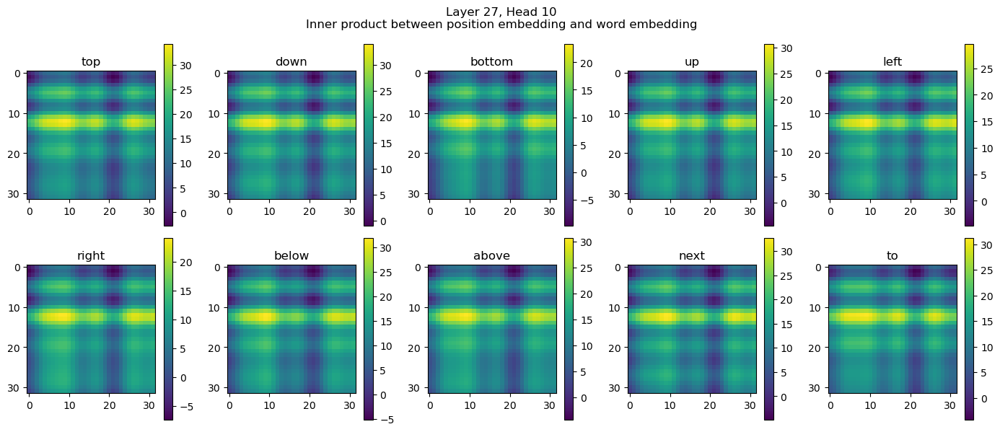

Layer 0, Head 11
Layer 1, Head 11
Layer 2, Head 11
Layer 3, Head 11
Layer 4, Head 11
Layer 4, Head 11 has max inner product 19.921875 | Padding inner product 43.0625 Examine.


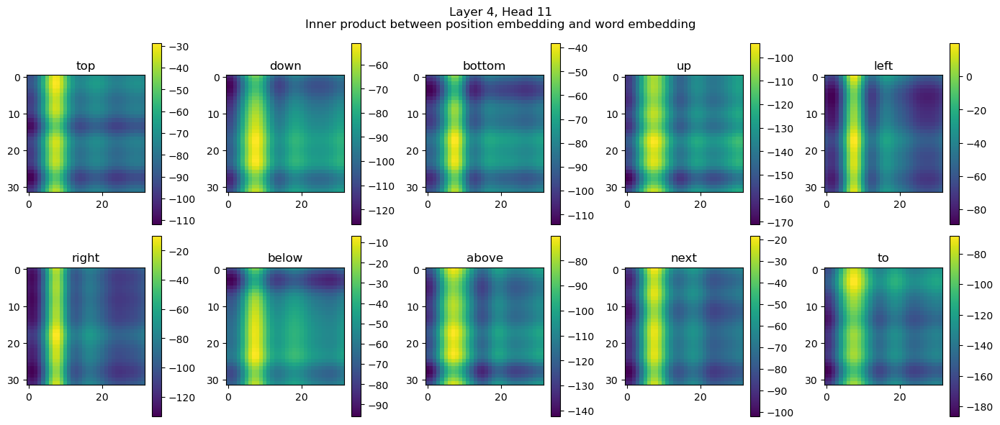

Layer 5, Head 11
Layer 6, Head 11
Layer 7, Head 11
Layer 8, Head 11
Layer 9, Head 11
Layer 9, Head 11 has max inner product 43.65625 | Padding inner product 51.75 Examine.


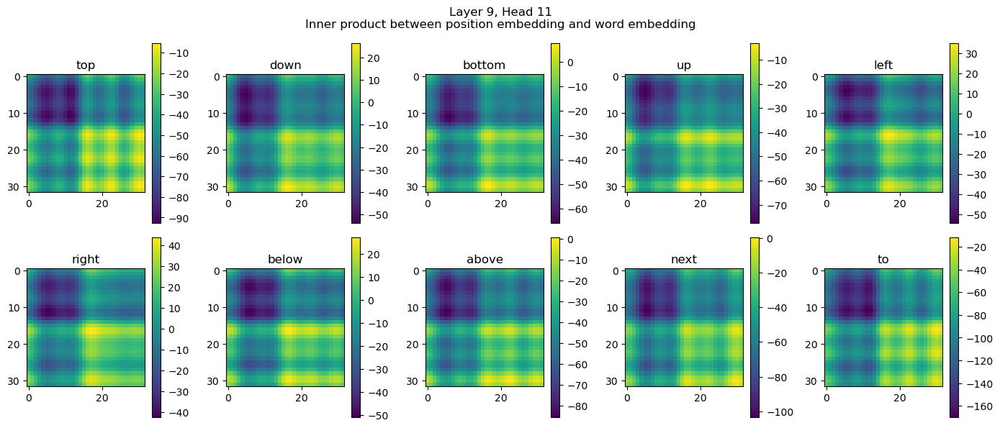

Layer 10, Head 11
Layer 11, Head 11
Layer 11, Head 11 has max inner product 106.1875 | Padding inner product 118.3125 Examine.


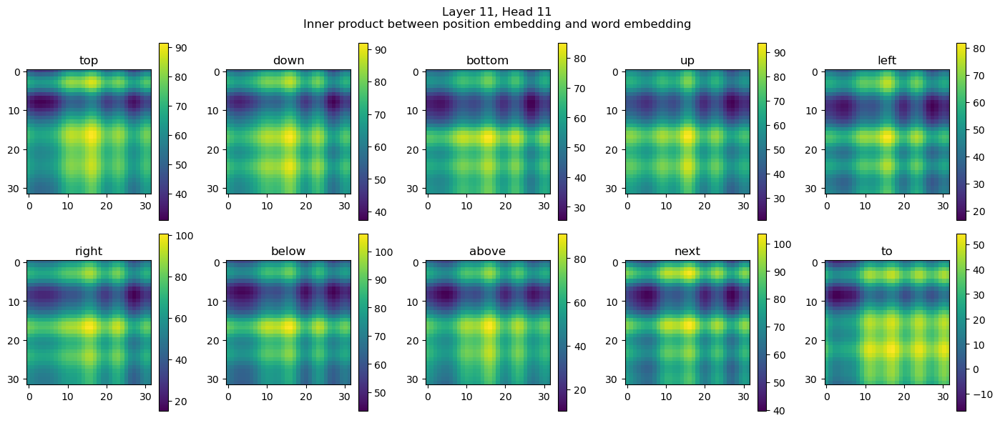

Layer 12, Head 11
Layer 12, Head 11 has max inner product 35.84375 | Padding inner product 30.15625 Examine.


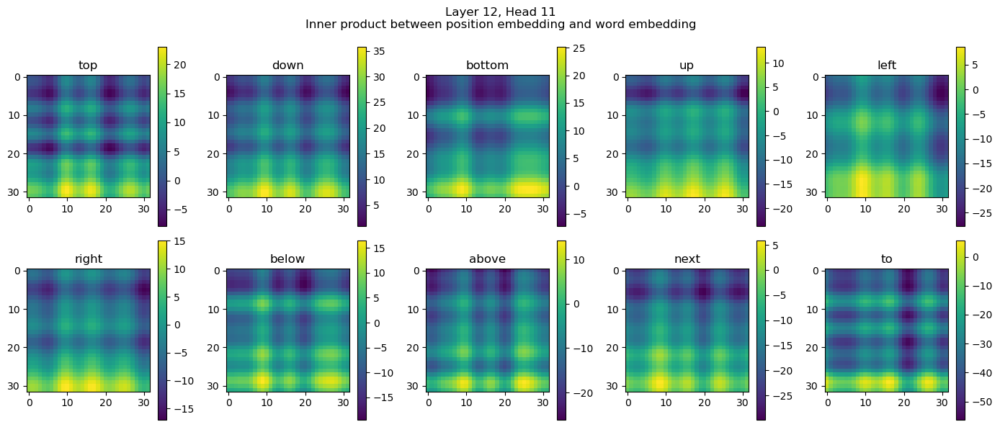

Layer 13, Head 11
Layer 14, Head 11
Layer 14, Head 11 has max inner product 1108.0 | Padding inner product 1114.0 Examine.


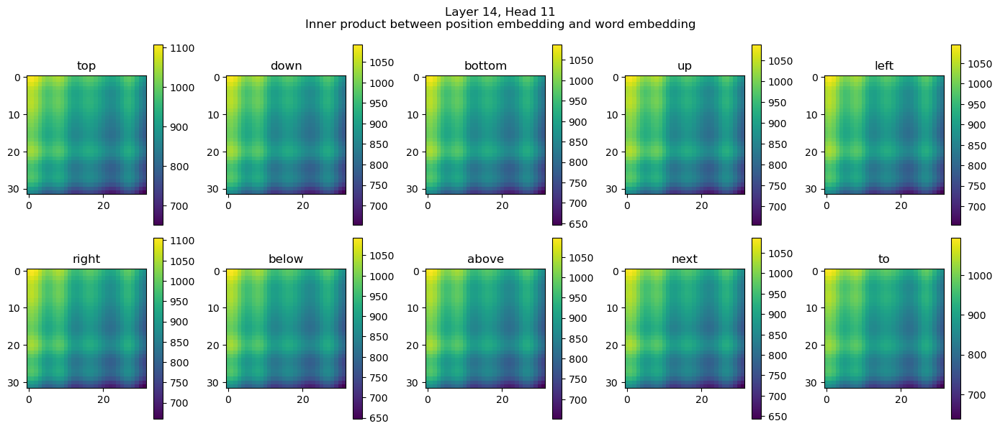

Layer 15, Head 11
Layer 16, Head 11
Layer 16, Head 11 has max inner product 13.2734375 | Padding inner product 22.140625 Examine.


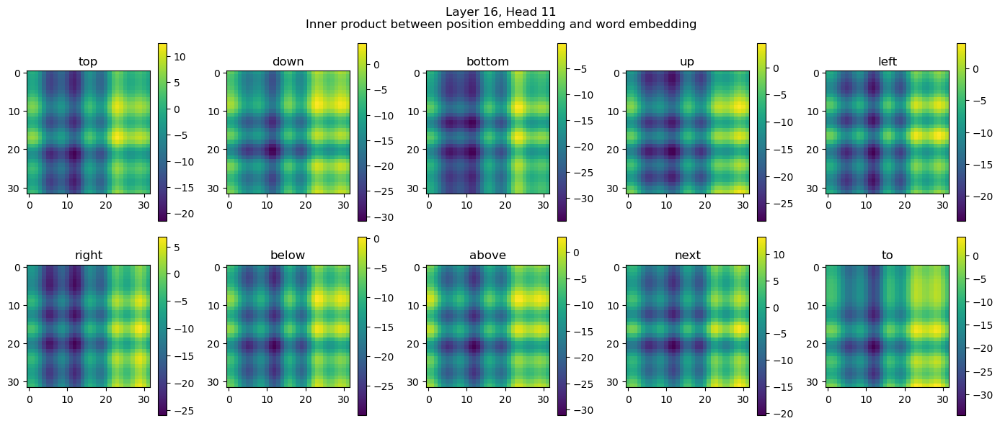

Layer 17, Head 11
Layer 17, Head 11 has max inner product 576.0 | Padding inner product 585.5 Examine.


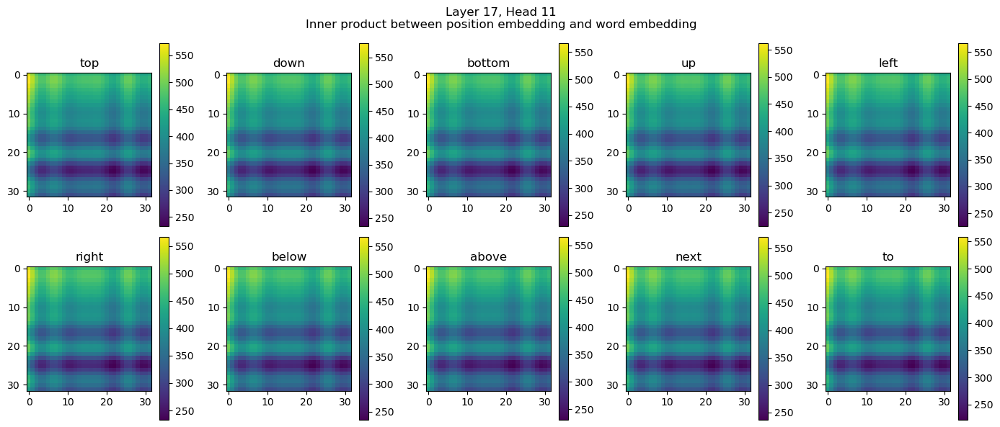

Layer 18, Head 11
Layer 18, Head 11 has max inner product 106.625 | Padding inner product 111.625 Examine.


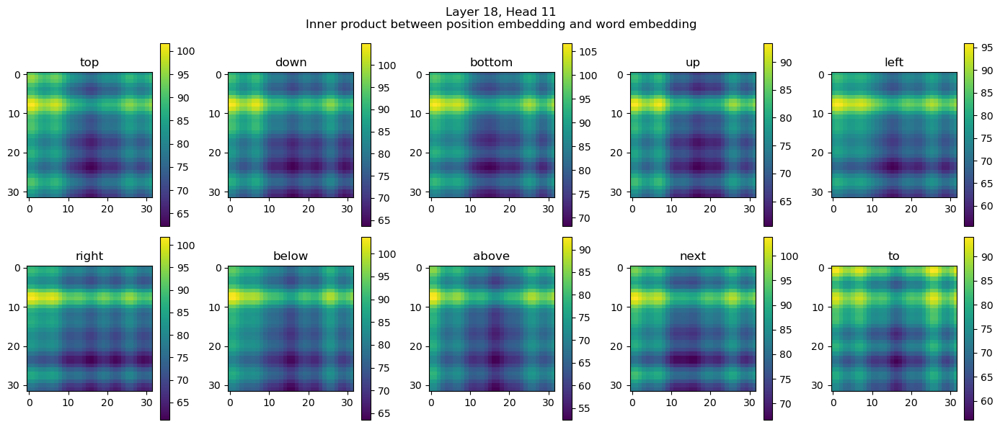

Layer 19, Head 11
Layer 20, Head 11
Layer 20, Head 11 has max inner product 35.65625 | Padding inner product 35.0625 Examine.


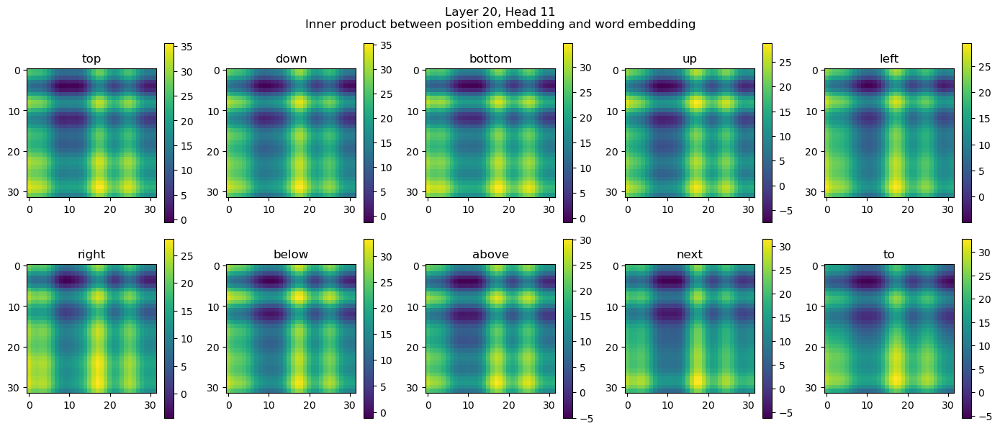

Layer 21, Head 11
Layer 22, Head 11
Layer 22, Head 11 has max inner product 12032.0 | Padding inner product 12064.0 Examine.


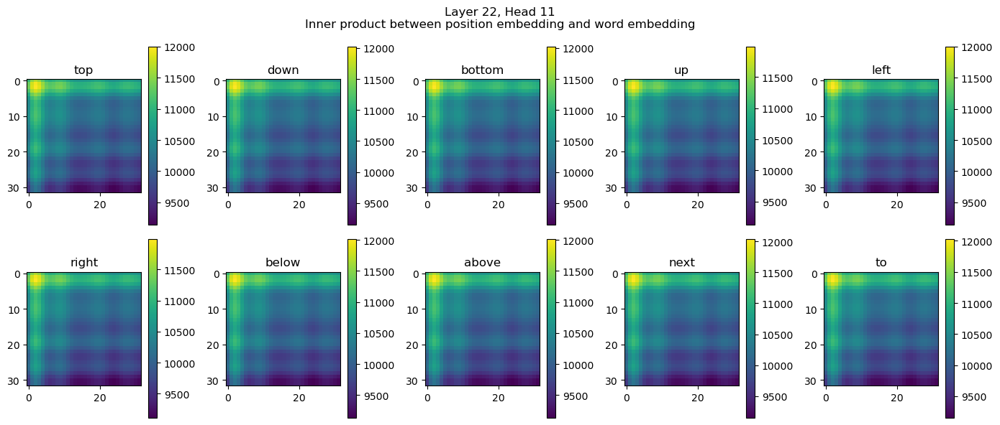

Layer 23, Head 11
Layer 23, Head 11 has max inner product 526.0 | Padding inner product 533.5 Examine.


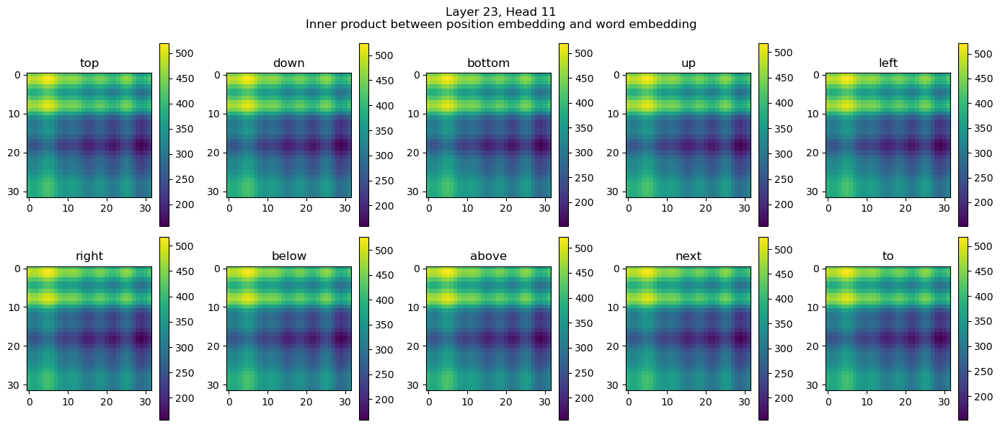

Layer 24, Head 11
Layer 25, Head 11
Layer 25, Head 11 has max inner product 1327.0 | Padding inner product 1359.0 Examine.


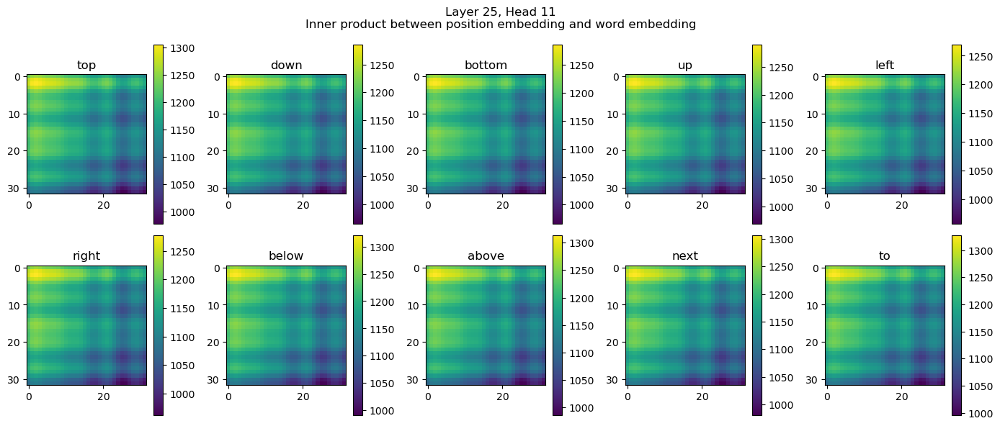

Layer 26, Head 11
Layer 27, Head 11
Layer 27, Head 11 has max inner product 1063.0 | Padding inner product 1069.0 Examine.


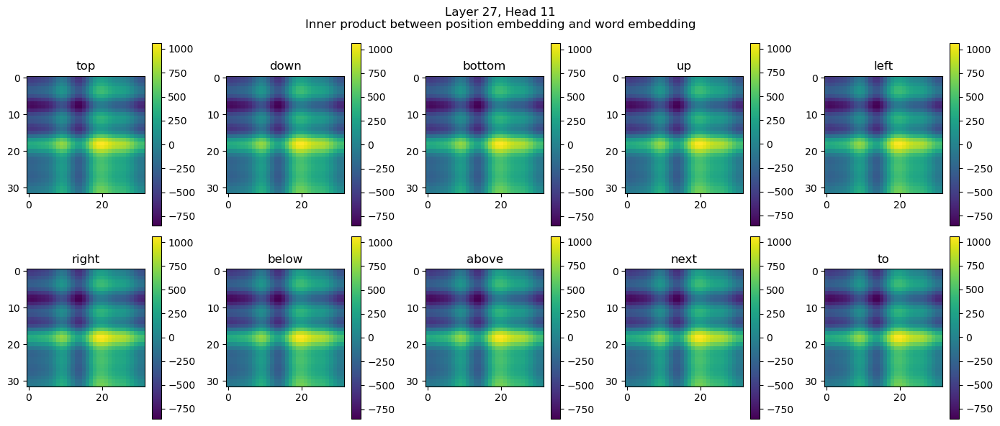

Layer 0, Head 12
Layer 1, Head 12
Layer 2, Head 12
Layer 3, Head 12
Layer 3, Head 12 has max inner product 15.4921875 | Padding inner product 94.0 Examine.


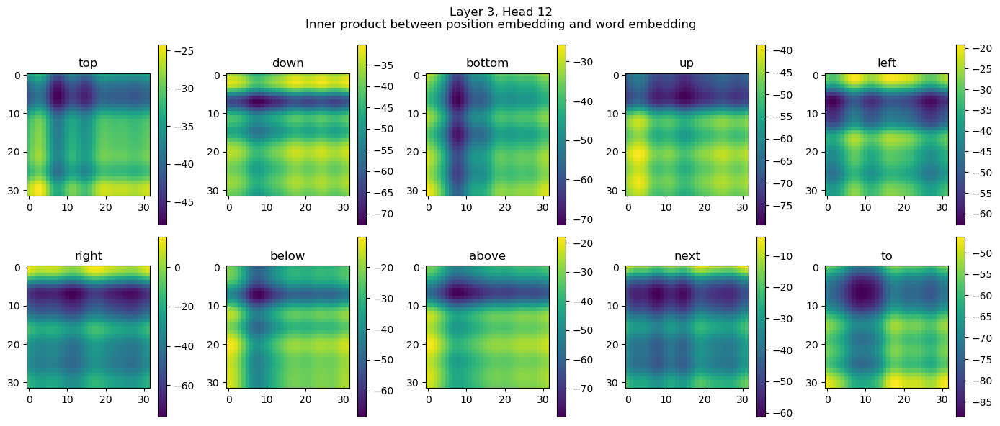

Layer 4, Head 12
Layer 5, Head 12
Layer 6, Head 12
Layer 7, Head 12
Layer 8, Head 12
Layer 9, Head 12
Layer 9, Head 12 has max inner product 82.8125 | Padding inner product 124.3125 Examine.


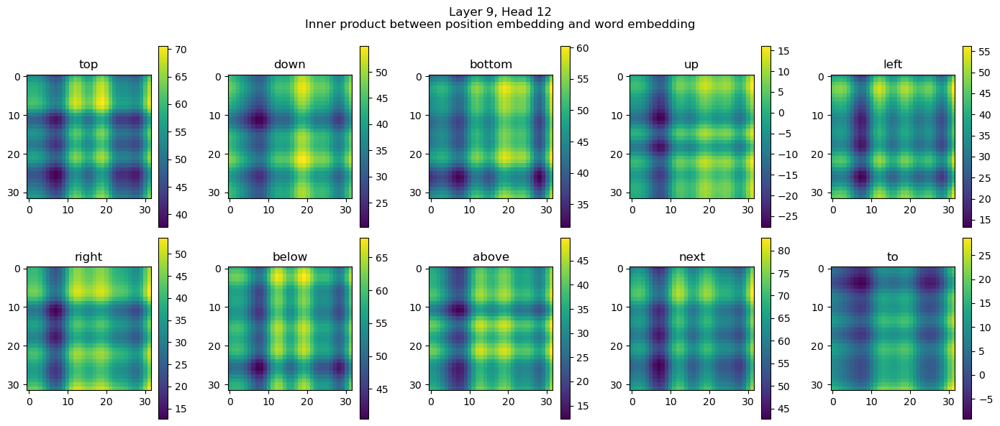

Layer 10, Head 12
Layer 11, Head 12
Layer 12, Head 12
Layer 12, Head 12 has max inner product 73.0 | Padding inner product 55.875 Examine.


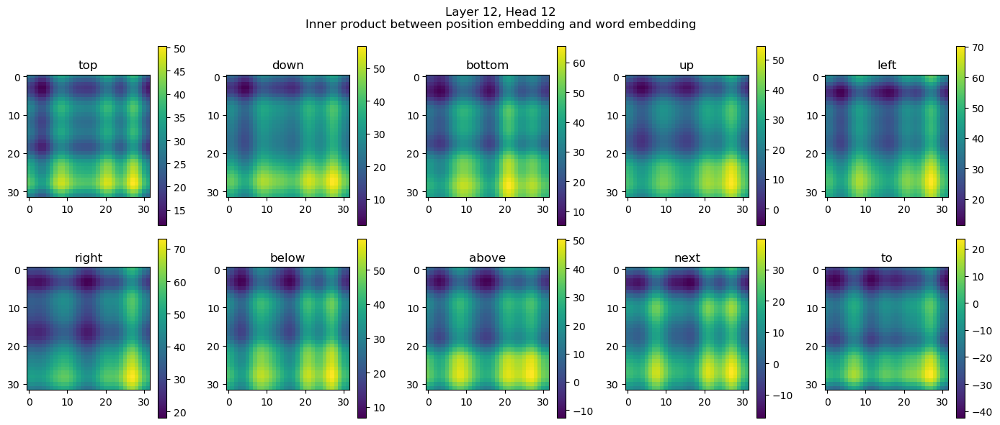

Layer 13, Head 12
Layer 13, Head 12 has max inner product 89.375 | Padding inner product 99.125 Examine.


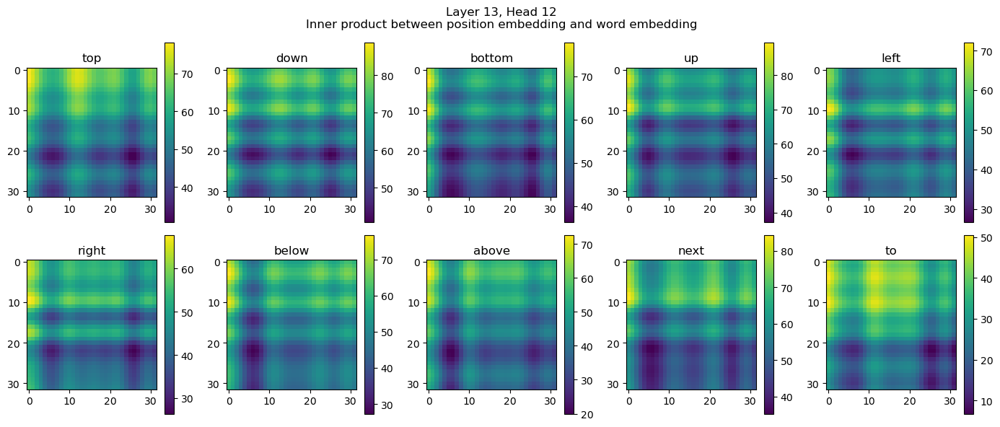

Layer 14, Head 12
Layer 14, Head 12 has max inner product 94.375 | Padding inner product 105.5 Examine.


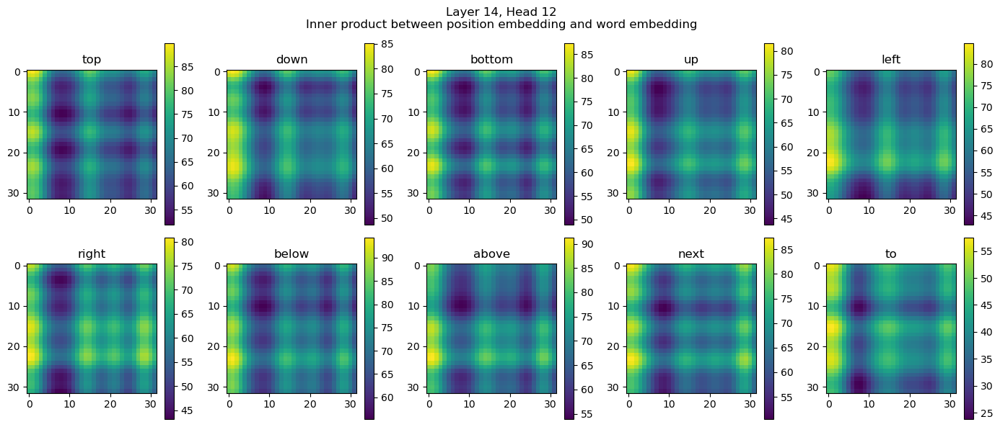

Layer 15, Head 12
Layer 15, Head 12 has max inner product 116.125 | Padding inner product 138.25 Examine.


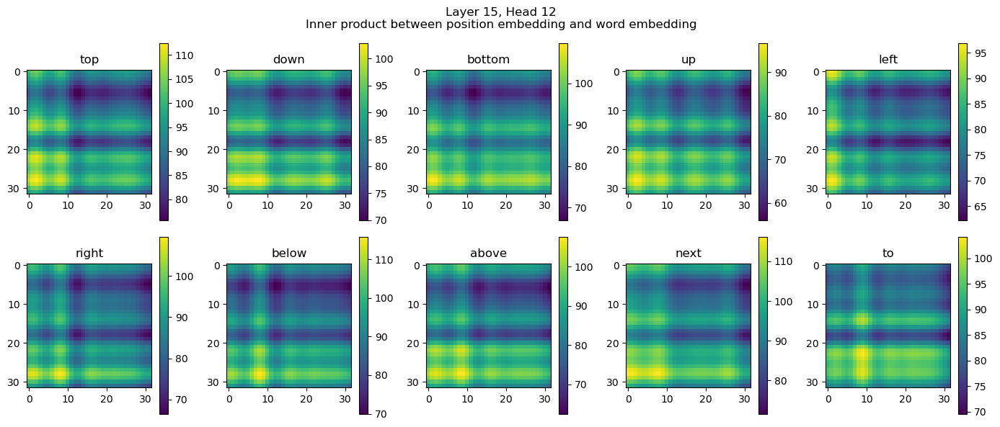

Layer 16, Head 12
Layer 16, Head 12 has max inner product 71.1875 | Padding inner product 80.3125 Examine.


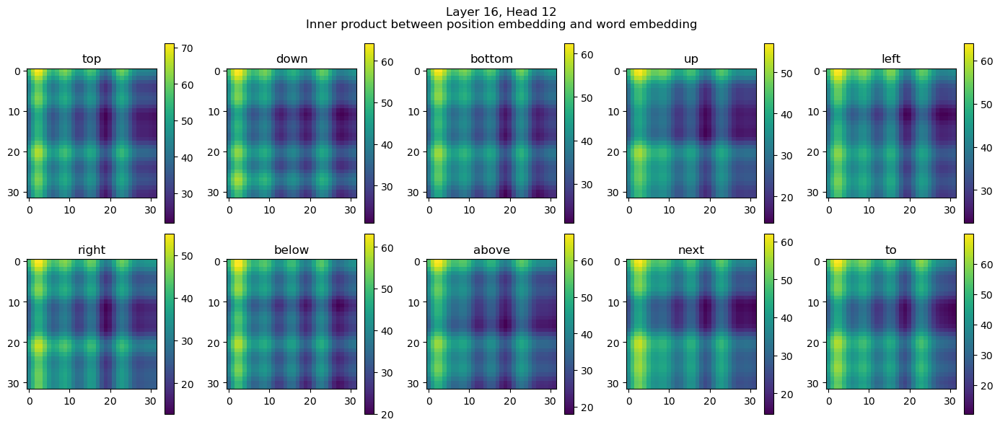

Layer 17, Head 12
Layer 18, Head 12
Layer 18, Head 12 has max inner product 50.9375 | Padding inner product 47.71875 Examine.


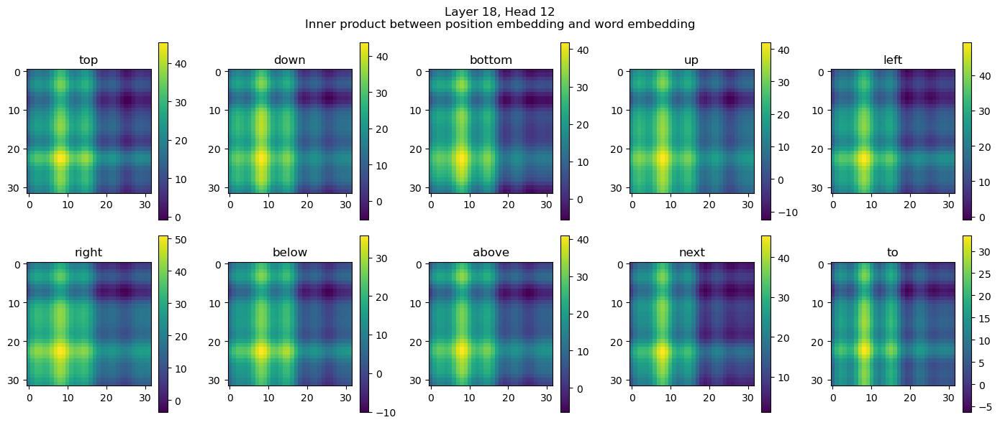

Layer 19, Head 12
Layer 20, Head 12
Layer 20, Head 12 has max inner product 4408.0 | Padding inner product 4416.0 Examine.


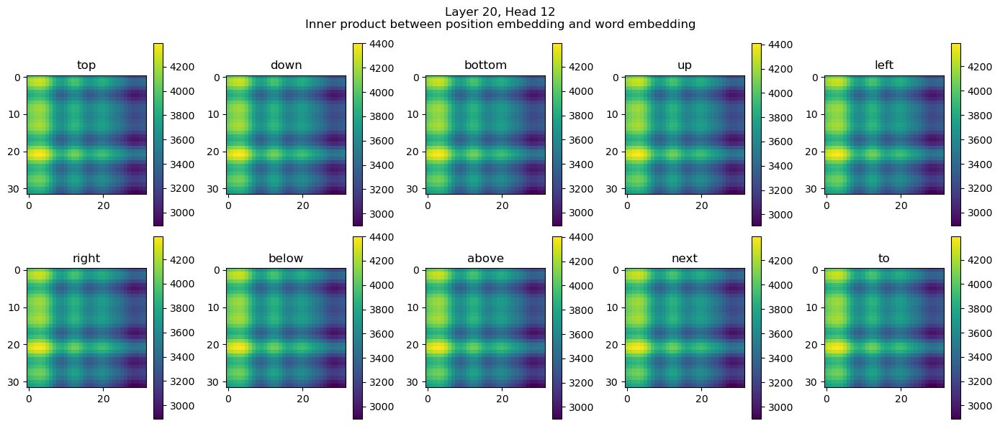

Layer 21, Head 12
Layer 21, Head 12 has max inner product 482.5 | Padding inner product 488.5 Examine.


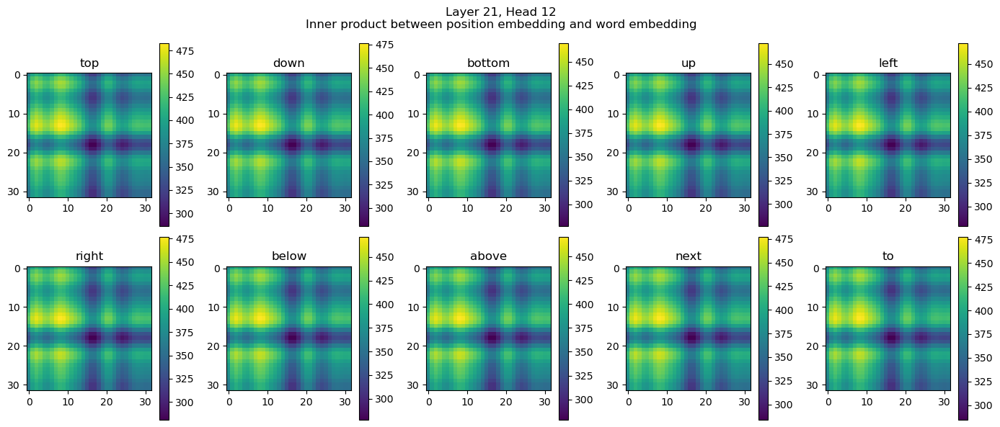

Layer 22, Head 12
Layer 23, Head 12
Layer 24, Head 12
Layer 25, Head 12
Layer 26, Head 12
Layer 27, Head 12
Layer 0, Head 13
Layer 1, Head 13
Layer 2, Head 13
Layer 3, Head 13
Layer 4, Head 13
Layer 5, Head 13
Layer 6, Head 13
Layer 7, Head 13
Layer 8, Head 13
Layer 9, Head 13
Layer 10, Head 13
Layer 11, Head 13
Layer 12, Head 13
Layer 12, Head 13 has max inner product 71.5625 | Padding inner product 85.3125 Examine.


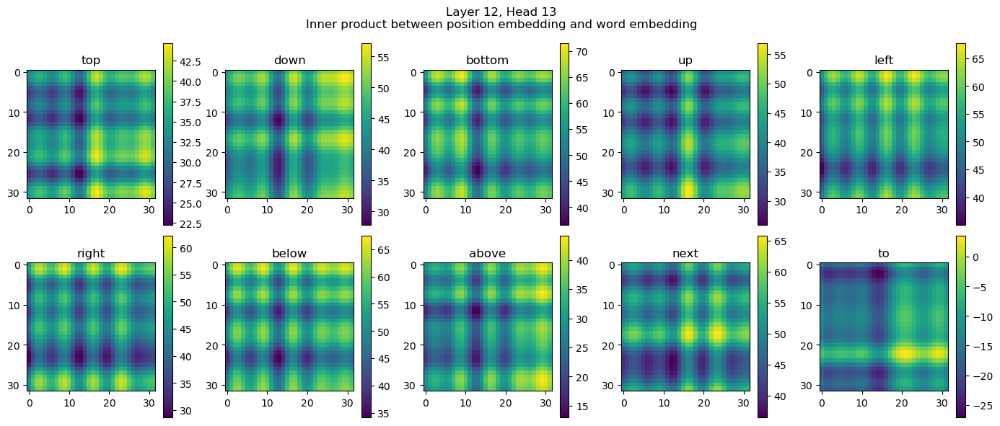

Layer 13, Head 13
Layer 13, Head 13 has max inner product 37.1875 | Padding inner product 65.9375 Examine.


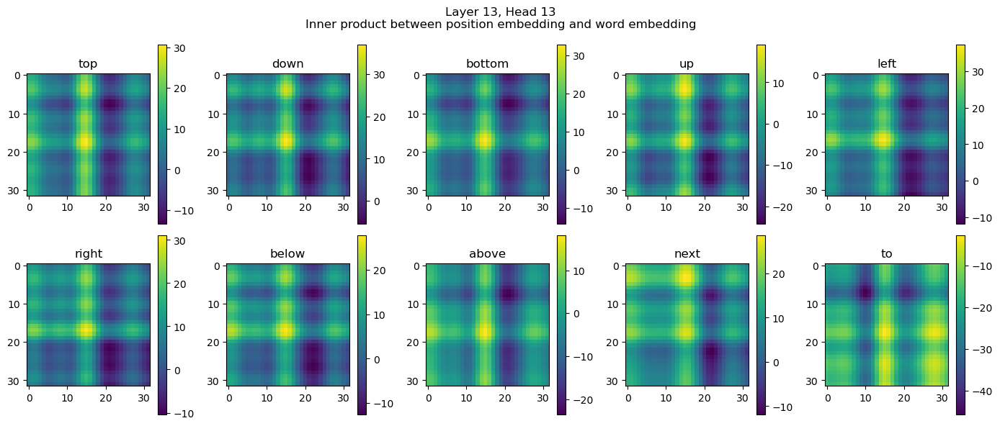

Layer 14, Head 13
Layer 14, Head 13 has max inner product 232.875 | Padding inner product 247.25 Examine.


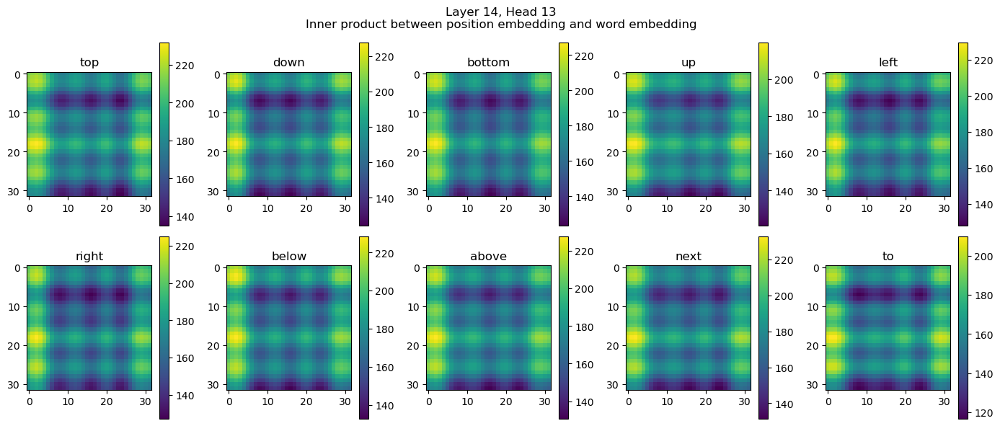

Layer 15, Head 13
Layer 16, Head 13
Layer 16, Head 13 has max inner product 67.0 | Padding inner product 70.8125 Examine.


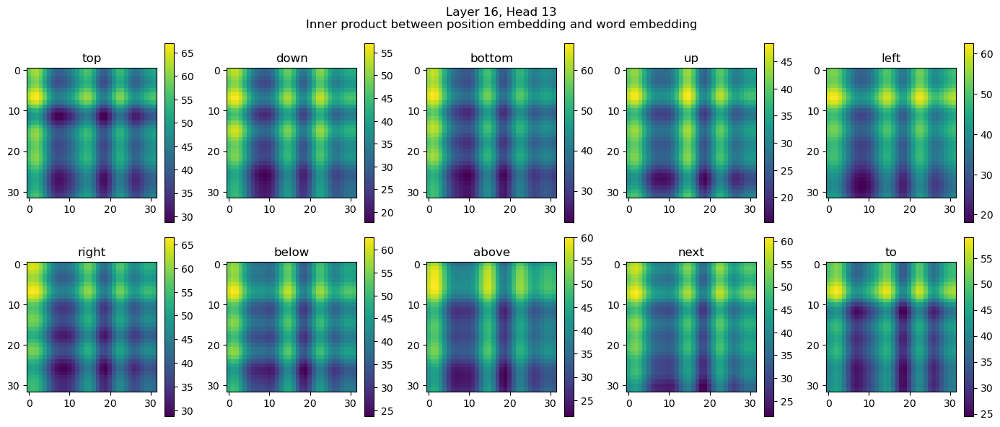

Layer 17, Head 13
Layer 18, Head 13
Layer 18, Head 13 has max inner product 105.0625 | Padding inner product 106.0 Examine.


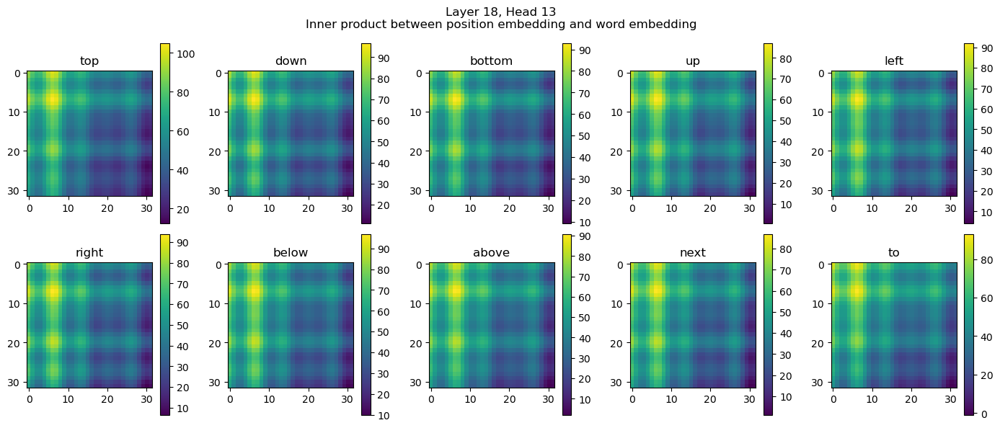

Layer 19, Head 13
Layer 19, Head 13 has max inner product 44.875 | Padding inner product 43.53125 Examine.


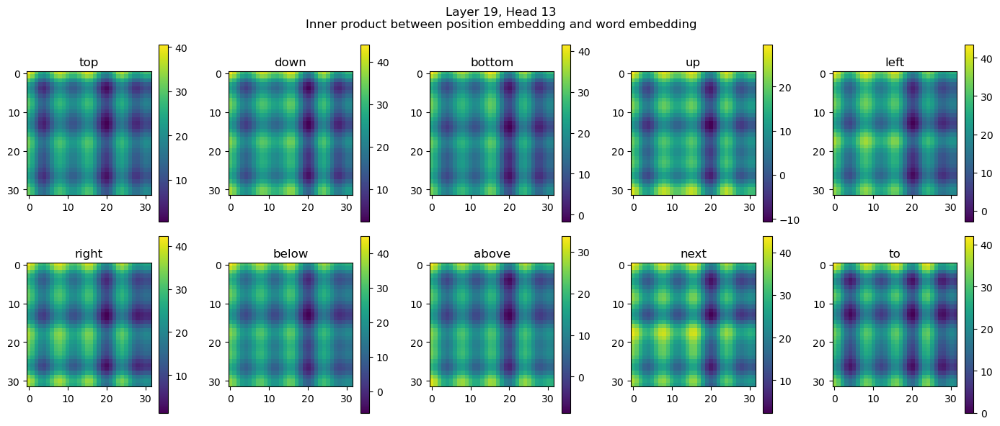

Layer 20, Head 13
Layer 21, Head 13
Layer 21, Head 13 has max inner product 15080.0 | Padding inner product 15136.0 Examine.


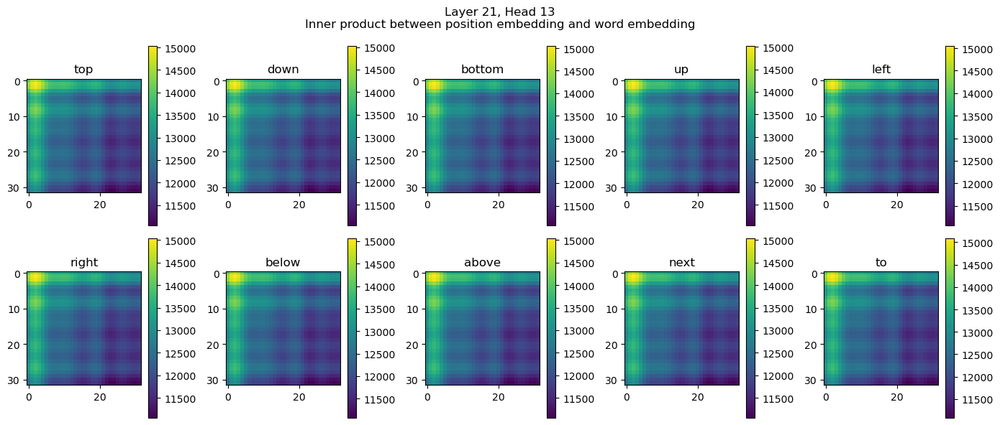

Layer 22, Head 13
Layer 22, Head 13 has max inner product 51.53125 | Padding inner product 49.15625 Examine.


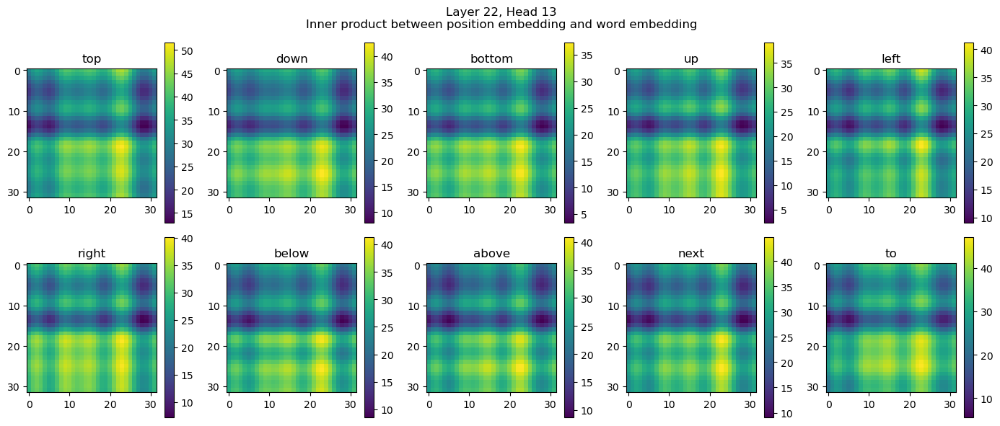

Layer 23, Head 13
Layer 24, Head 13
Layer 24, Head 13 has max inner product 5228.0 | Padding inner product 5236.0 Examine.


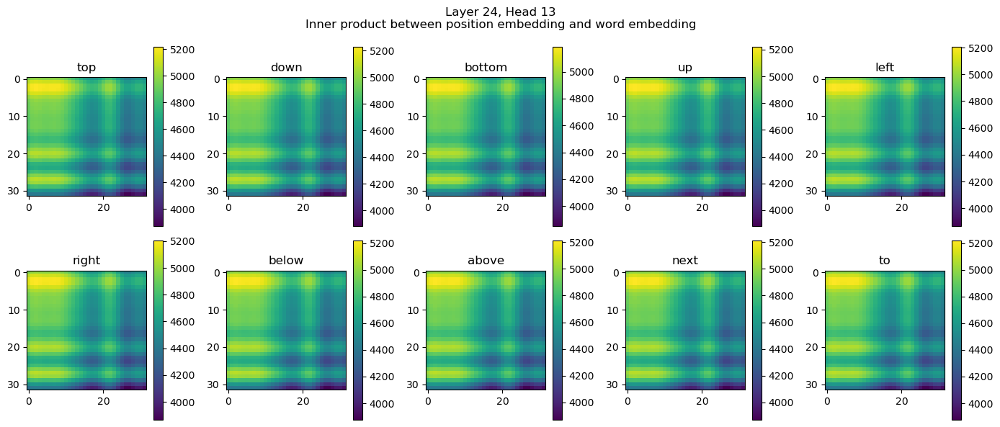

Layer 25, Head 13
Layer 26, Head 13
Layer 26, Head 13 has max inner product 472.25 | Padding inner product 474.5 Examine.


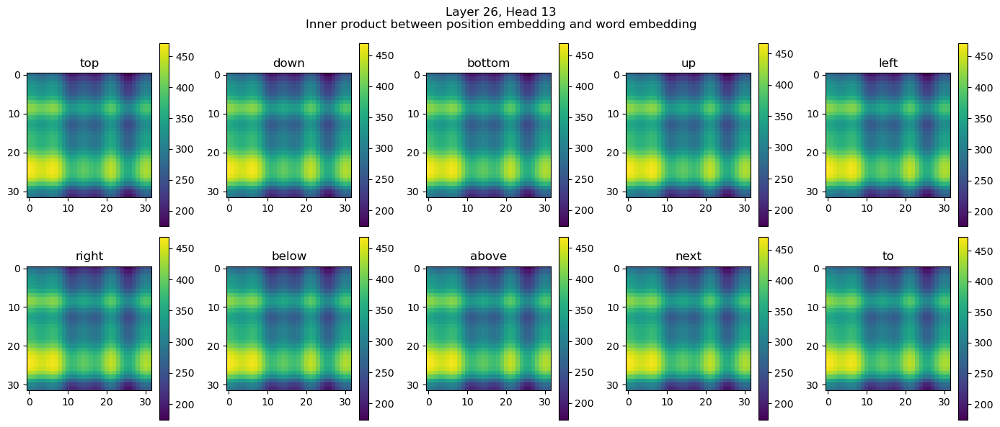

Layer 27, Head 13
Layer 0, Head 14
Layer 1, Head 14
Layer 1, Head 14 has max inner product 52.75 | Padding inner product 114.3125 Examine.


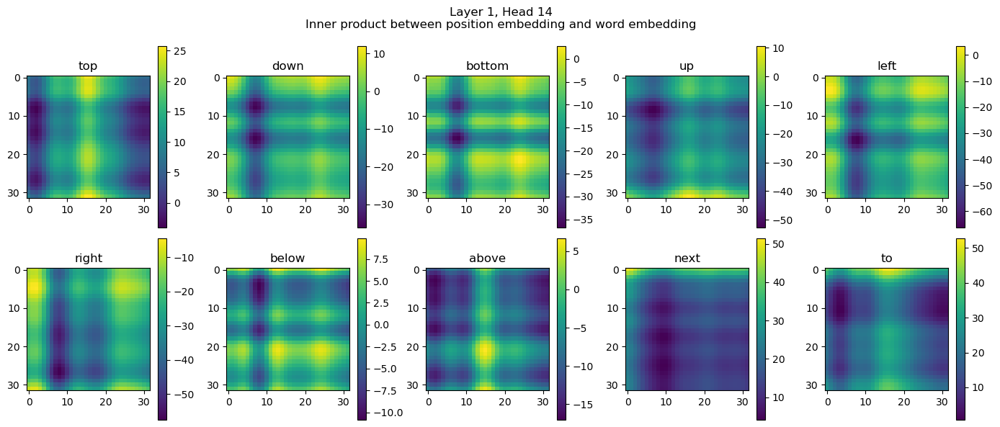

Layer 2, Head 14
Layer 3, Head 14
Layer 4, Head 14
Layer 5, Head 14
Layer 5, Head 14 has max inner product 51.5 | Padding inner product 207.625 Examine.


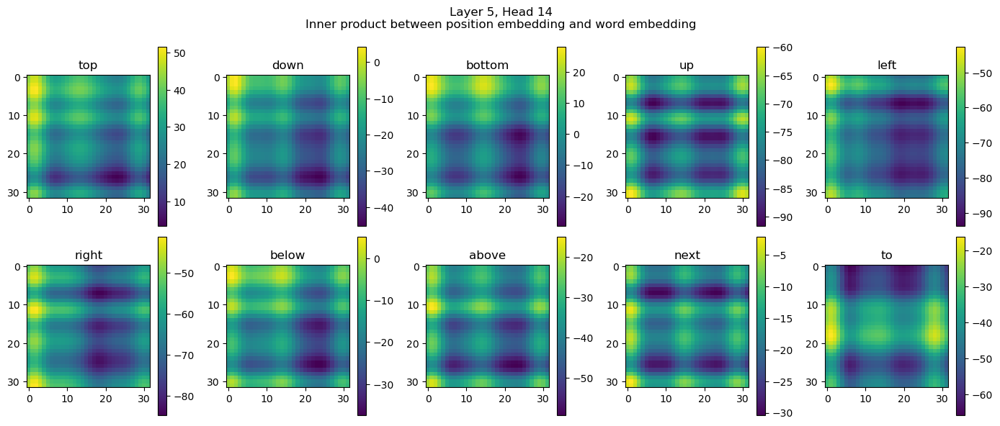

Layer 6, Head 14
Layer 7, Head 14
Layer 8, Head 14
Layer 9, Head 14
Layer 10, Head 14
Layer 11, Head 14
Layer 12, Head 14
Layer 12, Head 14 has max inner product 37.6875 | Padding inner product 37.90625 Examine.


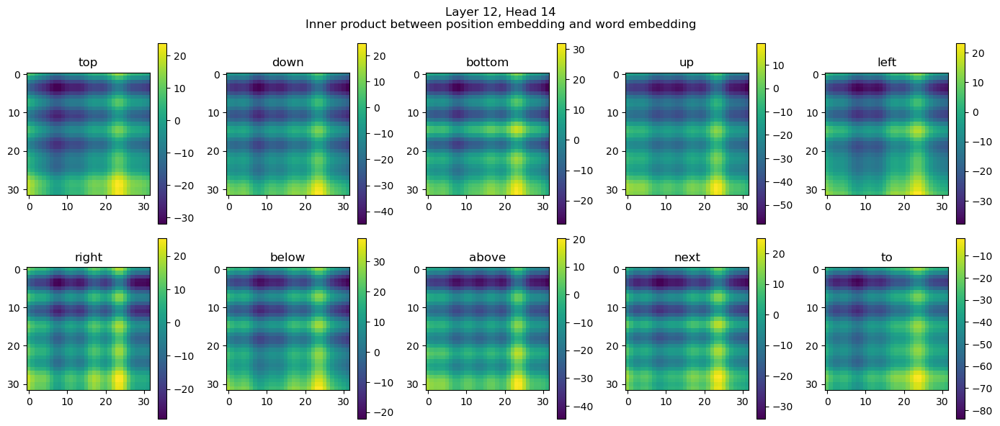

Layer 13, Head 14
Layer 13, Head 14 has max inner product 35.78125 | Padding inner product 24.75 Examine.


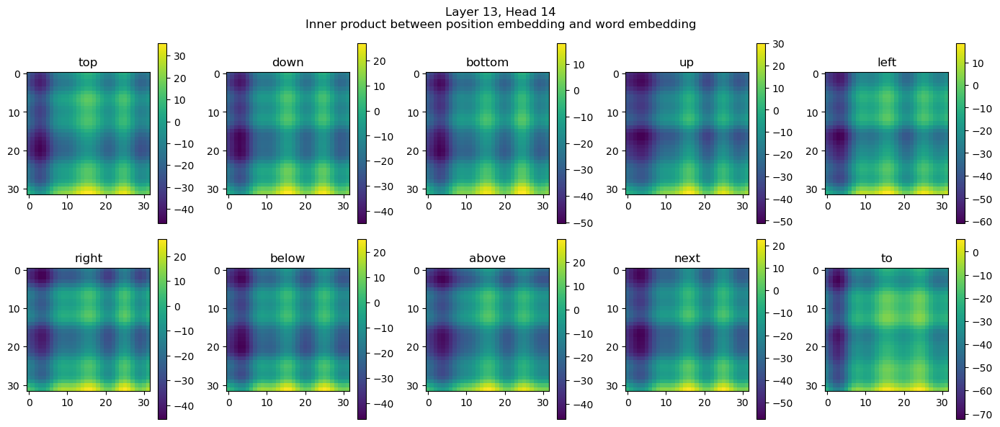

Layer 14, Head 14
Layer 15, Head 14
Layer 15, Head 14 has max inner product 11.7421875 | Padding inner product 9.75 Examine.


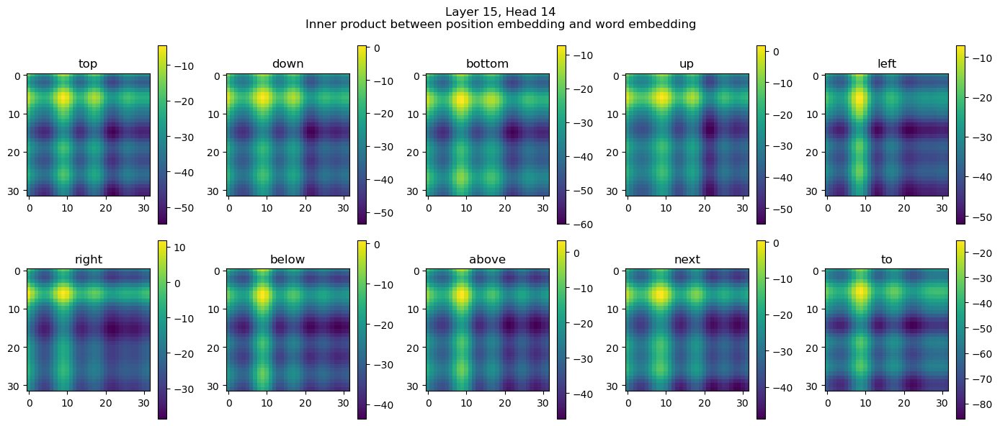

Layer 16, Head 14
Layer 17, Head 14
Layer 17, Head 14 has max inner product 129.75 | Padding inner product 137.0 Examine.


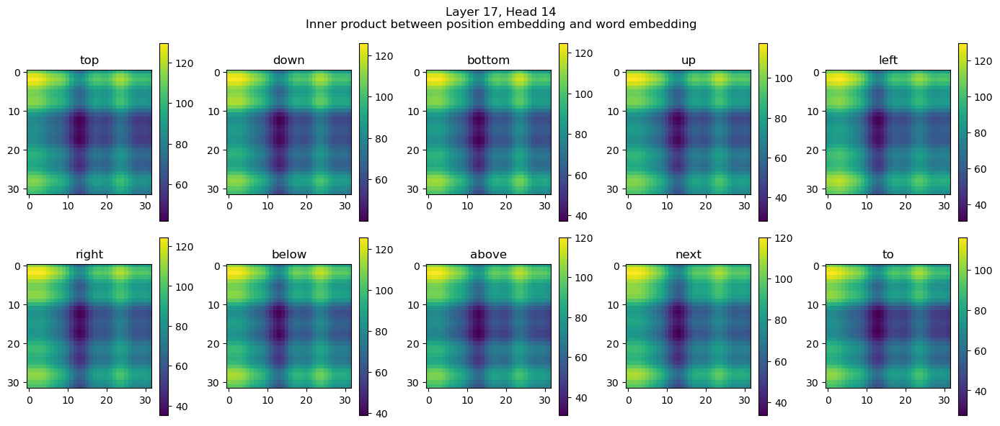

Layer 18, Head 14
Layer 18, Head 14 has max inner product 3170.0 | Padding inner product 3166.0 Examine.


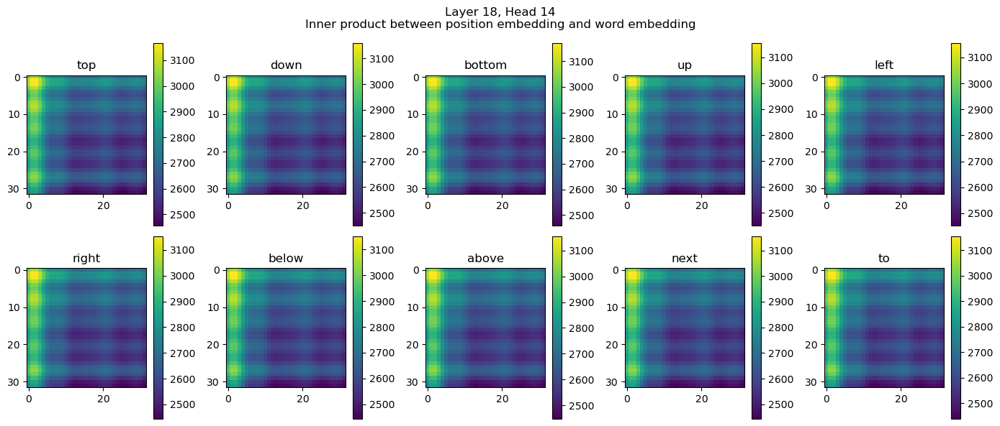

Layer 19, Head 14
Layer 19, Head 14 has max inner product 242.25 | Padding inner product 250.125 Examine.


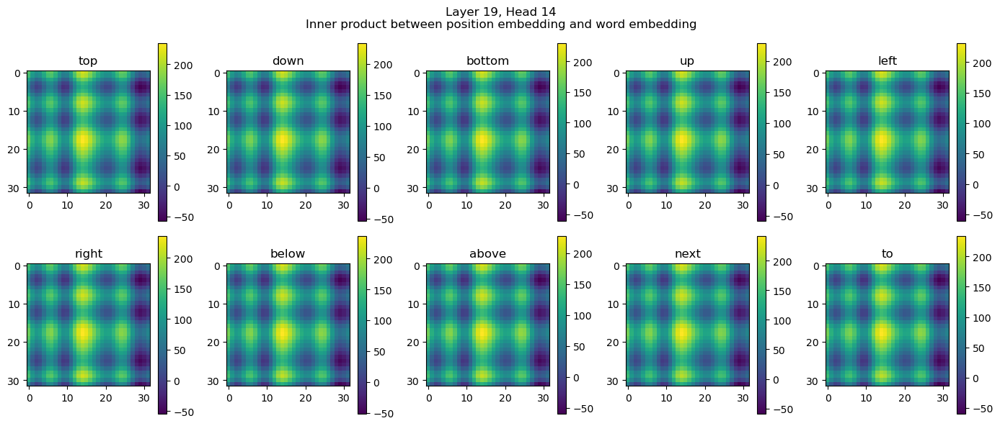

Layer 20, Head 14
Layer 20, Head 14 has max inner product 47.21875 | Padding inner product 53.875 Examine.


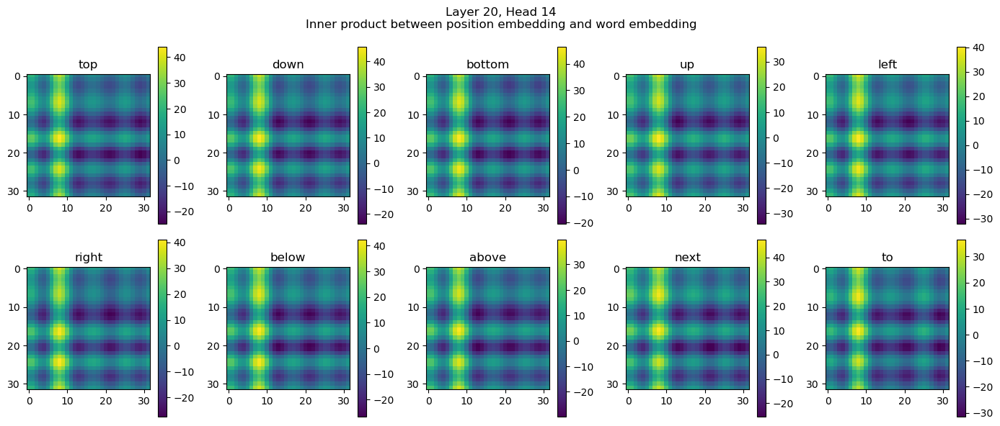

Layer 21, Head 14
Layer 21, Head 14 has max inner product 7036.0 | Padding inner product 7048.0 Examine.


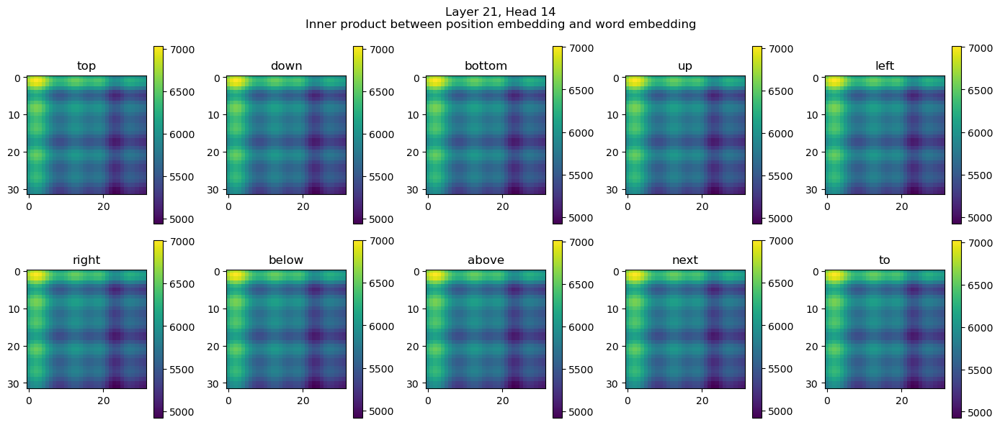

Layer 22, Head 14
Layer 23, Head 14
Layer 24, Head 14
Layer 24, Head 14 has max inner product 8288.0 | Padding inner product 8320.0 Examine.


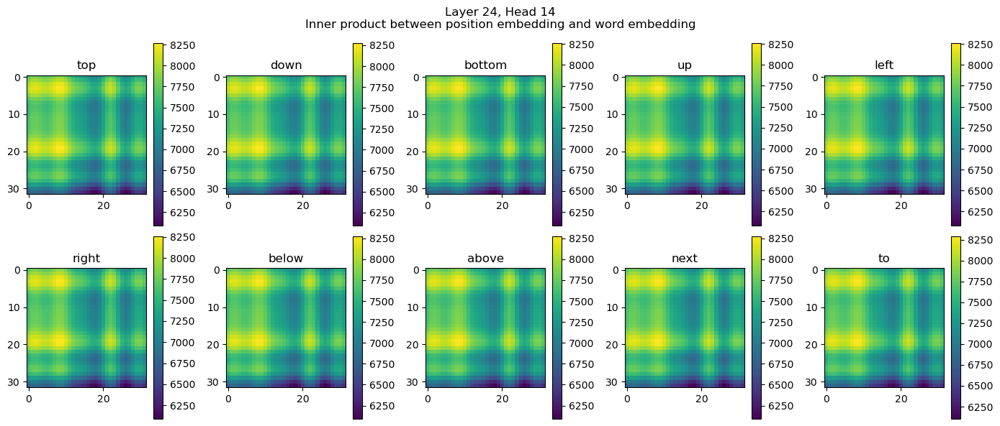

Layer 25, Head 14
Layer 25, Head 14 has max inner product 938.0 | Padding inner product 946.5 Examine.


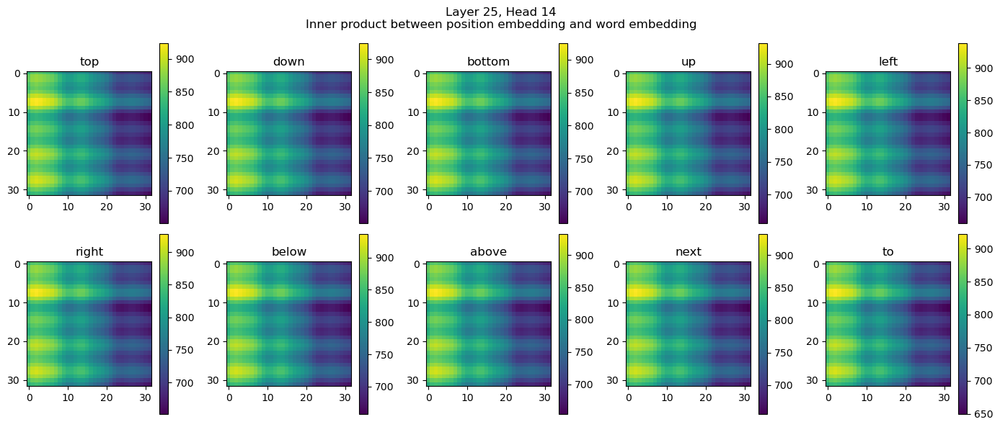

Layer 26, Head 14
Layer 26, Head 14 has max inner product 1453.0 | Padding inner product 1455.0 Examine.


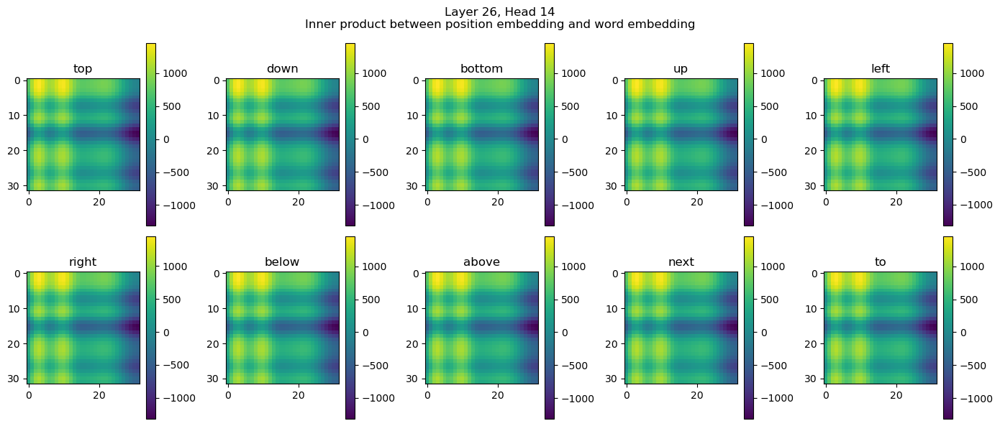

Layer 27, Head 14
Layer 0, Head 15
Layer 1, Head 15
Layer 2, Head 15
Layer 3, Head 15
Layer 4, Head 15
Layer 5, Head 15
Layer 6, Head 15
Layer 7, Head 15
Layer 8, Head 15
Layer 9, Head 15
Layer 10, Head 15
Layer 11, Head 15
Layer 12, Head 15
Layer 12, Head 15 has max inner product 21.53125 | Padding inner product 14.3046875 Examine.


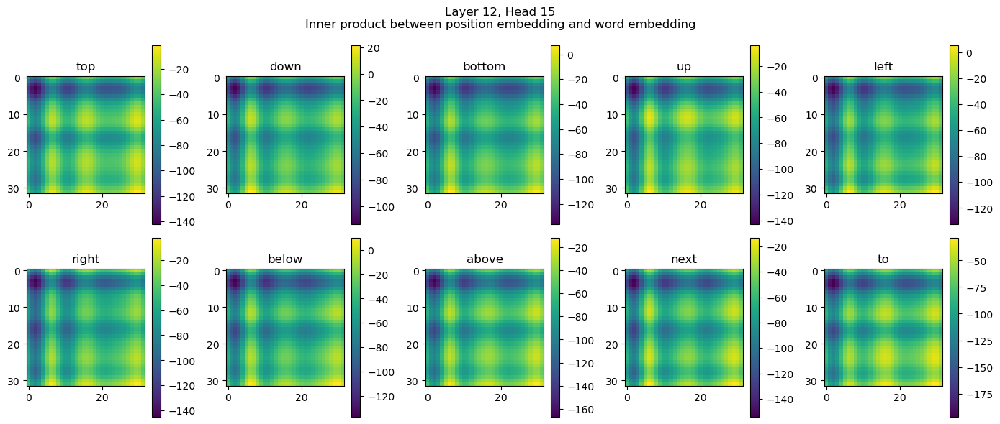

Layer 13, Head 15
Layer 14, Head 15
Layer 14, Head 15 has max inner product 93.5 | Padding inner product 91.125 Examine.


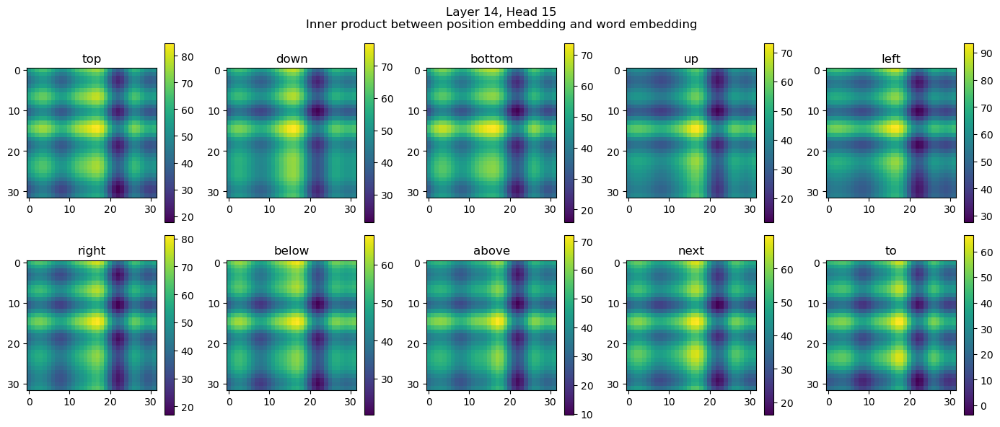

Layer 15, Head 15
Layer 16, Head 15
Layer 16, Head 15 has max inner product 12.765625 | Padding inner product 2.1640625 Examine.


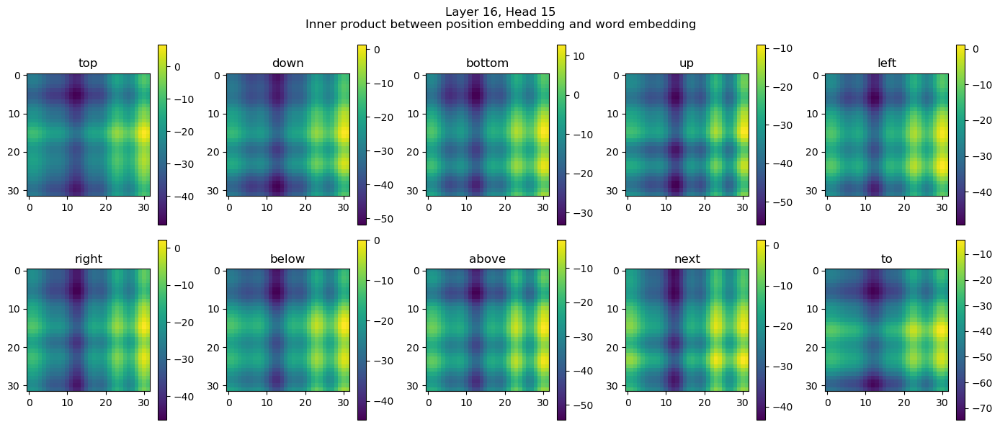

Layer 17, Head 15
Layer 17, Head 15 has max inner product 240.125 | Padding inner product 243.875 Examine.


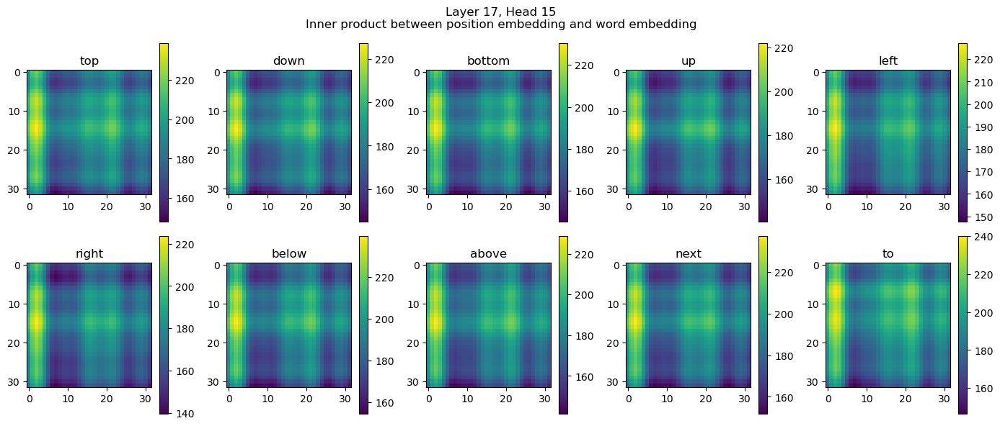

Layer 18, Head 15
Layer 19, Head 15
Layer 19, Head 15 has max inner product 59.65625 | Padding inner product 62.84375 Examine.


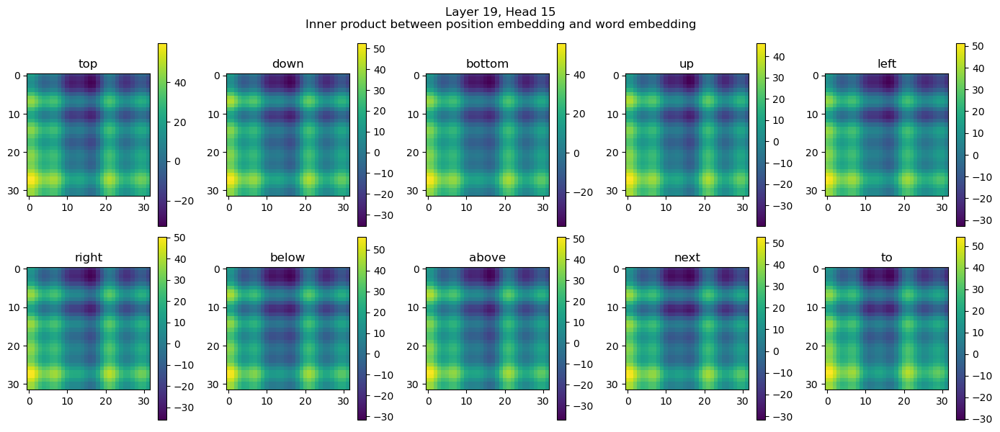

Layer 20, Head 15
Layer 20, Head 15 has max inner product 1642.0 | Padding inner product 1651.0 Examine.


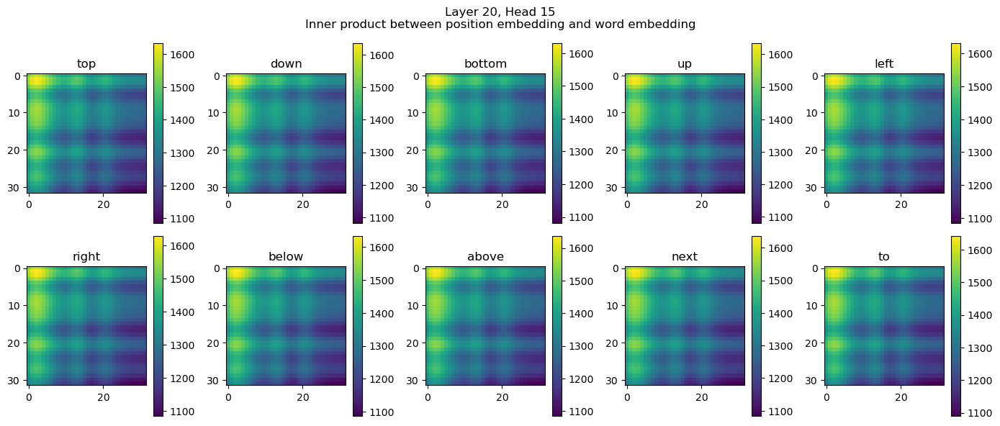

Layer 21, Head 15
Layer 22, Head 15
Layer 23, Head 15
Layer 23, Head 15 has max inner product 205.25 | Padding inner product 210.5 Examine.


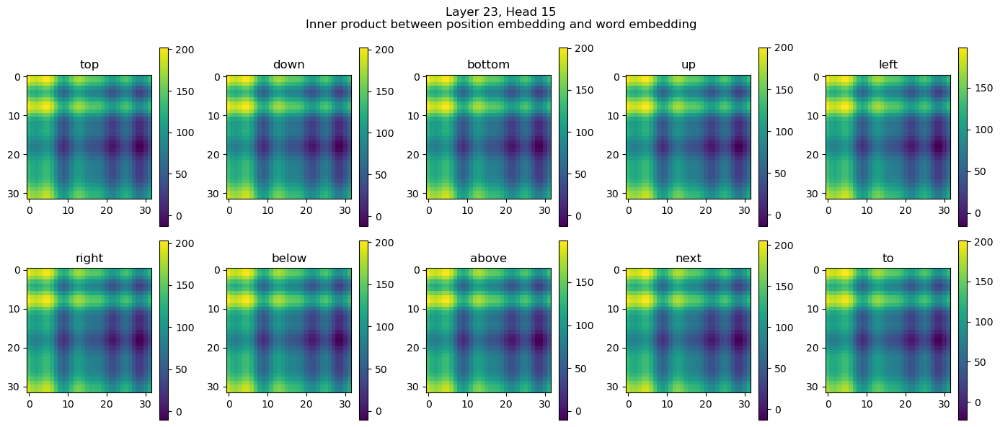

Layer 24, Head 15
Layer 25, Head 15
Layer 26, Head 15
Layer 27, Head 15


In [69]:
# define head screening 
hidden_size = 1152
base_size = 64 // 2
num_heads = 16
num_layers = 28
head_dim = hidden_size // num_heads
head_idx = 8
layer_idx = 10
    
device = "cuda"
prompt = "top down bottom up left right below above next to"
prompt_tokenized = prompt.split(" ")
token_ids = pipe.tokenizer.encode(" ".join(prompt_tokenized), max_length=30, truncation=False, return_tensors="pt").to(device)
with torch.no_grad():
    word_embeds = pipe.text_encoder(token_ids).last_hidden_state # , attn_mask
word_embeds_proj = pipe.transformer.caption_projection(word_embeds)
pos_embed = get_2d_sincos_pos_embed(hidden_size, (base_size, base_size), base_size=base_size)
pos_embed = torch.from_numpy(pos_embed).unsqueeze(0).half().to(device)

for head_idx in range(num_heads):
    for layer_idx in range(num_layers):
        print(f"Layer {layer_idx}, Head {head_idx}")
        word_embed_2k = pipe.transformer.transformer_blocks[layer_idx].attn2.to_k(word_embeds_proj)
        word_embed_2k_h8 = word_embed_2k[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
        word_embed_2v = pipe.transformer.transformer_blocks[layer_idx].attn2.to_v(word_embeds_proj)
        word_embed_2v_h8 = word_embed_2v[0, :, head_idx*head_dim:(head_idx+1)*head_dim]

        pos_embed_2q = pipe.transformer.transformer_blocks[layer_idx].attn2.to_q(pos_embed)
        pos_embed_2q_h8 = pos_embed_2q[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
        inner_prods = (pos_embed_2q_h8 @ word_embed_2k_h8.T).detach().cpu()
        padding_inner_prods_max = inner_prods[:, -1].max()
        if inner_prods[:, :-1].max() > 10:
            print(f"Layer {layer_idx}, Head {head_idx} has max inner product {inner_prods[:, :-1].max().item()} | Padding inner product {padding_inner_prods_max.item()} Examine.")
            figh, axs = plt.subplots(2, 5, figsize=(14, 6))
            axs = axs.flatten()
            for i_word in range(len(prompt_tokenized)):
                plt.sca(axs[i_word])
                inner_prod = inner_prods[:, i_word:i_word+1]
                plt.imshow(inner_prod.view(base_size, base_size).detach().cpu().numpy(), )
                plt.colorbar()
                plt.title(prompt_tokenized[i_word])
            plt.suptitle(f"Layer {layer_idx}, Head {head_idx}\nInner product between position embedding and word embedding")
            plt.tight_layout()
            plt.show()

In [60]:
inner_prods.shape

torch.Size([1024, 11])

In [64]:
inner_prods[:, :-1].max()

tensor(-8.3516, dtype=torch.float16)

In [63]:
inner_prods.max(dim=0)

torch.return_types.max(
values=tensor([-21.5000, -21.1562, -31.0000, -36.5938,  -8.3516, -30.1250, -25.7188,
        -37.8438, -17.8438, -48.7812,  15.0000], dtype=torch.float16),
indices=tensor([1006, 1007, 1007, 1000,  991,  991, 1007, 1023, 1007, 1006,   64]))

In [68]:
inner_prods[:, -1].max()

tensor(15., dtype=torch.float16)

### PixArt-B trained on objrel dataset

In [76]:
!ls /n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/PixArt/results/objrel2_DiT_B_pilot/checkpoints

epoch_1000_step_40000.pth  epoch_1600_step_64000.pth  epoch_450_step_18000.pth
epoch_100_step_4000.pth    epoch_1650_step_66000.pth  epoch_500_step_20000.pth
epoch_1050_step_42000.pth  epoch_1700_step_68000.pth  epoch_50_step_2000.pth
epoch_1100_step_44000.pth  epoch_1750_step_70000.pth  epoch_550_step_22000.pth
epoch_1150_step_46000.pth  epoch_1800_step_72000.pth  epoch_600_step_24000.pth
epoch_1200_step_48000.pth  epoch_1850_step_74000.pth  epoch_650_step_26000.pth
epoch_1250_step_50000.pth  epoch_1900_step_76000.pth  epoch_700_step_28000.pth
epoch_1300_step_52000.pth  epoch_1950_step_78000.pth  epoch_750_step_30000.pth
epoch_1350_step_54000.pth  epoch_2000_step_80000.pth  epoch_800_step_32000.pth
epoch_1400_step_56000.pth  epoch_200_step_8000.pth    epoch_850_step_34000.pth
epoch_1450_step_58000.pth  epoch_250_step_10000.pth   epoch_900_step_36000.pth
epoch_1500_step_60000.pth  epoch_300_step_12000.pth   epoch_950_step_38000.pth
epoch_150_step_6000.pth    epoch_350_step_14000.pth
ep

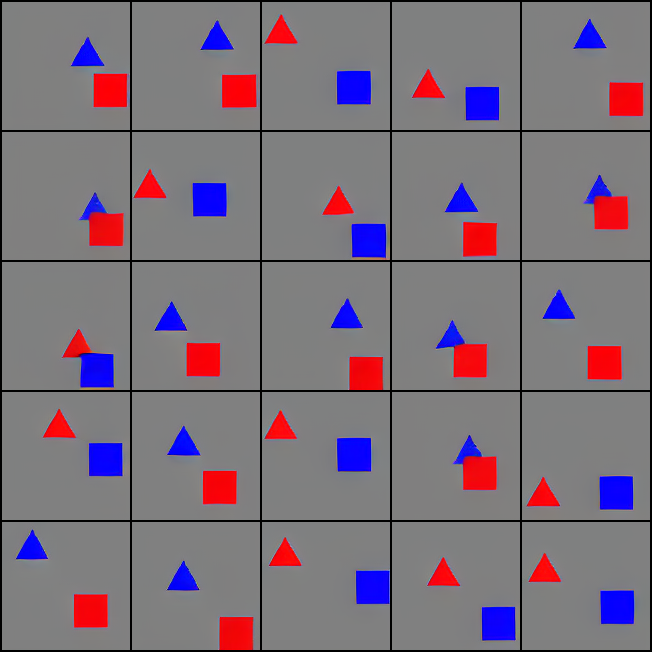

In [74]:
from PIL import Image
Image.open("/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/PixArt/results/objrel2_DiT_B_pilot/samples/step_80000_sample_triangle_is_to_the_upper_left_of_square.png")

In [78]:
savedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/PixArt/results/objrel2_DiT_B_pilot"

from transformers import T5Tokenizer, T5EncoderModel
T5_path = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/DL_Projects/PixArt/output/pretrained_models/t5_ckpts/t5-v1_1-xxl"
tokenizer = T5Tokenizer.from_pretrained(T5_path, )#subfolder="tokenizer")
text_encoder = T5EncoderModel.from_pretrained(T5_path, load_in_8bit=False, torch_dtype=torch.float16, )

config = read_config(join(savedir, 'config.py'))

weight_dtype = torch.float32
if config.mixed_precision == "fp16": # accelerator.
    weight_dtype = torch.float16
elif config.mixed_precision == "bf16": # accelerator.
    weight_dtype = torch.bfloat16
    
image_size = config.image_size  # @param [256, 512, 1024]
latent_size = int(image_size) // 8
pred_sigma = getattr(config, 'pred_sigma', True)
learn_sigma = getattr(config, 'learn_sigma', True) and pred_sigma
model_kwargs={"window_block_indexes": config.window_block_indexes, "window_size": config.window_size,
                "use_rel_pos": config.use_rel_pos, "lewei_scale": config.lewei_scale, 'config':config,
                'model_max_length': config.model_max_length}
# train_diffusion = IDDPM(str(config.train_sampling_steps), learn_sigma=learn_sigma, pred_sigma=pred_sigma, snr=config.snr_loss)
model = build_model(config.model,
                config.grad_checkpointing,
                config.get('fp32_attention', False),
                input_size=latent_size,
                learn_sigma=learn_sigma,
                pred_sigma=pred_sigma,
                **model_kwargs).train()

transformer = Transformer2DModel(
        sample_size=image_size // 8,
        num_layers=len(model.blocks),
        attention_head_dim=model.blocks[0].hidden_size // model.num_heads,
        in_channels=model.in_channels,
        out_channels=model.out_channels,
        patch_size=model.patch_size,
        attention_bias=True,
        num_attention_heads=model.num_heads,
        cross_attention_dim=model.blocks[0].hidden_size,
        activation_fn="gelu-approximate",
        num_embeds_ada_norm=1000,
        norm_type="ada_norm_single",
        norm_elementwise_affine=False,
        norm_eps=1e-6,
        caption_channels=4096,
)
# state_dict = state_dict_convert(all_state_dict.pop("state_dict"))
transformer.load_state_dict(state_dict_convert(model.state_dict()))
pipeline = PixArtAlphaPipeline_custom.from_pretrained(
    "PixArt-alpha/PixArt-XL-2-512x512",
    transformer=transformer,
    tokenizer=tokenizer,
    text_encoder=text_encoder,
    torch_dtype=weight_dtype,
)

/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

2025-07-16 01:37:57,622 - PixArt - WARNING - lewei scale: (1.0,), base size: 8


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
ckptdir = join(savedir, "checkpoints")
ckpt = torch.load(join(ckptdir, "epoch_2000_step_80000.pth"))
pipeline.transformer.load_state_dict(state_dict_convert(ckpt['state_dict_ema']))
pipeline.to(device="cuda", dtype=weight_dtype);

/tmp/ipykernel_485270/3224608532.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(join(ckptdir, "epoch_2000_step_80000.pth"))


<All keys matched successfully>

In [92]:
prompt = "red square is below and to the right of the blue circle"
output = pipeline(prompt, 
        num_inference_steps=14,
        max_sequence_length=20, 
        num_images_per_prompt=16,
        return_sample_pred_traj=True,
        device="cuda")

torch.Size([32, 20, 4096])
torch.Size([32, 20])


  0%|          | 0/14 [00:00<?, ?it/s]

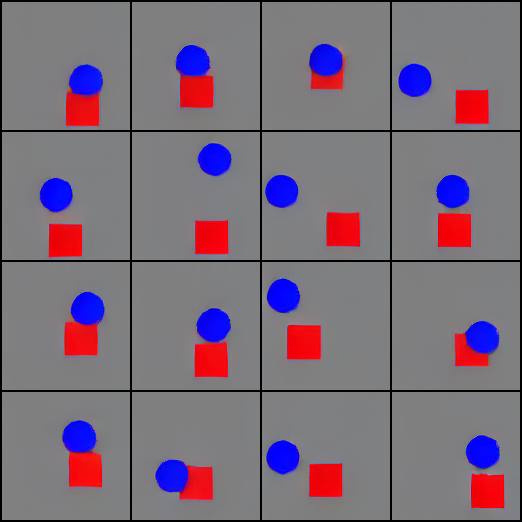

In [93]:
pred_traj, latents_traj, t_traj = output[1], output[2], output[3]
display(pil_images_to_grid(output[0].images))

In [94]:
pipeline.transformer.config

FrozenDict([('num_attention_heads', 12),
            ('attention_head_dim', 64),
            ('in_channels', 4),
            ('out_channels', 8),
            ('num_layers', 12),
            ('dropout', 0.0),
            ('norm_num_groups', 32),
            ('cross_attention_dim', 768),
            ('attention_bias', True),
            ('sample_size', 16),
            ('num_vector_embeds', None),
            ('patch_size', 2),
            ('activation_fn', 'gelu-approximate'),
            ('num_embeds_ada_norm', 1000),
            ('use_linear_projection', False),
            ('only_cross_attention', False),
            ('double_self_attention', False),
            ('upcast_attention', False),
            ('norm_type', 'ada_norm_single'),
            ('norm_elementwise_affine', False),
            ('norm_eps', 1e-06),
            ('attention_type', 'default'),
            ('caption_channels', 4096),
            ('interpolation_scale', None),
            ('use_additional_conditions', Non

In [95]:
pipeline.transformer.config["num_attention_heads"]

12

Layer 0, Head 0
Layer 0, Head 1
Layer 0, Head 2
Layer 0, Head 3
Layer 0, Head 4
Layer 0, Head 5
Layer 0, Head 6
Layer 0, Head 7
Layer 0, Head 8
Layer 0, Head 9
Layer 0, Head 10
Layer 0, Head 11
Layer 1, Head 0
Layer 1, Head 1
Layer 1, Head 2
Layer 1, Head 3
Layer 1, Head 4
Layer 1, Head 5
Layer 1, Head 6
Layer 1, Head 7
Layer 1, Head 8
Layer 1, Head 9
Layer 1, Head 10
Layer 1, Head 11
Layer 2, Head 0
Layer 2, Head 1
Layer 2, Head 1 has max inner product 16.53125 | Padding inner product -7.20703125 Examine.


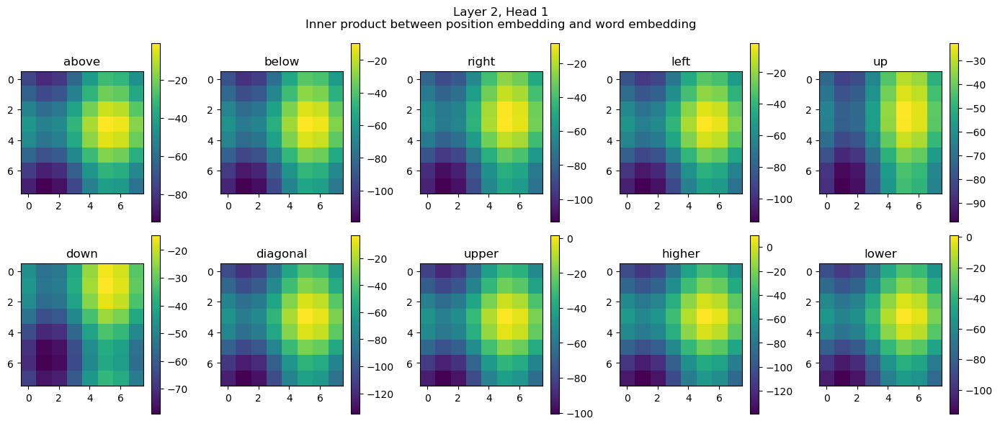

Layer 2, Head 2
Layer 2, Head 3
Layer 2, Head 3 has max inner product 33.84375 | Padding inner product 22.21875 Examine.


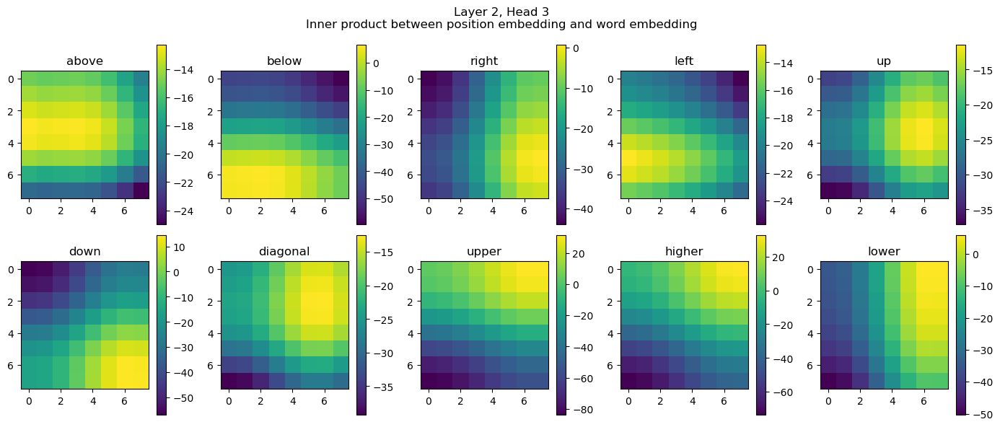

Layer 2, Head 4
Layer 2, Head 5
Layer 2, Head 6
Layer 2, Head 7
Layer 2, Head 8
Layer 2, Head 9
Layer 2, Head 10
Layer 2, Head 11
Layer 3, Head 0
Layer 3, Head 1
Layer 3, Head 2
Layer 3, Head 3
Layer 3, Head 4
Layer 3, Head 5
Layer 3, Head 6
Layer 3, Head 7
Layer 3, Head 8
Layer 3, Head 9
Layer 3, Head 10
Layer 3, Head 11
Layer 4, Head 0
Layer 4, Head 1
Layer 4, Head 2
Layer 4, Head 3
Layer 4, Head 4
Layer 4, Head 4 has max inner product 18.296875 | Padding inner product 13.984375 Examine.


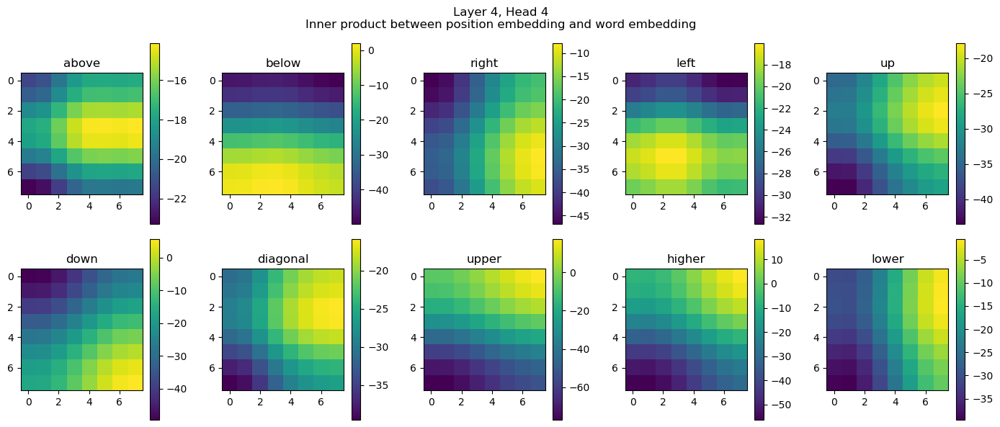

Layer 4, Head 5
Layer 4, Head 6
Layer 4, Head 7
Layer 4, Head 8
Layer 4, Head 8 has max inner product 35.375 | Padding inner product 7.765625 Examine.


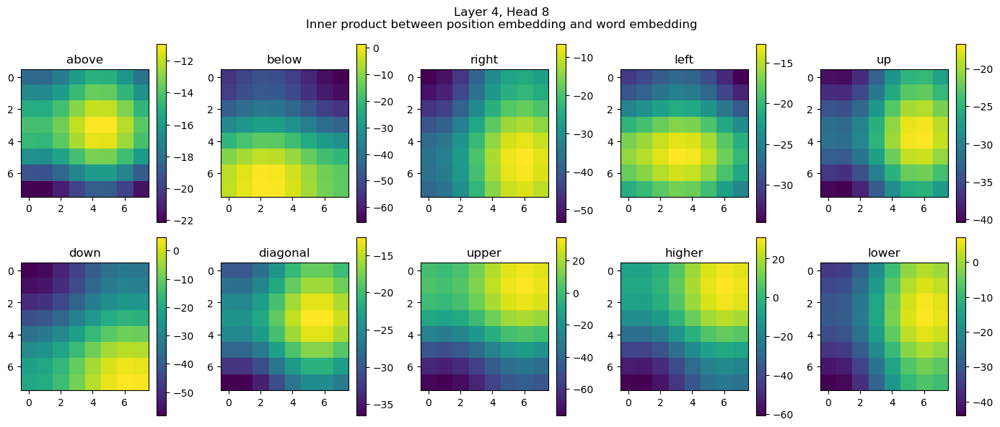

Layer 4, Head 9
Layer 4, Head 10
Layer 4, Head 11
Layer 5, Head 0
Layer 5, Head 1
Layer 5, Head 2
Layer 5, Head 2 has max inner product 20.75 | Padding inner product 8.5234375 Examine.


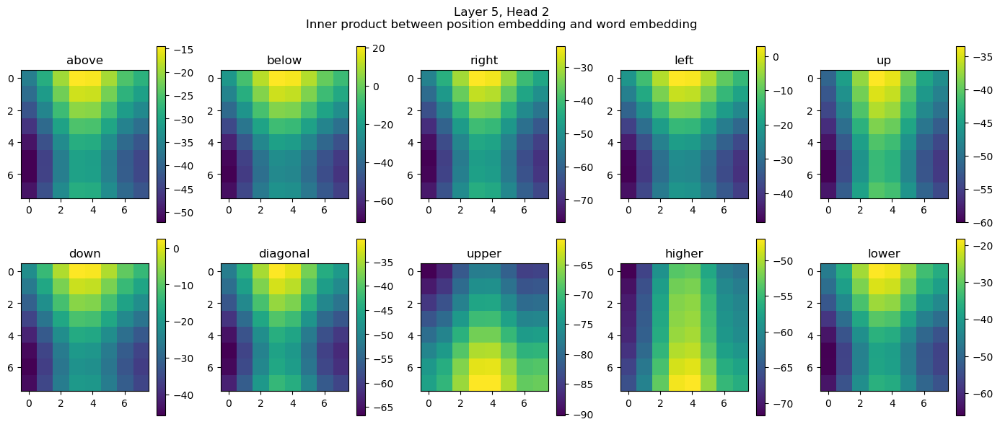

Layer 5, Head 3
Layer 5, Head 4
Layer 5, Head 5
Layer 5, Head 5 has max inner product 17.625 | Padding inner product 17.40625 Examine.


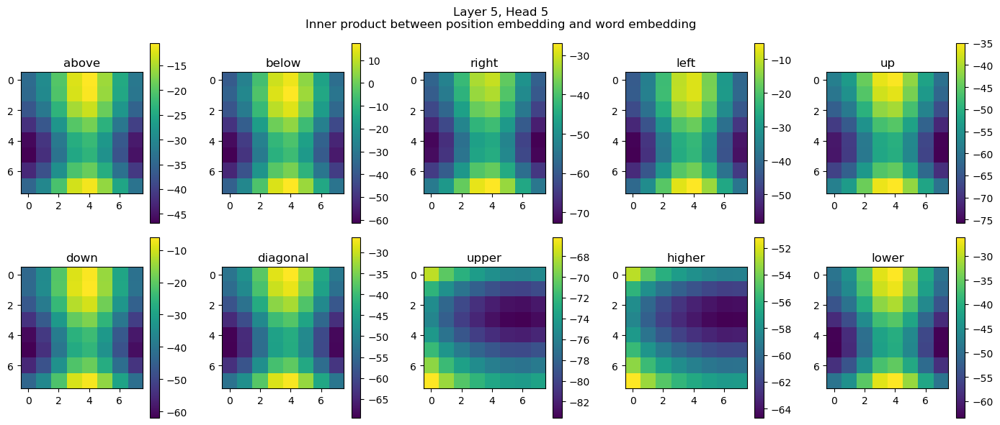

Layer 5, Head 6
Layer 5, Head 6 has max inner product 41.40625 | Padding inner product 6.40234375 Examine.


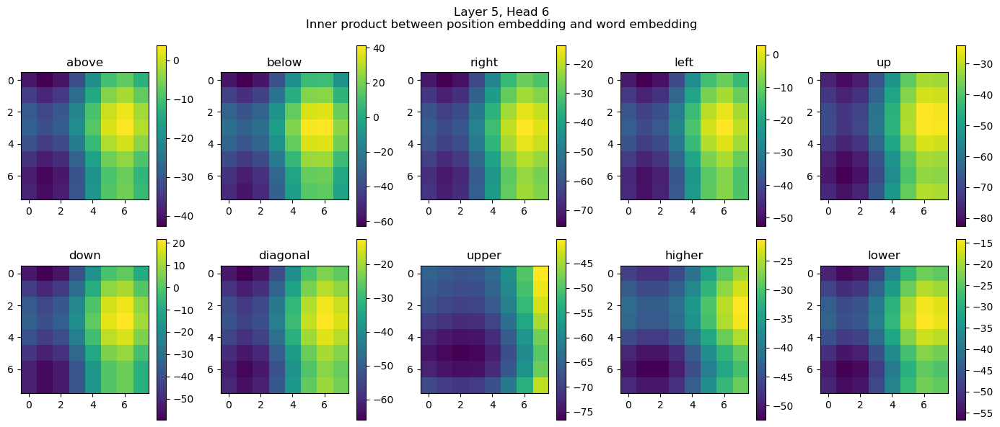

Layer 5, Head 7
Layer 5, Head 8
Layer 5, Head 8 has max inner product 25.1875 | Padding inner product -10.359375 Examine.


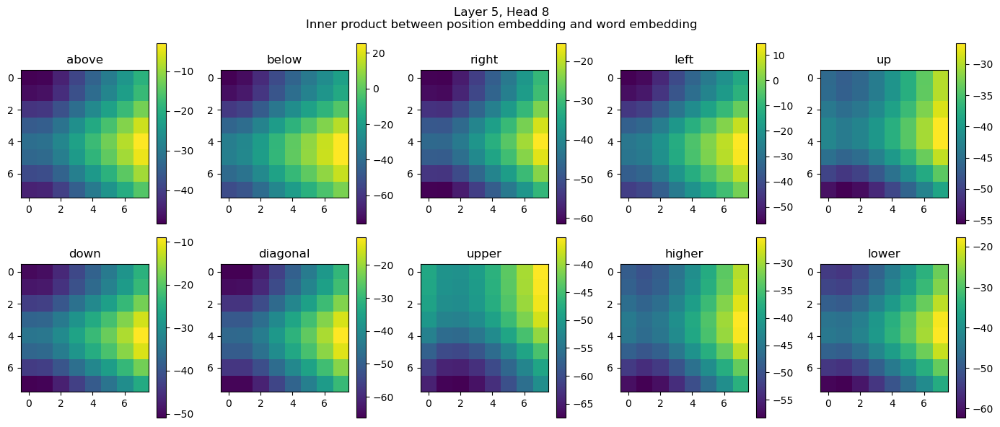

Layer 5, Head 9
Layer 5, Head 9 has max inner product 23.609375 | Padding inner product -0.05670166015625 Examine.


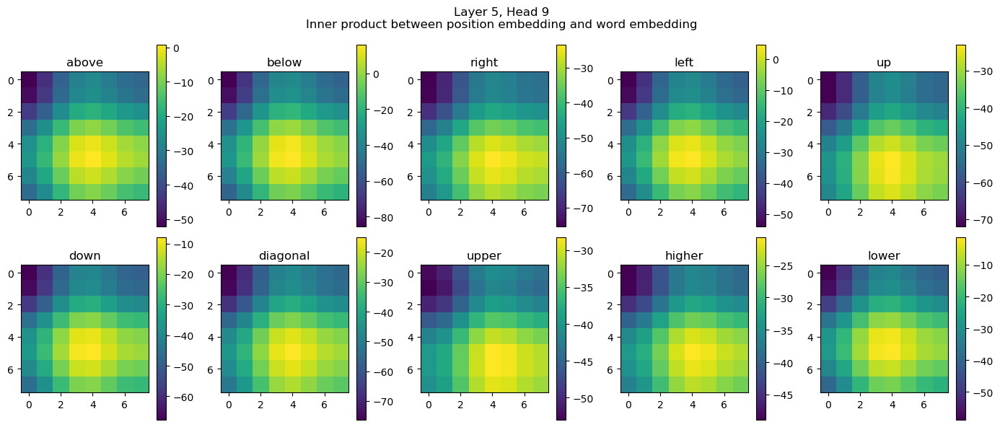

Layer 5, Head 10
Layer 5, Head 11
Layer 5, Head 11 has max inner product 13.6015625 | Padding inner product 3.58984375 Examine.


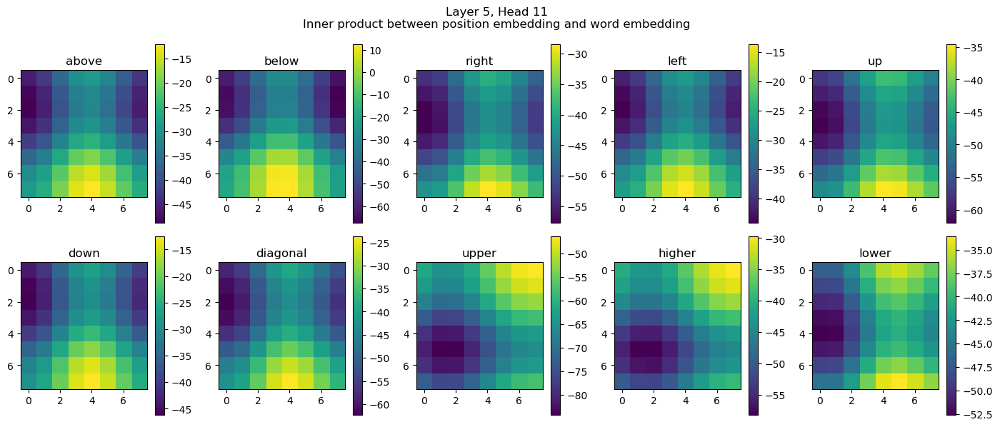

Layer 6, Head 0
Layer 6, Head 1
Layer 6, Head 2
Layer 6, Head 2 has max inner product 20.3125 | Padding inner product 19.390625 Examine.


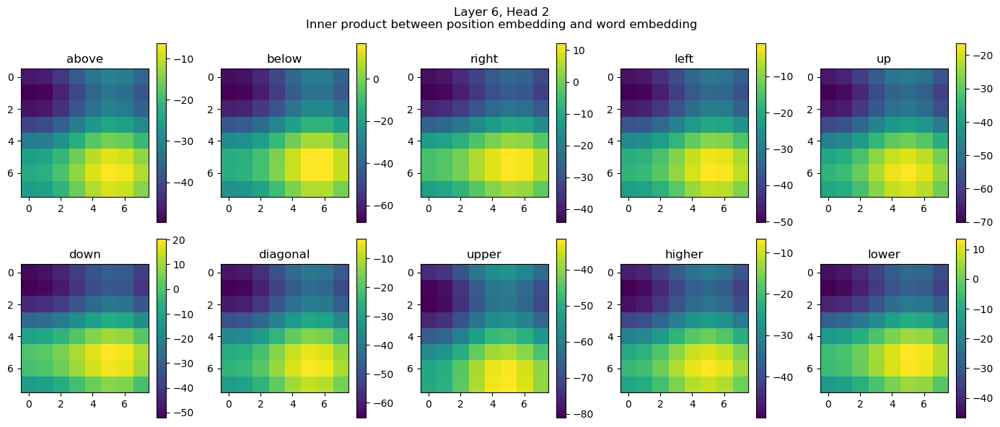

Layer 6, Head 3
Layer 6, Head 4
Layer 6, Head 4 has max inner product 11.8046875 | Padding inner product 5.890625 Examine.


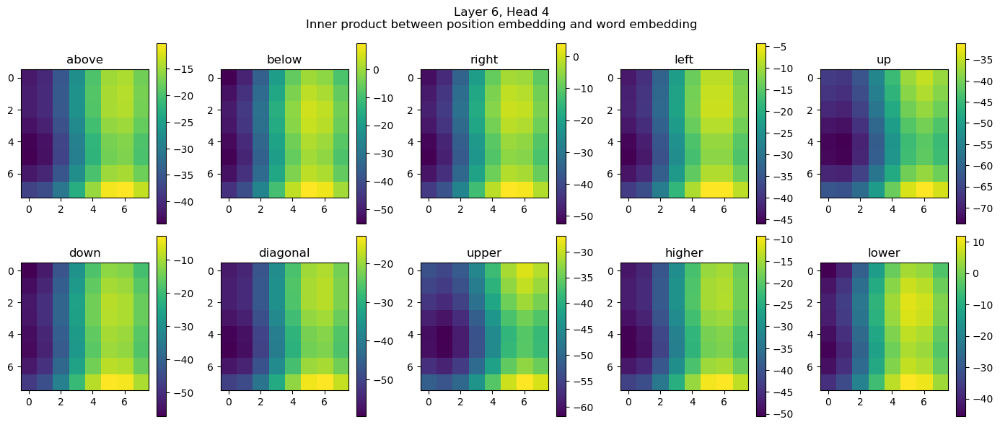

Layer 6, Head 5
Layer 6, Head 6
Layer 6, Head 7
Layer 6, Head 8
Layer 6, Head 9
Layer 6, Head 10
Layer 6, Head 11
Layer 7, Head 0
Layer 7, Head 1
Layer 7, Head 2
Layer 7, Head 3
Layer 7, Head 4
Layer 7, Head 5
Layer 7, Head 6
Layer 7, Head 7
Layer 7, Head 8
Layer 7, Head 8 has max inner product 20.171875 | Padding inner product -12.8515625 Examine.


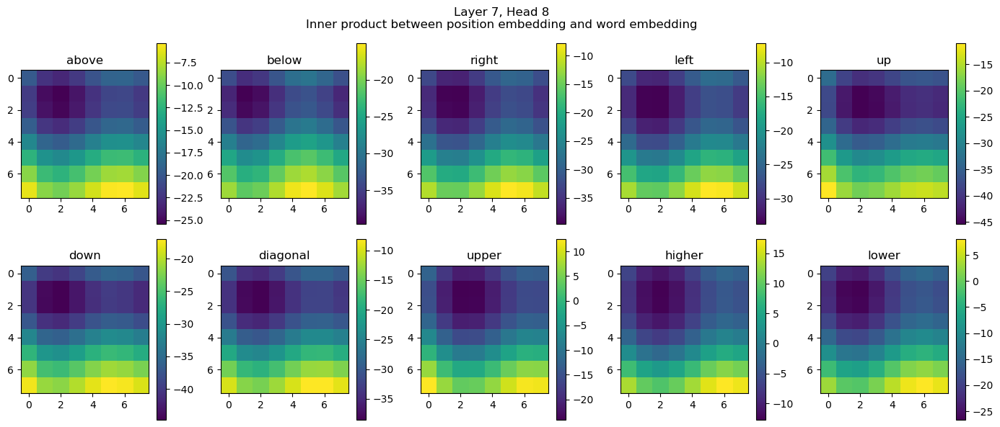

Layer 7, Head 9
Layer 7, Head 9 has max inner product 13.7578125 | Padding inner product -22.109375 Examine.


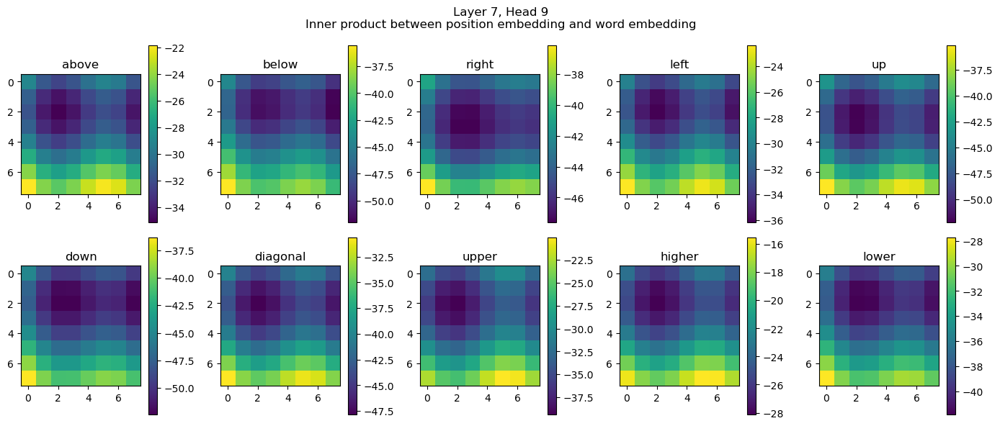

Layer 7, Head 10
Layer 7, Head 10 has max inner product 13.5078125 | Padding inner product 3.984375 Examine.


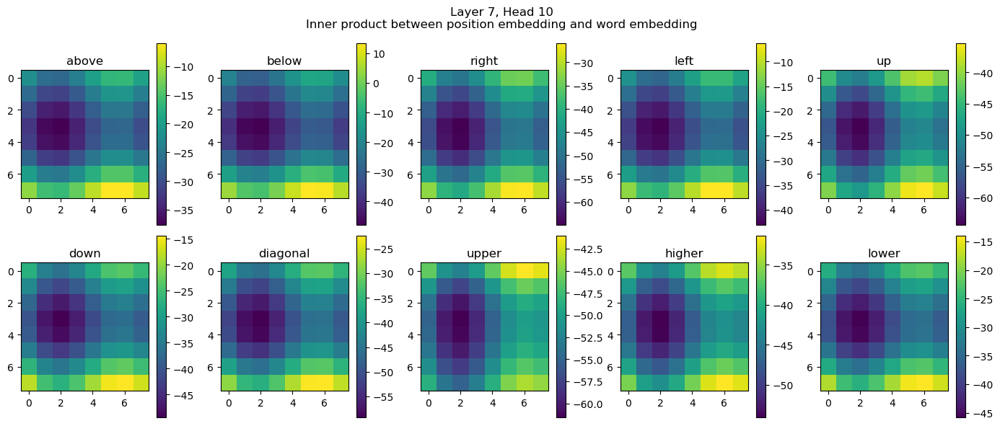

Layer 7, Head 11
Layer 7, Head 11 has max inner product 25.265625 | Padding inner product -19.546875 Examine.


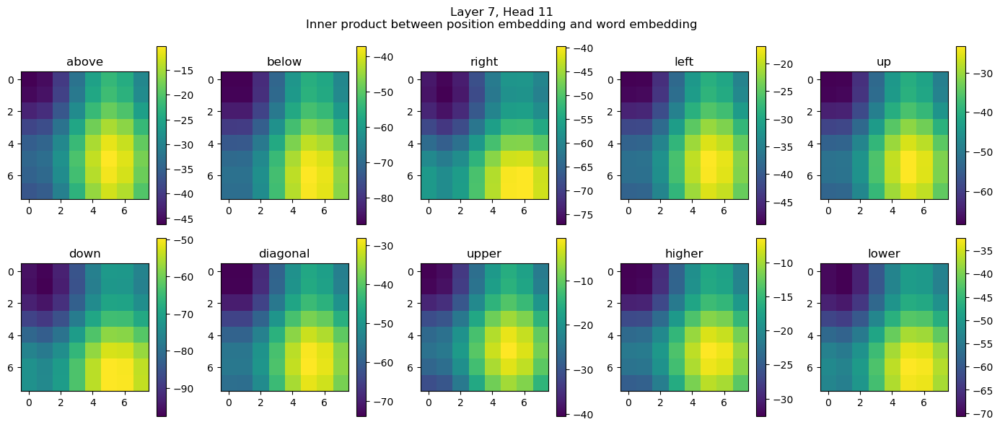

Layer 8, Head 0
Layer 8, Head 1
Layer 8, Head 2
Layer 8, Head 3
Layer 8, Head 4
Layer 8, Head 5
Layer 8, Head 6
Layer 8, Head 7
Layer 8, Head 8
Layer 8, Head 8 has max inner product 14.2109375 | Padding inner product -21.71875 Examine.


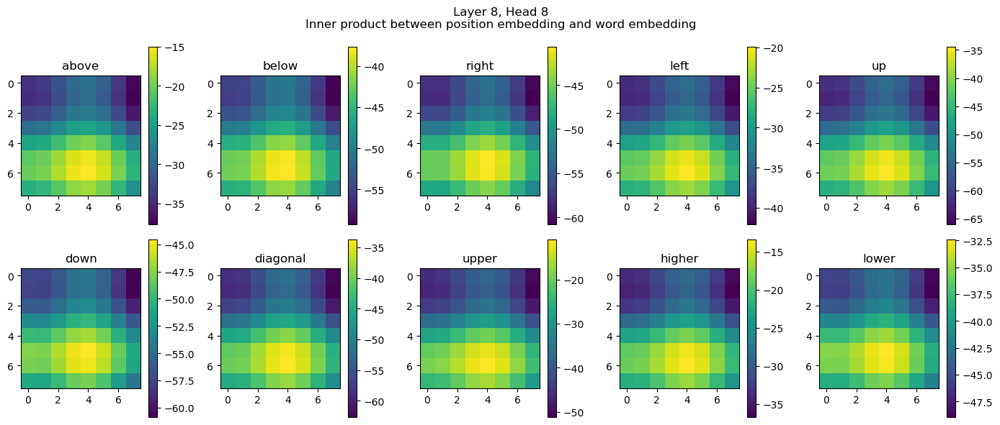

Layer 8, Head 9
Layer 8, Head 10
Layer 8, Head 11
Layer 9, Head 0
Layer 9, Head 1
Layer 9, Head 2
Layer 9, Head 3
Layer 9, Head 4
Layer 9, Head 5
Layer 9, Head 6
Layer 9, Head 7
Layer 9, Head 8
Layer 9, Head 9
Layer 9, Head 10
Layer 9, Head 11
Layer 10, Head 0
Layer 10, Head 1
Layer 10, Head 2
Layer 10, Head 3
Layer 10, Head 4
Layer 10, Head 5
Layer 10, Head 6
Layer 10, Head 7
Layer 10, Head 8
Layer 10, Head 9
Layer 10, Head 10
Layer 10, Head 11
Layer 11, Head 0
Layer 11, Head 1
Layer 11, Head 2
Layer 11, Head 3
Layer 11, Head 4
Layer 11, Head 5
Layer 11, Head 6
Layer 11, Head 7
Layer 11, Head 8
Layer 11, Head 9
Layer 11, Head 10
Layer 11, Head 11


In [100]:
# define head screening 
hidden_size = pipeline.transformer.config["cross_attention_dim"]
base_size = 8
num_heads = pipeline.transformer.config["num_attention_heads"]
num_layers = pipeline.transformer.config["num_layers"]
head_dim = hidden_size // num_heads
head_idx = 8
layer_idx = 2
    
device = "cuda"
# prompt = "top down bottom up left right below above next to"
prompt_tokenized = ["above", "below", "right", "left", "up", "down", "diagonal", "upper", "higher", "lower", "directly", "from",]
# prompt_tokenized = prompt.split(" ")
token_ids = pipeline.tokenizer.encode(" ".join(prompt_tokenized), max_length=30, truncation=False, return_tensors="pt").to(device)
with torch.no_grad():
    word_embeds = pipeline.text_encoder(token_ids).last_hidden_state # , attn_mask
word_embeds_proj = pipeline.transformer.caption_projection(word_embeds)
pos_embed = get_2d_sincos_pos_embed(hidden_size, (base_size, base_size), base_size=base_size)
pos_embed = torch.from_numpy(pos_embed).unsqueeze(0).half().to(device)

for layer_idx in range(num_layers):
    for head_idx in range(num_heads):   
        print(f"Layer {layer_idx}, Head {head_idx}")
        word_embed_2k = pipeline.transformer.transformer_blocks[layer_idx].attn2.to_k(word_embeds_proj)
        word_embed_2k_h8 = word_embed_2k[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
        word_embed_2v = pipeline.transformer.transformer_blocks[layer_idx].attn2.to_v(word_embeds_proj)
        word_embed_2v_h8 = word_embed_2v[0, :, head_idx*head_dim:(head_idx+1)*head_dim]

        pos_embed_2q = pipeline.transformer.transformer_blocks[layer_idx].attn2.to_q(pos_embed)
        pos_embed_2q_h8 = pos_embed_2q[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
        inner_prods = (pos_embed_2q_h8 @ word_embed_2k_h8.T).detach().cpu()
        padding_inner_prods_max = inner_prods[:, -1].max()
        if inner_prods[:, :-1].max() > 10:
            print(f"Layer {layer_idx}, Head {head_idx} has max inner product {inner_prods[:, :-1].max().item()} | Padding inner product {padding_inner_prods_max.item()} Examine.")
            figh, axs = plt.subplots(2, 5, figsize=(14, 6))
            axs = axs.flatten()
            for i_word in range(min(len(prompt_tokenized), 10)):
                plt.sca(axs[i_word])
                inner_prod = inner_prods[:, i_word:i_word+1]
                plt.imshow(inner_prod.view(base_size, base_size).detach().cpu().numpy(), )
                plt.colorbar()
                plt.title(prompt_tokenized[i_word])
            plt.suptitle(f"Layer {layer_idx}, Head {head_idx}\nInner product between position embedding and word embedding")
            plt.tight_layout()
            plt.show()

Layer 0, Head 0
Layer 0, Head 0 has min correlation -0.33447265625 | Max inner product -33.125 Examine.


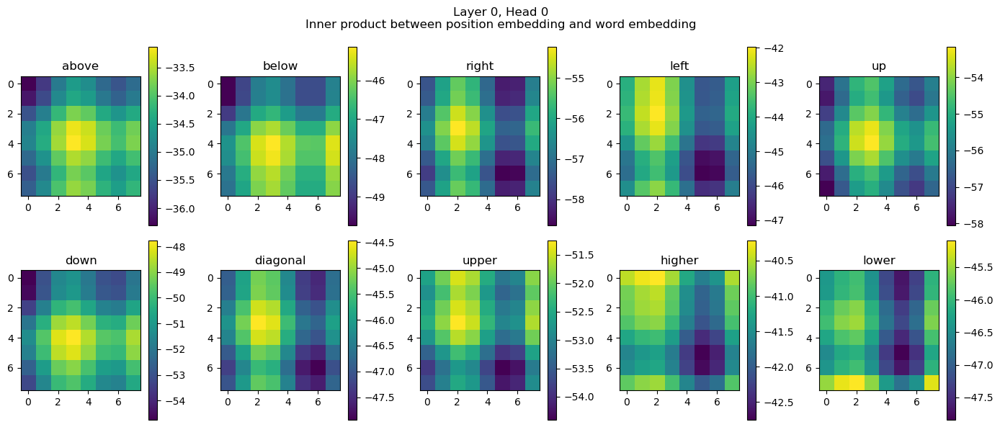

Layer 0, Head 1
Layer 0, Head 1 has min correlation 0.03607177734375 | Max inner product -26.234375 Examine.


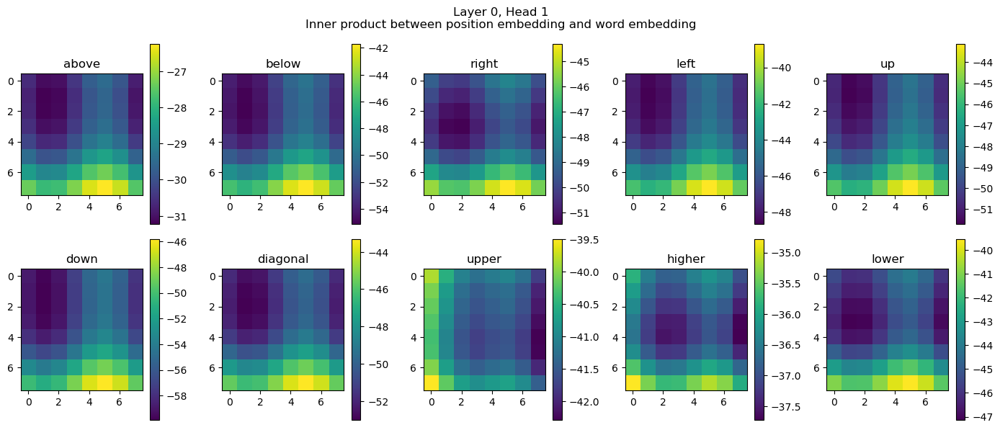

Layer 0, Head 2
Layer 0, Head 2 has min correlation -0.515625 | Max inner product -28.09375 Examine.


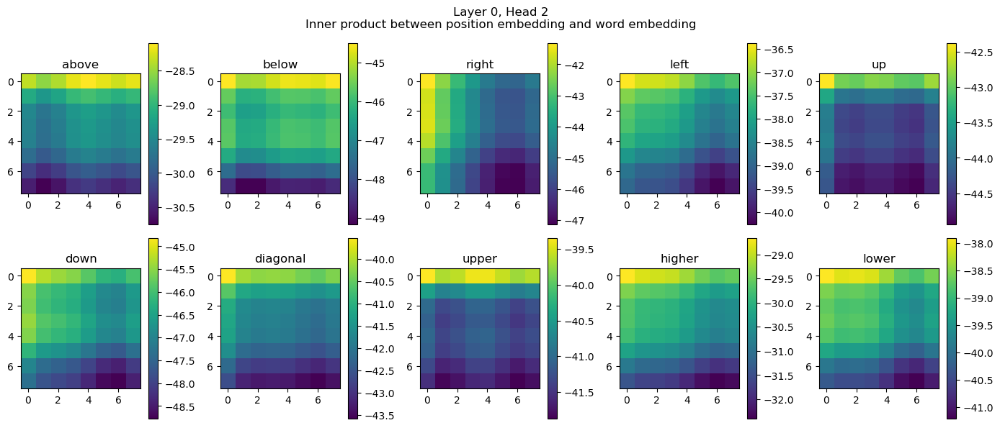

Layer 0, Head 3
Layer 0, Head 3 has min correlation 0.373291015625 | Max inner product -38.84375 Examine.


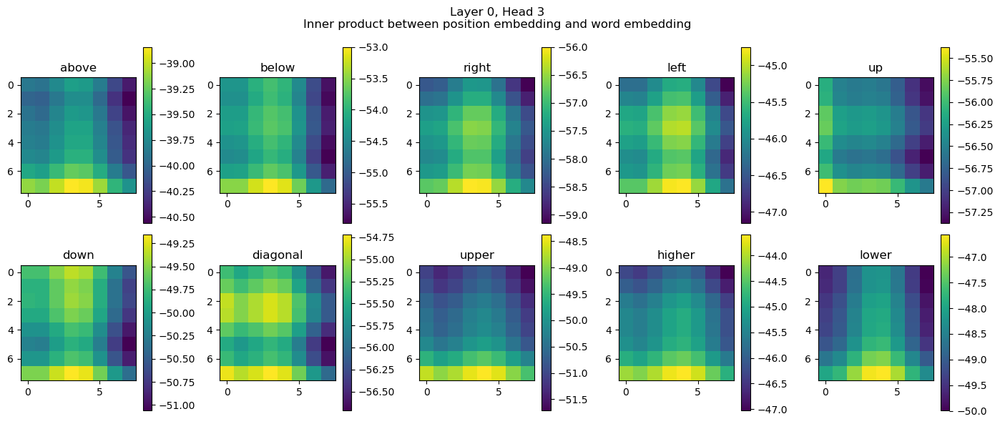

Layer 0, Head 4
Layer 0, Head 4 has min correlation -0.708984375 | Max inner product -26.859375 Examine.


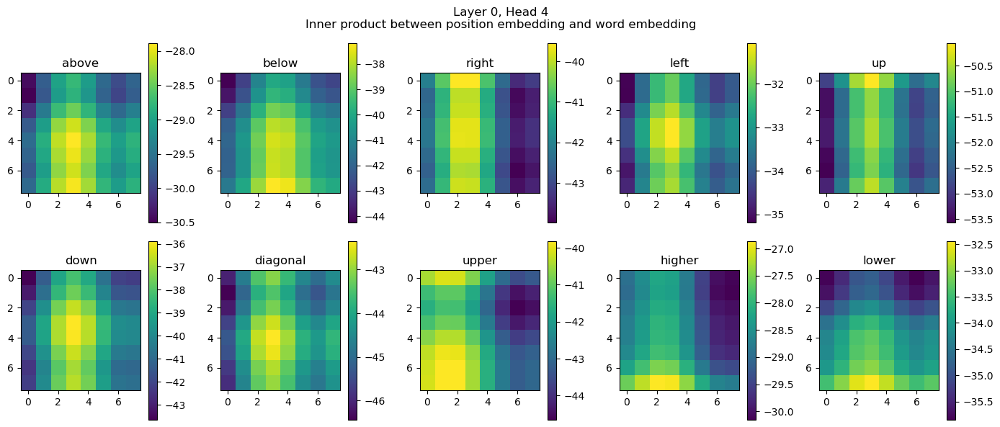

Layer 0, Head 5
Layer 0, Head 6
Layer 0, Head 7
Layer 0, Head 7 has min correlation -0.392822265625 | Max inner product -37.53125 Examine.


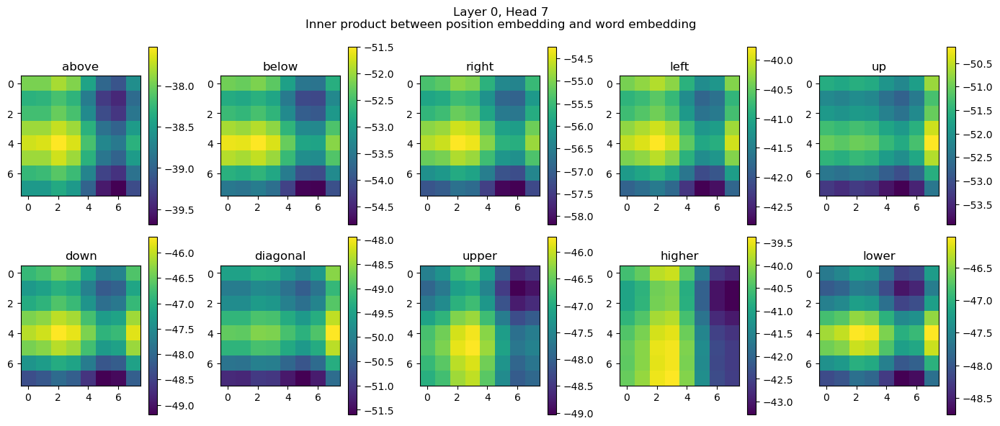

Layer 0, Head 8
Layer 0, Head 8 has min correlation -0.52099609375 | Max inner product -31.734375 Examine.


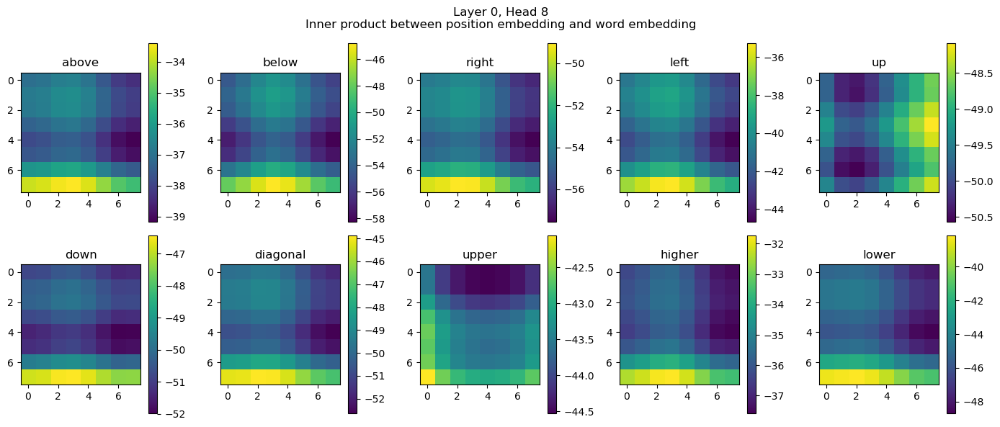

Layer 0, Head 9
Layer 0, Head 9 has min correlation -0.6708984375 | Max inner product -31.203125 Examine.


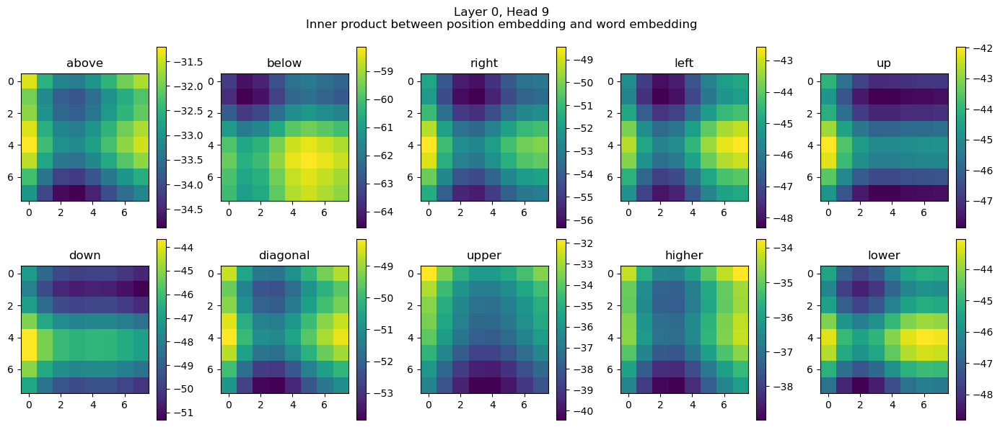

Layer 0, Head 10
Layer 0, Head 10 has min correlation 0.0933837890625 | Max inner product -35.90625 Examine.


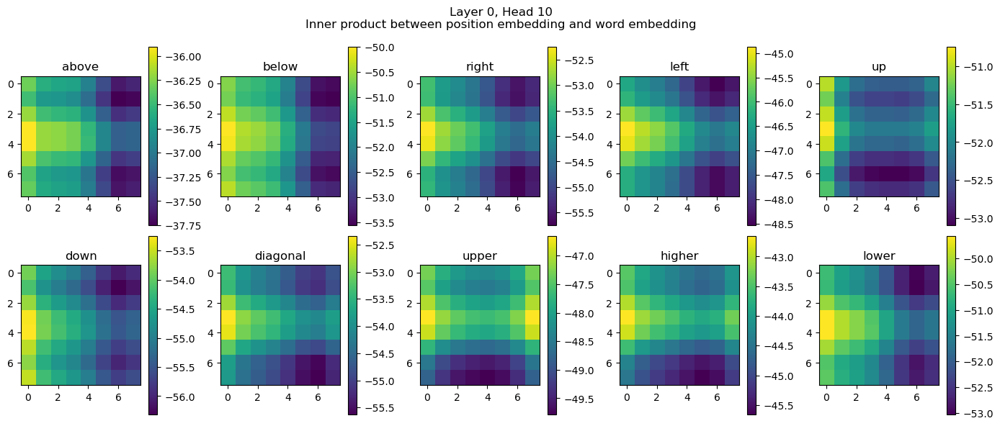

Layer 0, Head 11
Layer 0, Head 11 has min correlation -0.295654296875 | Max inner product -35.0 Examine.


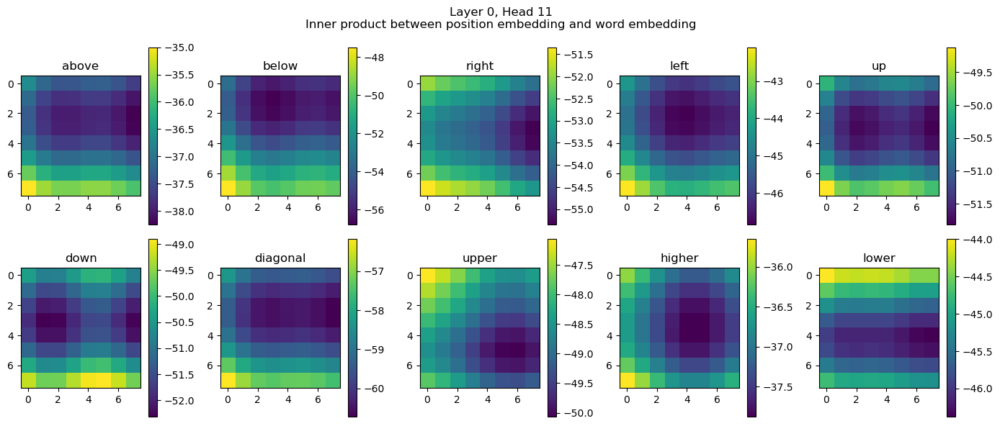

Layer 1, Head 0
Layer 1, Head 1
Layer 1, Head 2
Layer 1, Head 2 has min correlation 0.2039794921875 | Max inner product -11.7421875 Examine.


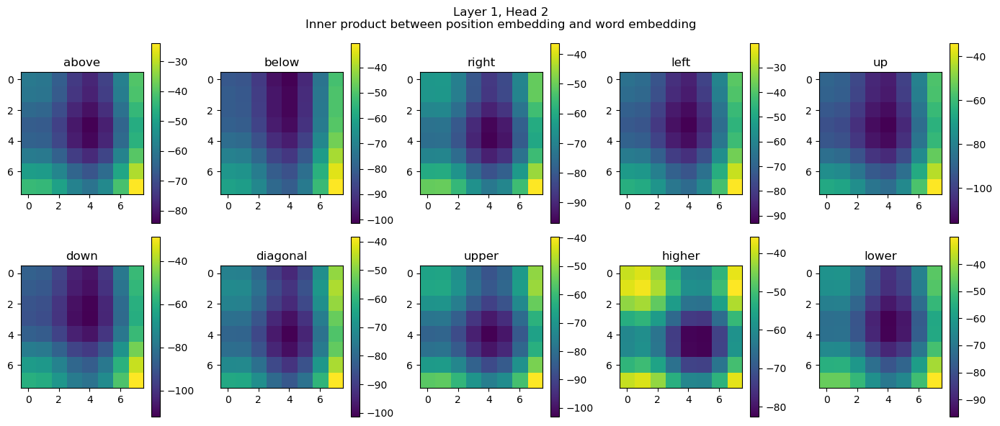

Layer 1, Head 3
Layer 1, Head 3 has min correlation -0.421630859375 | Max inner product -31.4375 Examine.


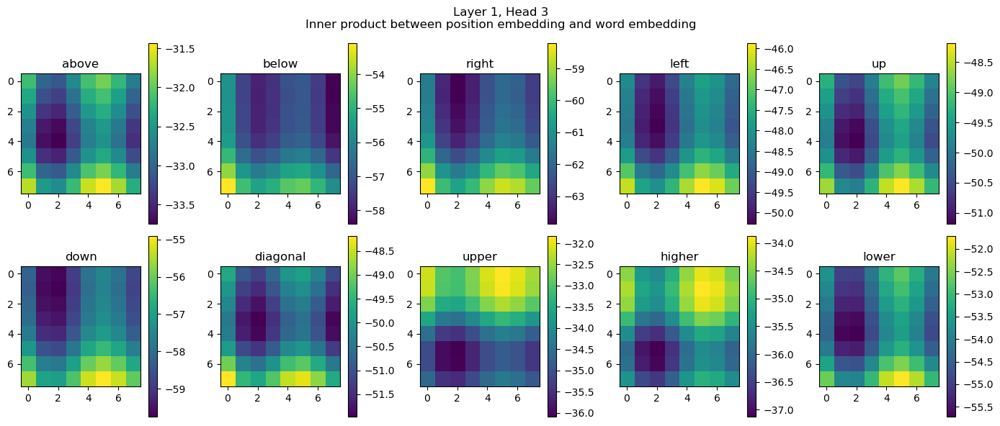

Layer 1, Head 4
Layer 1, Head 5
Layer 1, Head 5 has min correlation -0.0082855224609375 | Max inner product -32.8125 Examine.


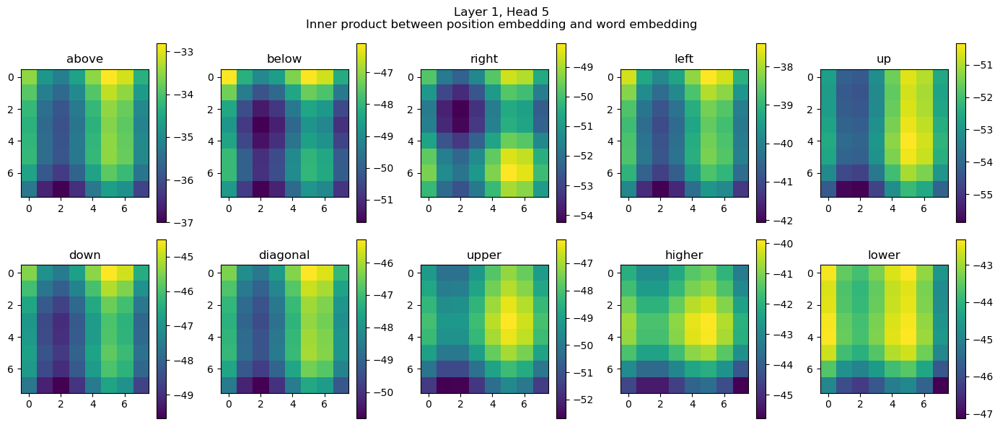

Layer 1, Head 6
Layer 1, Head 6 has min correlation 0.132568359375 | Max inner product -31.90625 Examine.


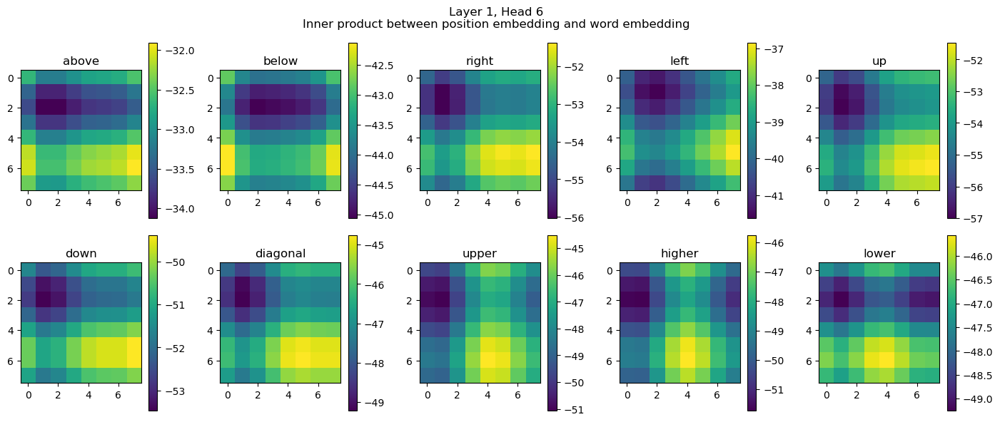

Layer 1, Head 7
Layer 1, Head 7 has min correlation -0.0192413330078125 | Max inner product -19.25 Examine.


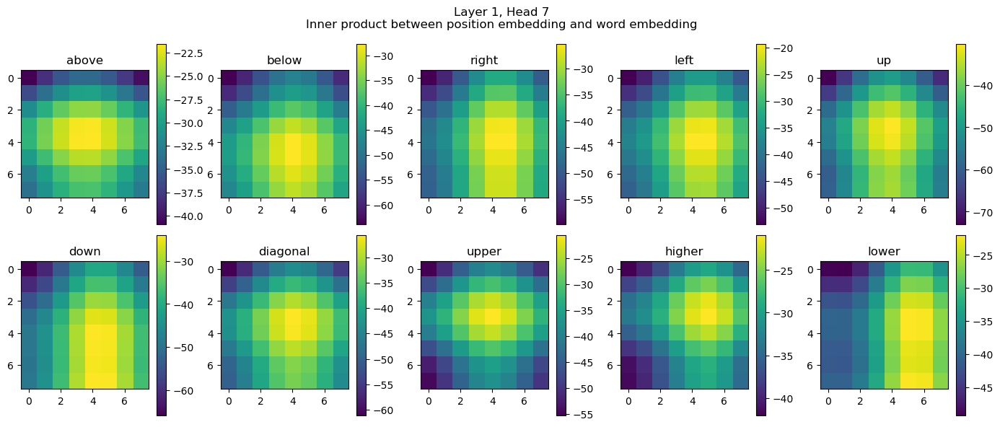

Layer 1, Head 8
Layer 1, Head 8 has min correlation -0.82763671875 | Max inner product -33.53125 Examine.


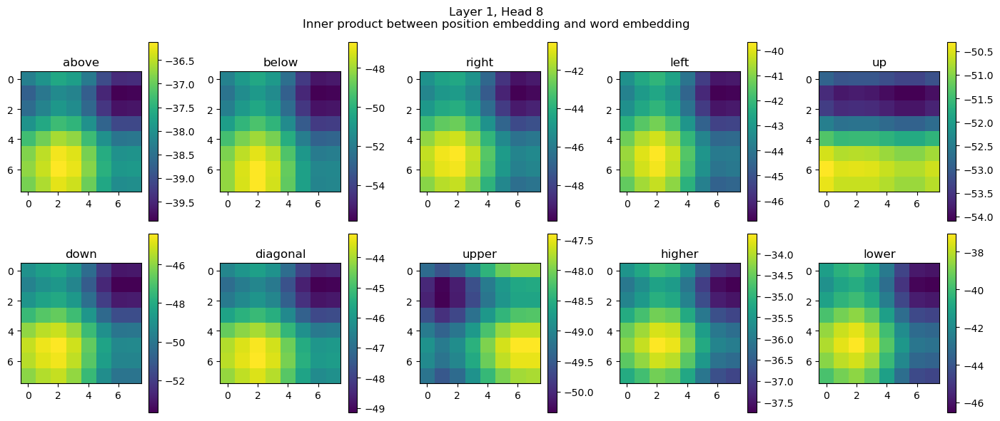

Layer 1, Head 9
Layer 1, Head 9 has min correlation 0.41943359375 | Max inner product 8.2734375 Examine.


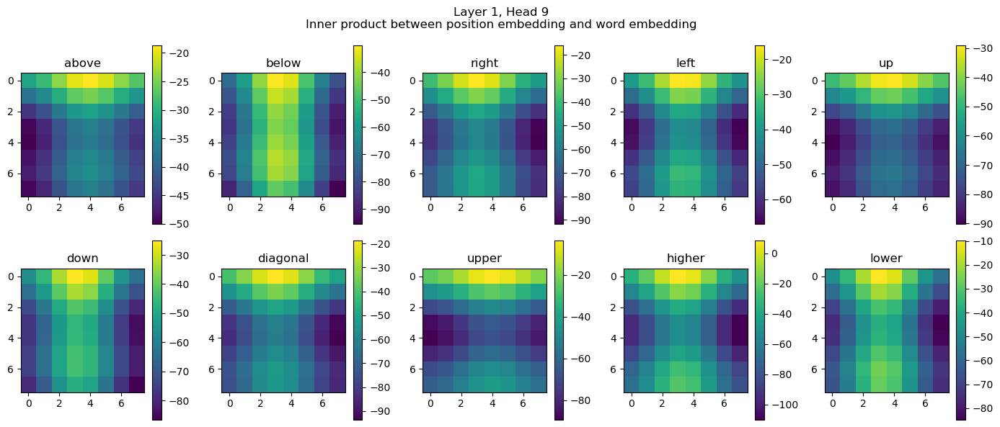

Layer 1, Head 10
Layer 1, Head 10 has min correlation -0.884765625 | Max inner product -29.078125 Examine.


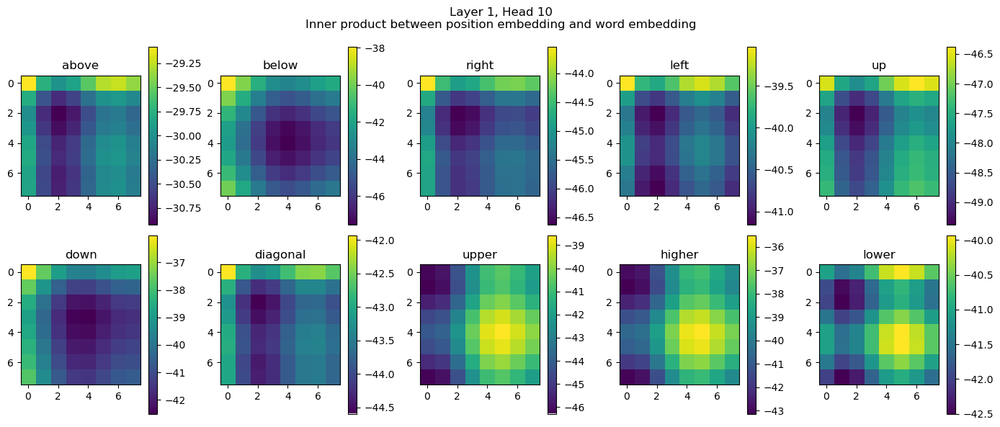

Layer 1, Head 11
Layer 1, Head 11 has min correlation -0.6318359375 | Max inner product -35.84375 Examine.


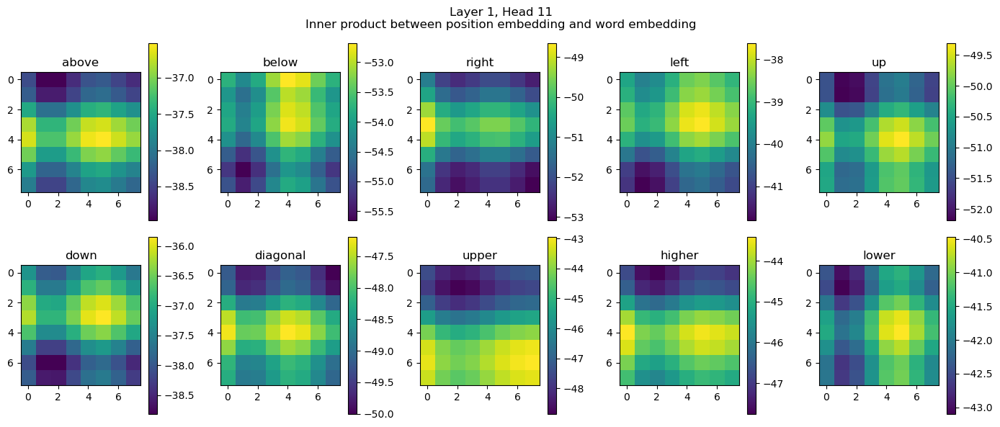

Layer 2, Head 0
Layer 2, Head 1
Layer 2, Head 2
Layer 2, Head 2 has min correlation 0.207763671875 | Max inner product -31.890625 Examine.


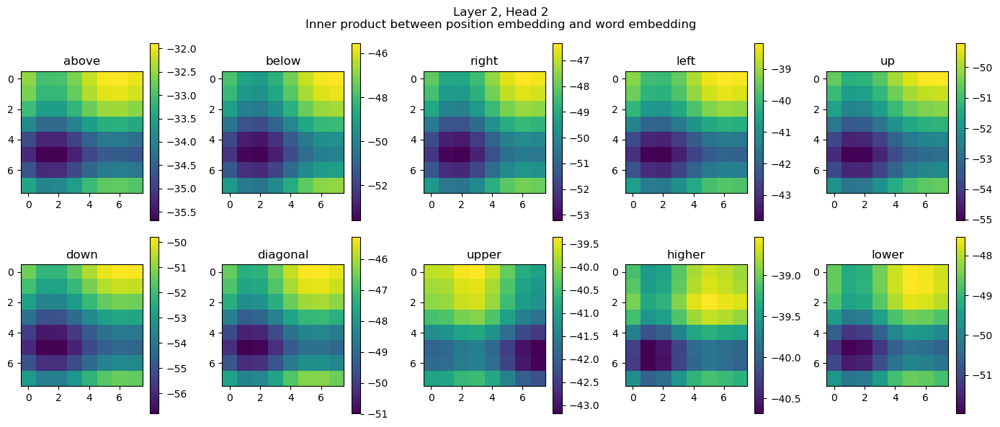

Layer 2, Head 3
Layer 2, Head 4
Layer 2, Head 4 has min correlation -0.68212890625 | Max inner product -14.6015625 Examine.


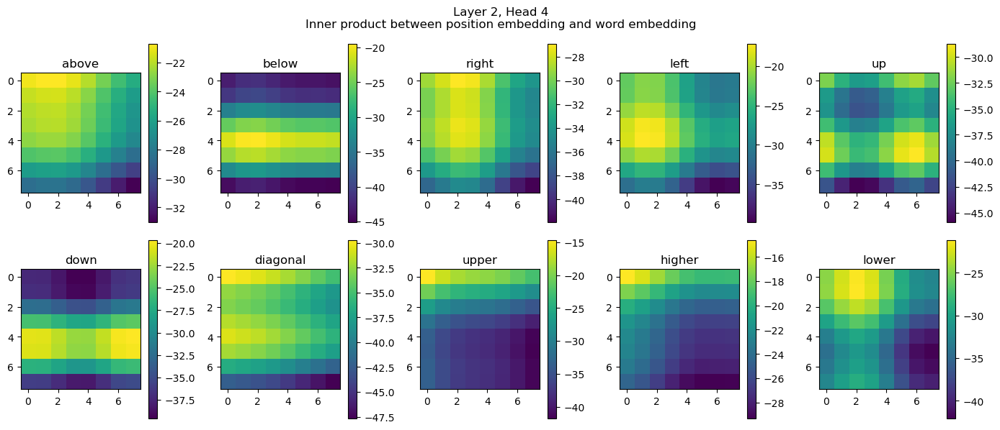

Layer 2, Head 5
Layer 2, Head 5 has min correlation -0.66015625 | Max inner product -28.546875 Examine.


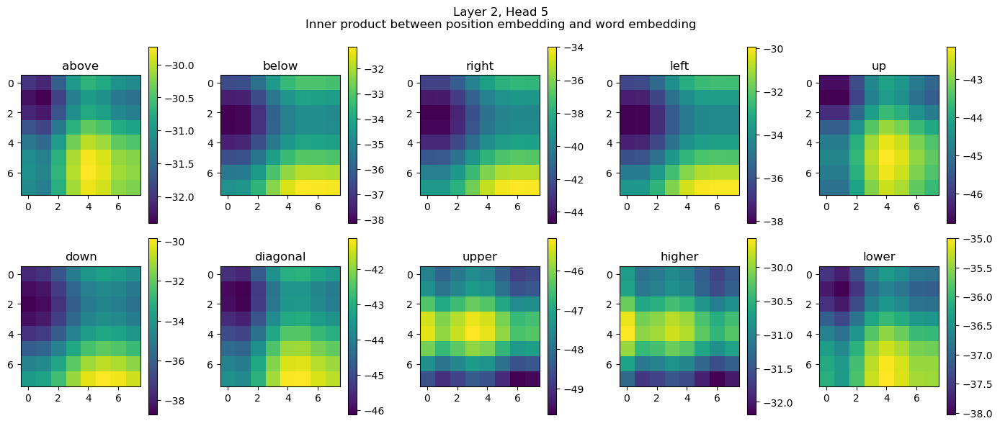

Layer 2, Head 6
Layer 2, Head 6 has min correlation 0.47216796875 | Max inner product 6.69921875 Examine.


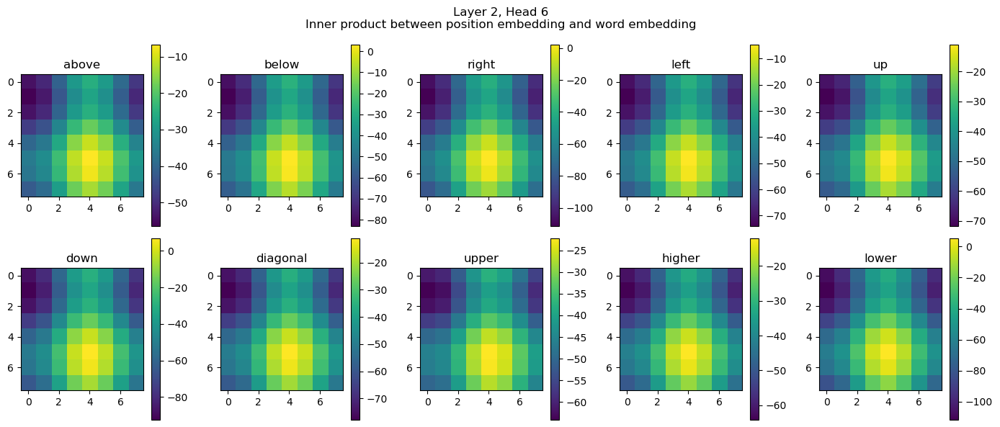

Layer 2, Head 7
Layer 2, Head 8
Layer 2, Head 8 has min correlation -0.062469482421875 | Max inner product -31.65625 Examine.


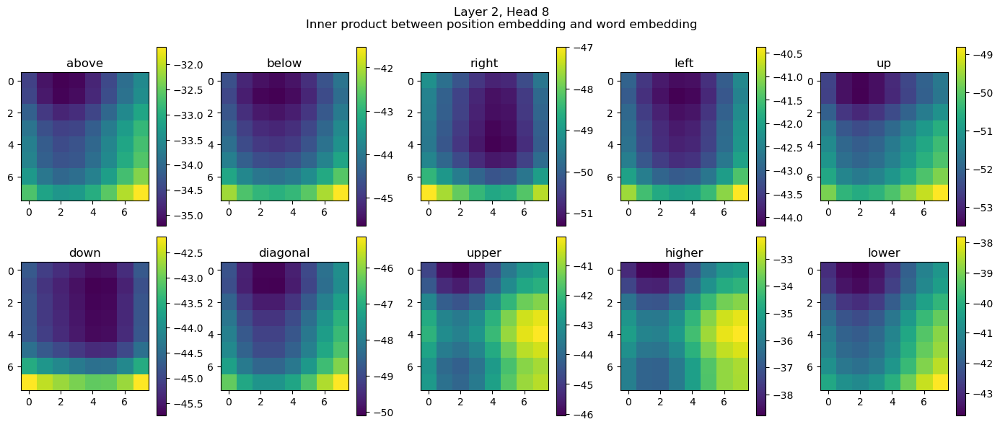

Layer 2, Head 9
Layer 2, Head 9 has min correlation -0.6083984375 | Max inner product -14.7109375 Examine.


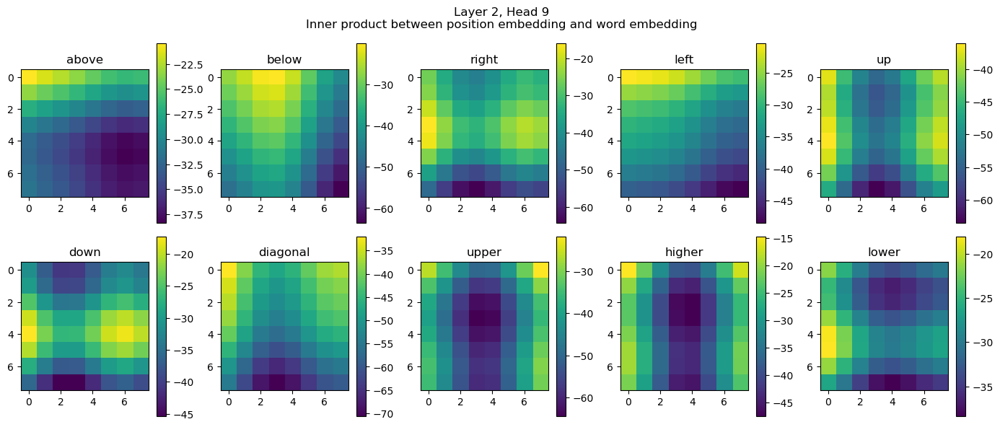

Layer 2, Head 10
Layer 2, Head 10 has min correlation 0.318359375 | Max inner product -33.25 Examine.


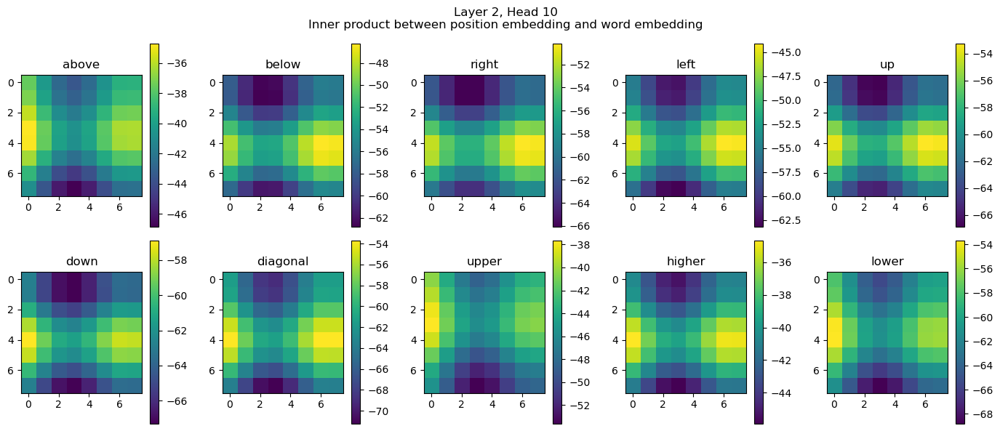

Layer 2, Head 11
Layer 2, Head 11 has min correlation 0.297119140625 | Max inner product -29.09375 Examine.


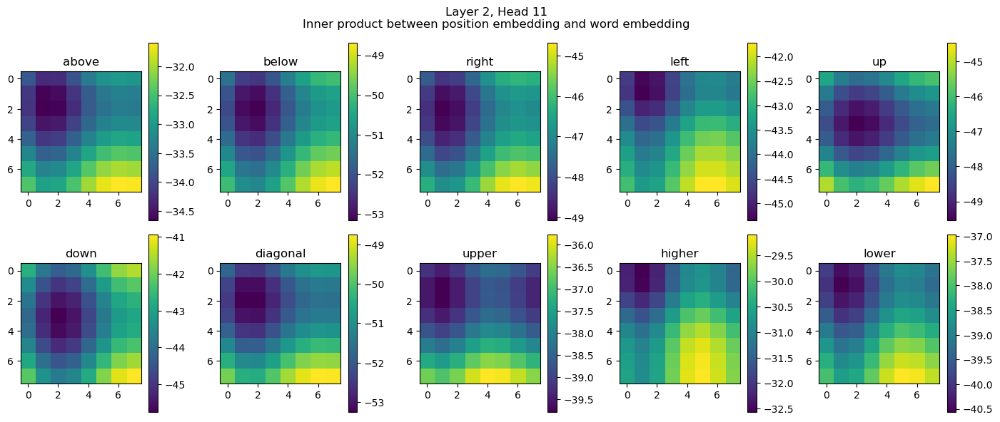

Layer 3, Head 0
Layer 3, Head 0 has min correlation -0.3623046875 | Max inner product -12.46875 Examine.


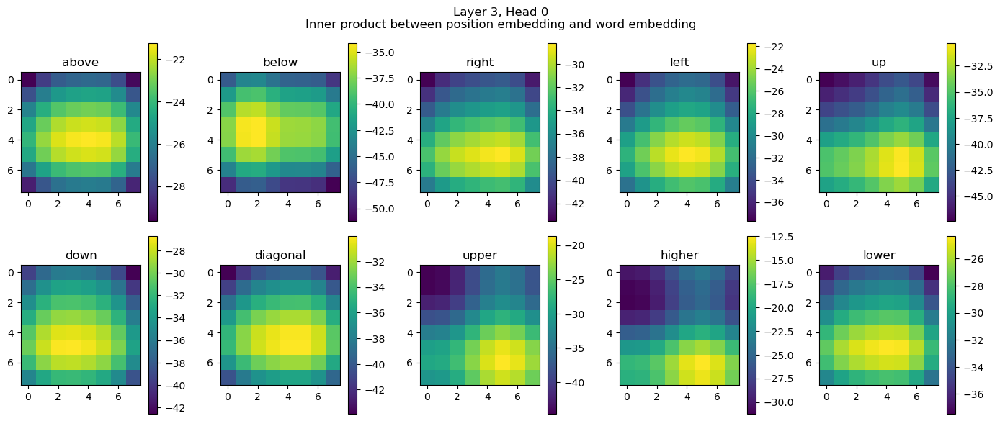

Layer 3, Head 1
Layer 3, Head 1 has min correlation 0.299072265625 | Max inner product -4.015625 Examine.


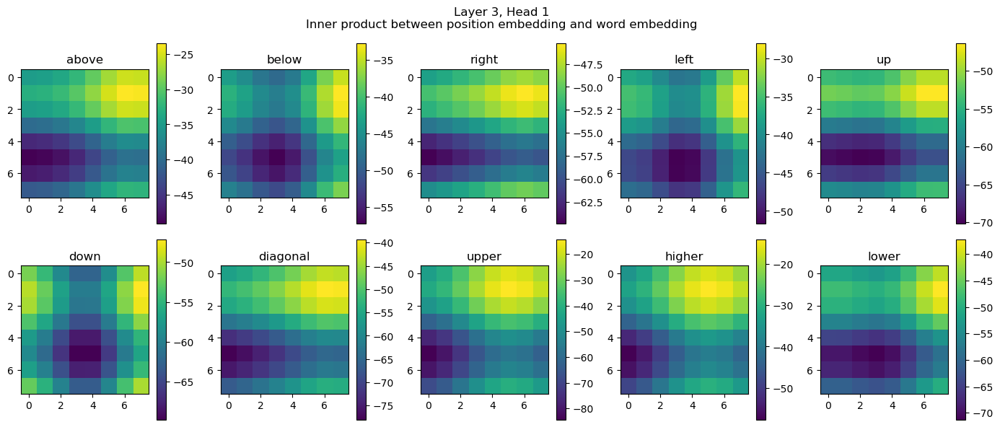

Layer 3, Head 2
Layer 3, Head 3
Layer 3, Head 3 has min correlation -0.48974609375 | Max inner product -17.828125 Examine.


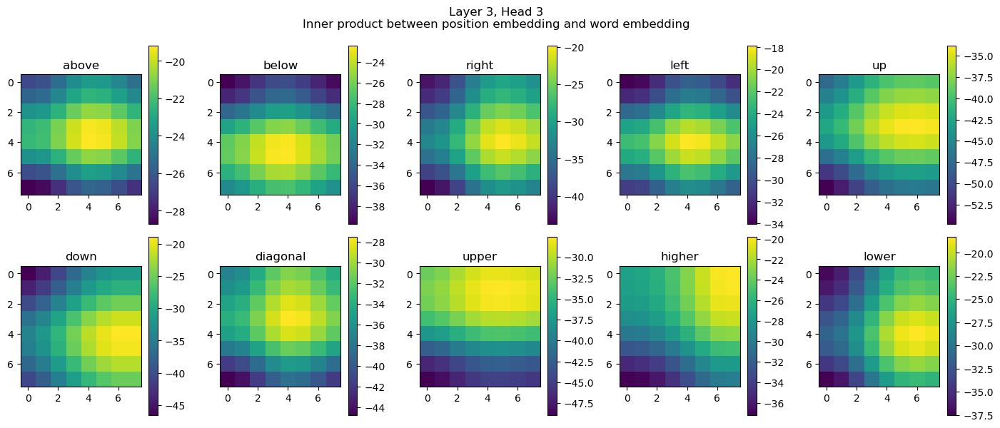

Layer 3, Head 4
Layer 3, Head 5
Layer 3, Head 5 has min correlation -0.4208984375 | Max inner product -2.6328125 Examine.


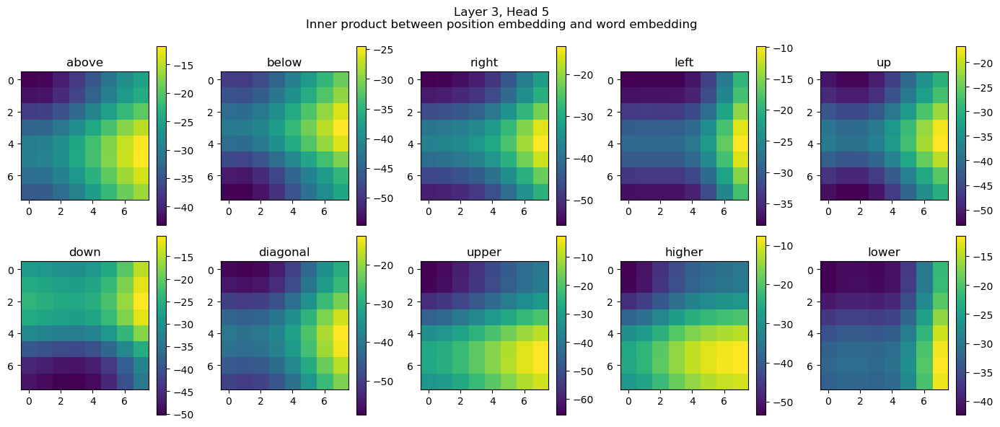

Layer 3, Head 6
Layer 3, Head 7
Layer 3, Head 8
Layer 3, Head 9
Layer 3, Head 9 has min correlation -0.64306640625 | Max inner product -22.203125 Examine.


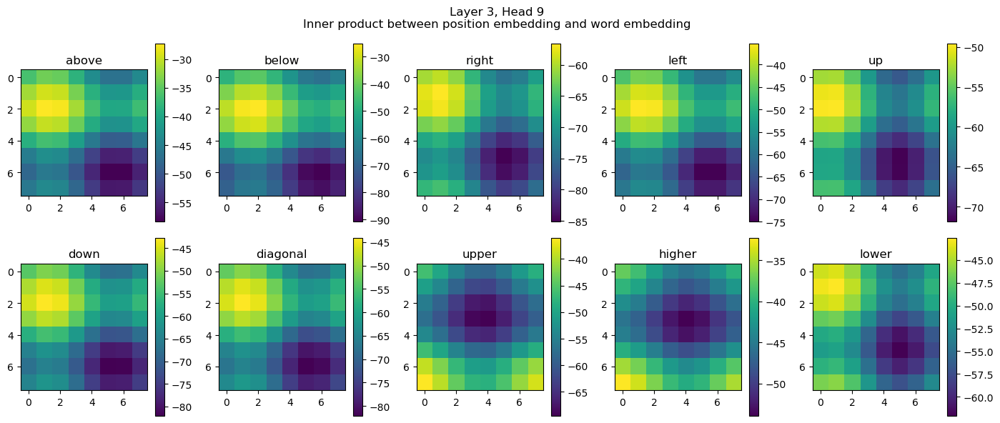

Layer 3, Head 10
Layer 3, Head 11
Layer 3, Head 11 has min correlation -0.634765625 | Max inner product -1.3291015625 Examine.


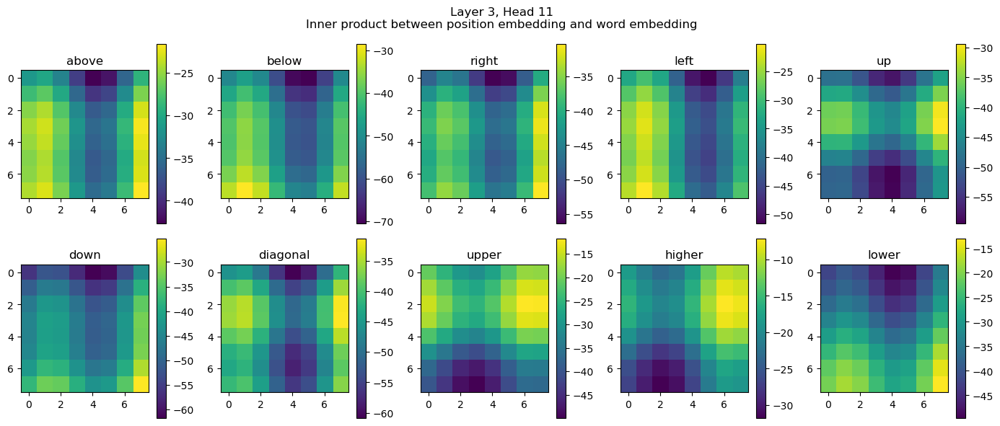

Layer 4, Head 0
Layer 4, Head 0 has min correlation 0.2296142578125 | Max inner product -19.546875 Examine.


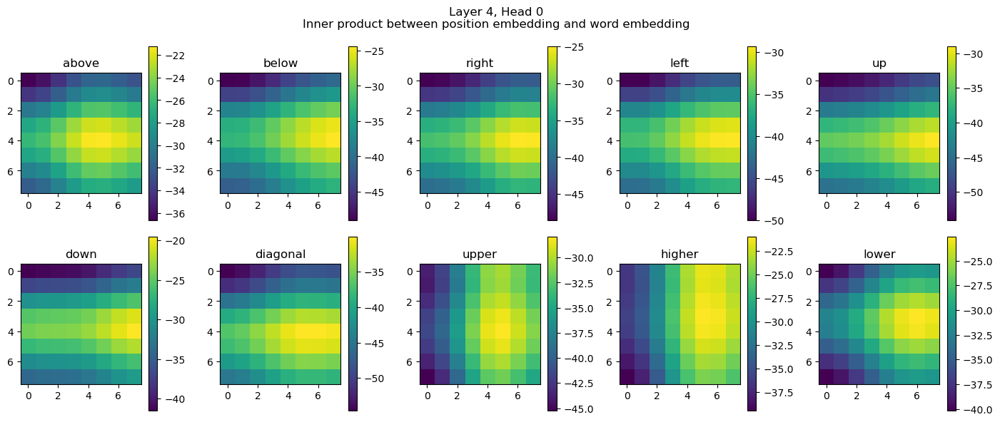

Layer 4, Head 1
Layer 4, Head 2
Layer 4, Head 2 has min correlation -0.11895751953125 | Max inner product -18.21875 Examine.


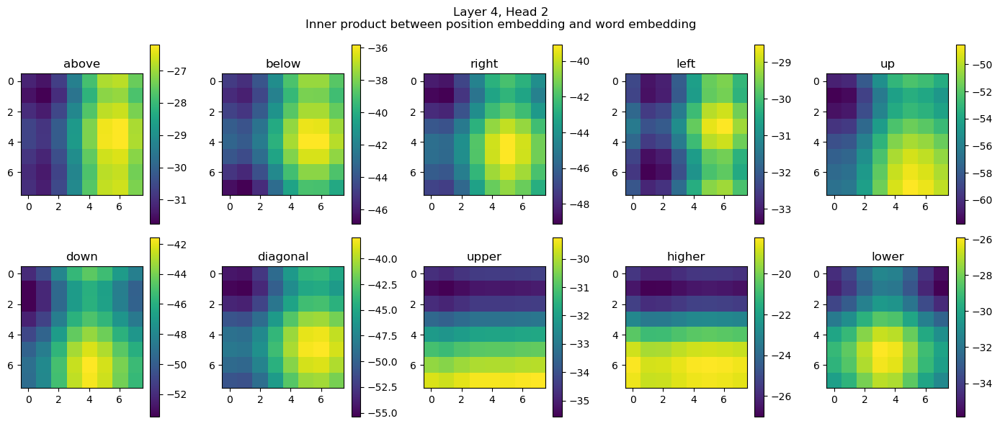

Layer 4, Head 3
Layer 4, Head 4
Layer 4, Head 4 has min correlation -0.9501953125 | Max inner product 18.296875 Examine.


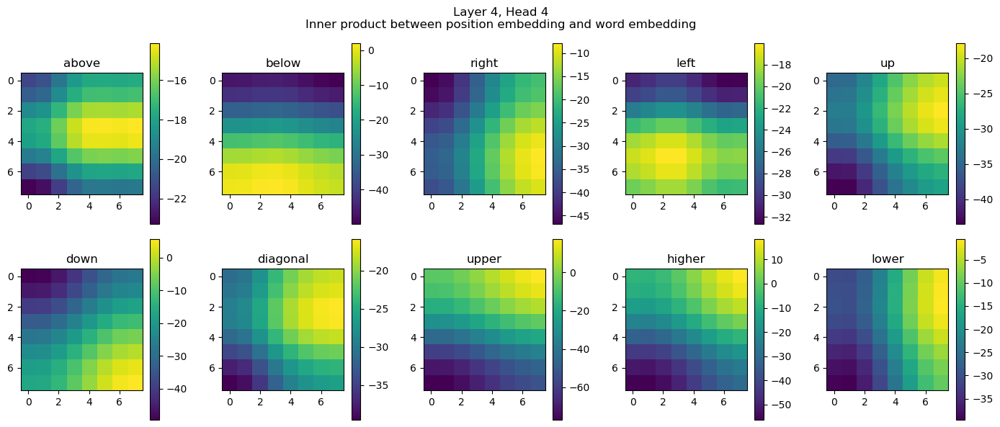

Layer 4, Head 5
Layer 4, Head 6
Layer 4, Head 6 has min correlation -0.461181640625 | Max inner product -2.205078125 Examine.


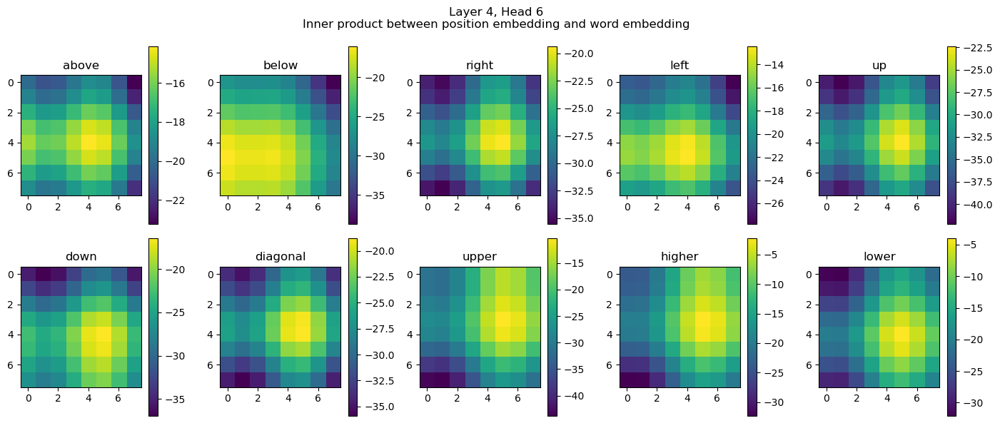

Layer 4, Head 7
Layer 4, Head 8
Layer 4, Head 9
Layer 4, Head 10
Layer 4, Head 11
Layer 5, Head 0
Layer 5, Head 0 has min correlation 0.19189453125 | Max inner product -9.3828125 Examine.


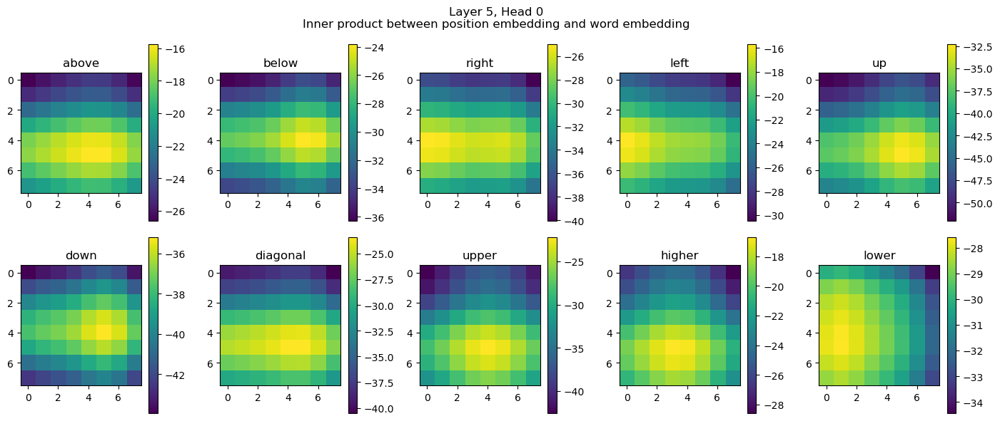

Layer 5, Head 1
Layer 5, Head 2
Layer 5, Head 2 has min correlation -0.30322265625 | Max inner product 20.75 Examine.


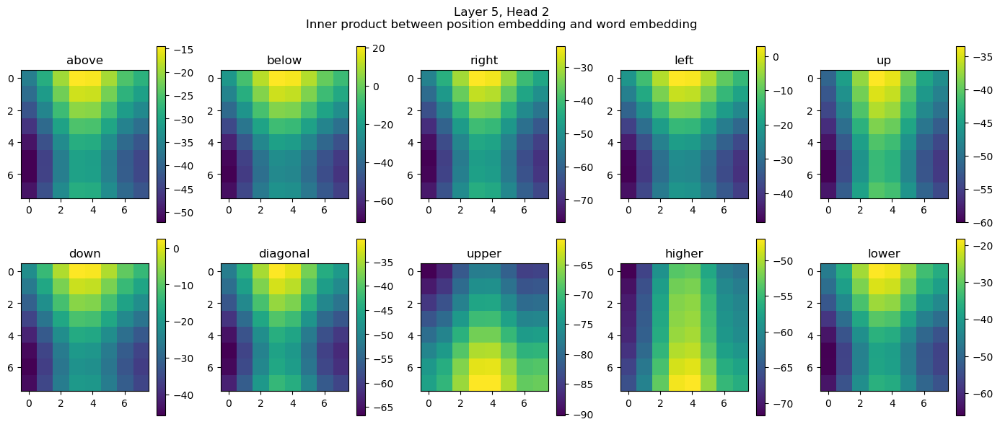

Layer 5, Head 3
Layer 5, Head 3 has min correlation -0.73779296875 | Max inner product -1.59765625 Examine.


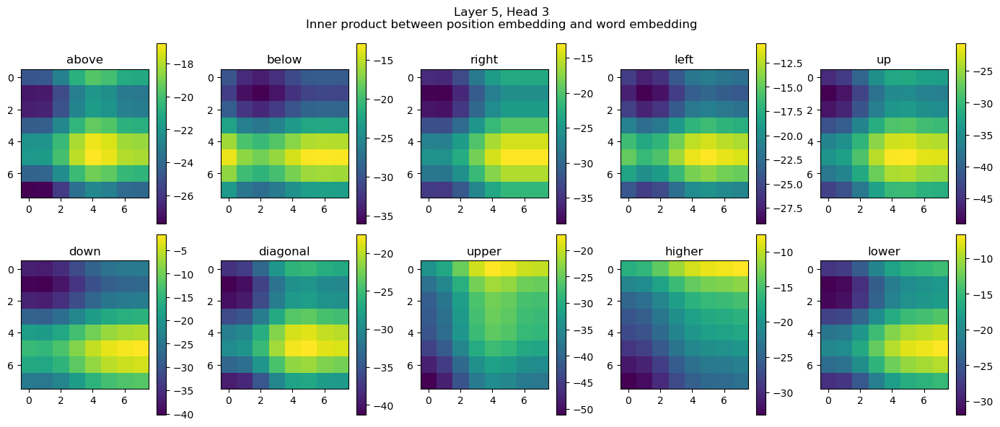

Layer 5, Head 4
Layer 5, Head 5
Layer 5, Head 5 has min correlation -0.2200927734375 | Max inner product 17.625 Examine.


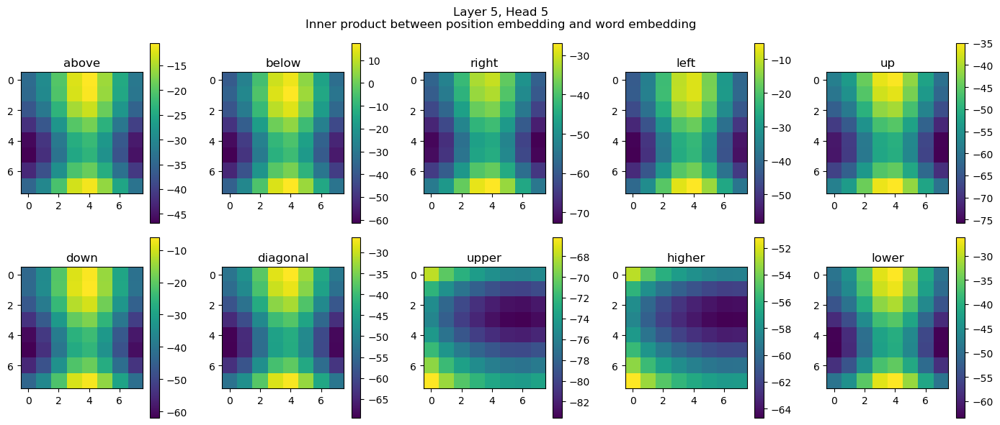

Layer 5, Head 6
Layer 5, Head 7
Layer 5, Head 8
Layer 5, Head 8 has min correlation 0.2294921875 | Max inner product 25.1875 Examine.


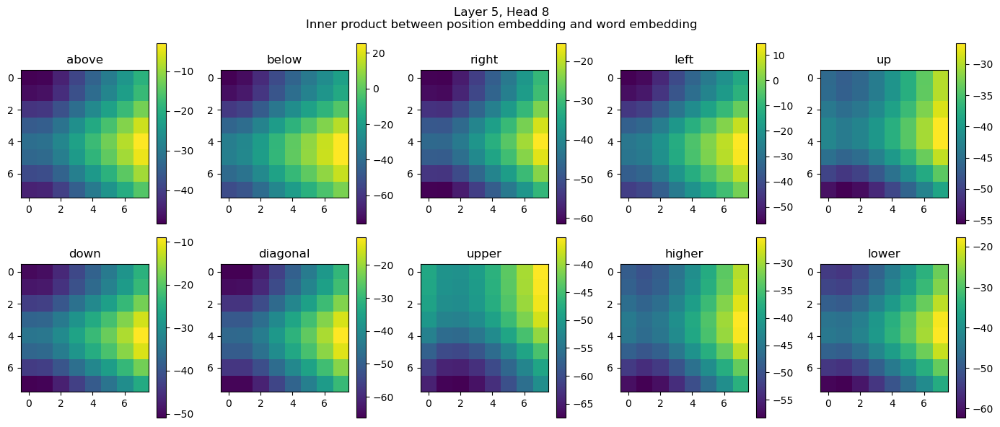

Layer 5, Head 9
Layer 5, Head 10
Layer 5, Head 10 has min correlation 0.1861572265625 | Max inner product -12.28125 Examine.


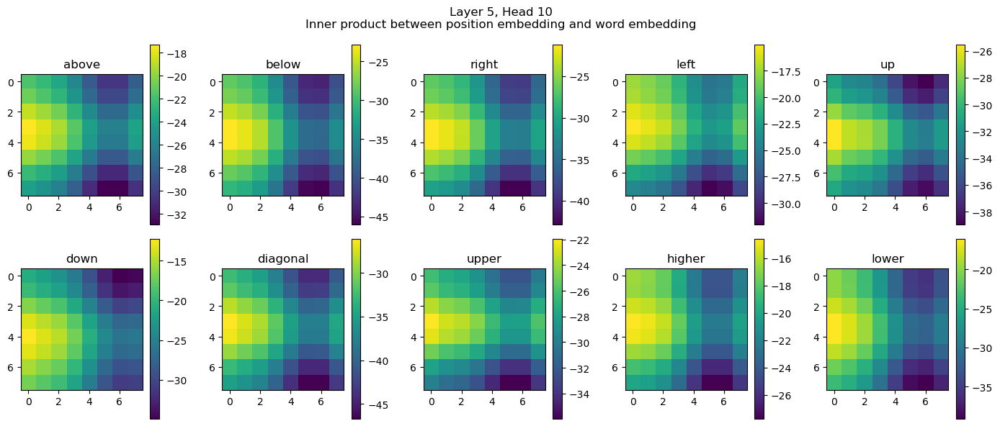

Layer 5, Head 11
Layer 5, Head 11 has min correlation -0.60009765625 | Max inner product 13.6015625 Examine.


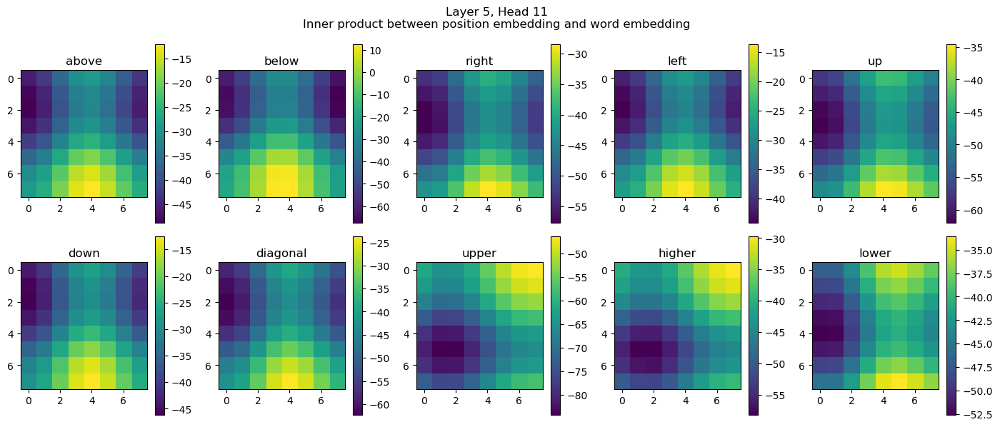

Layer 6, Head 0
Layer 6, Head 0 has min correlation -0.255126953125 | Max inner product 7.2265625 Examine.


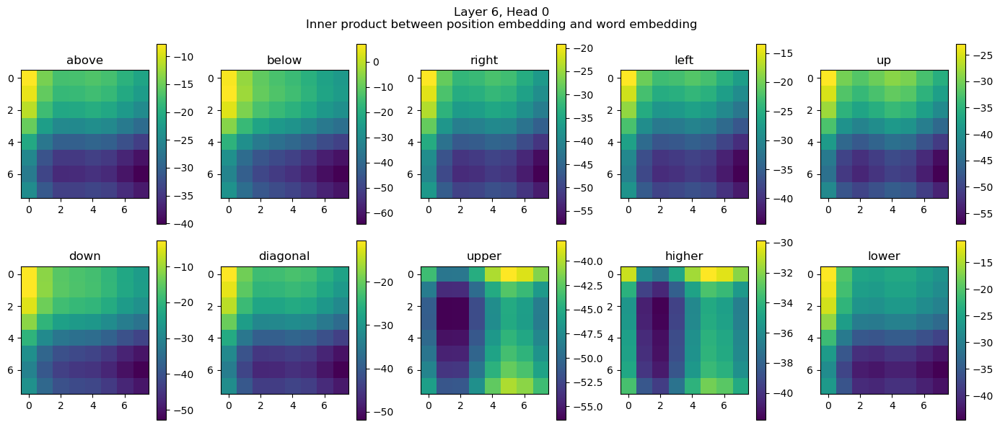

Layer 6, Head 1
Layer 6, Head 1 has min correlation -0.5419921875 | Max inner product 6.1953125 Examine.


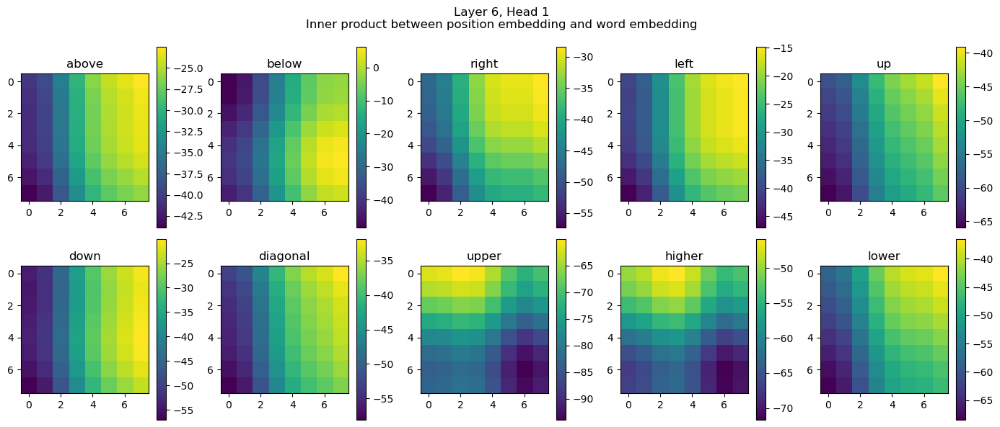

Layer 6, Head 2
Layer 6, Head 3
Layer 6, Head 3 has min correlation -0.2122802734375 | Max inner product -23.375 Examine.


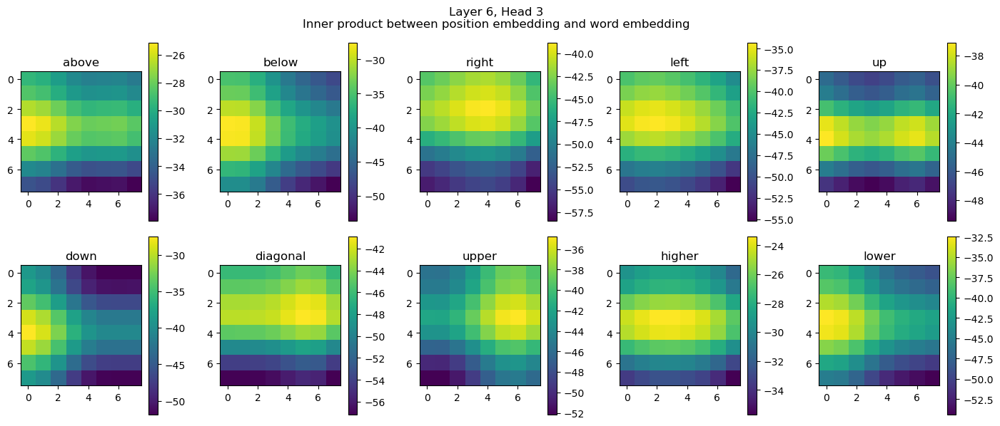

Layer 6, Head 4
Layer 6, Head 5
Layer 6, Head 6
Layer 6, Head 7
Layer 6, Head 8
Layer 6, Head 9
Layer 6, Head 10
Layer 6, Head 11
Layer 7, Head 0
Layer 7, Head 1
Layer 7, Head 1 has min correlation 0.4052734375 | Max inner product -9.4453125 Examine.


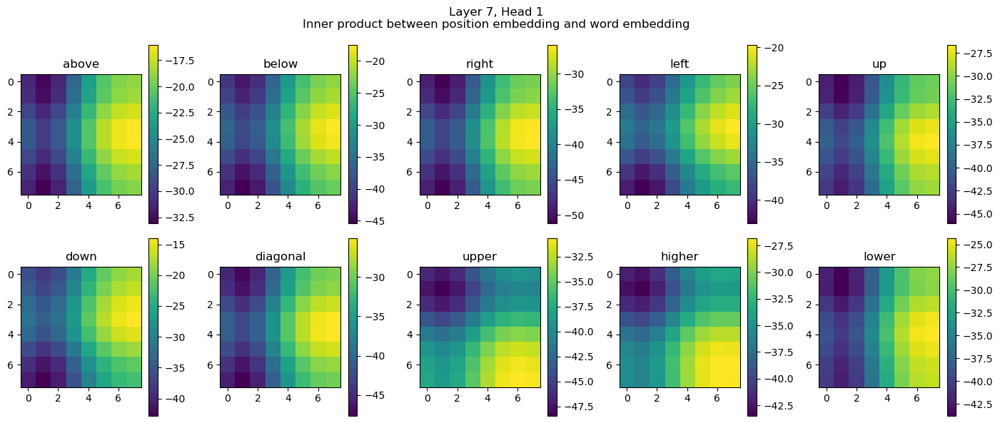

Layer 7, Head 2
Layer 7, Head 3
Layer 7, Head 3 has min correlation 0.487548828125 | Max inner product -4.03515625 Examine.


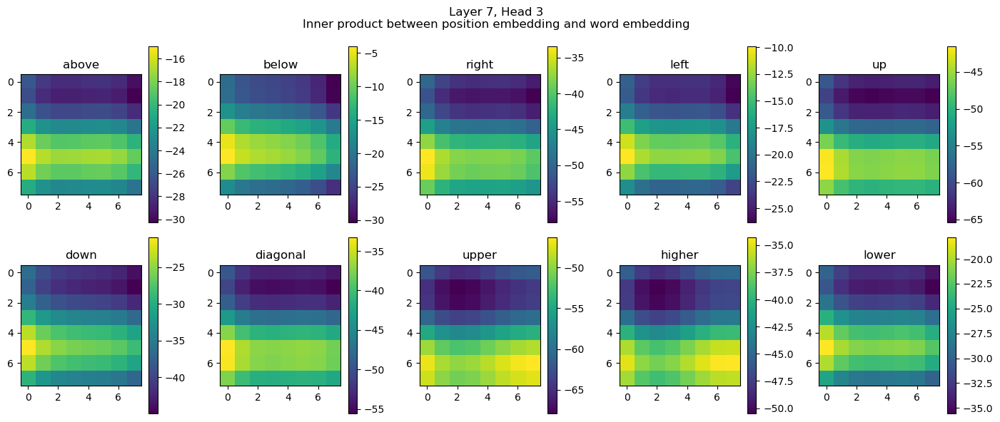

Layer 7, Head 4
Layer 7, Head 5
Layer 7, Head 6
Layer 7, Head 6 has min correlation -0.10260009765625 | Max inner product 6.48828125 Examine.


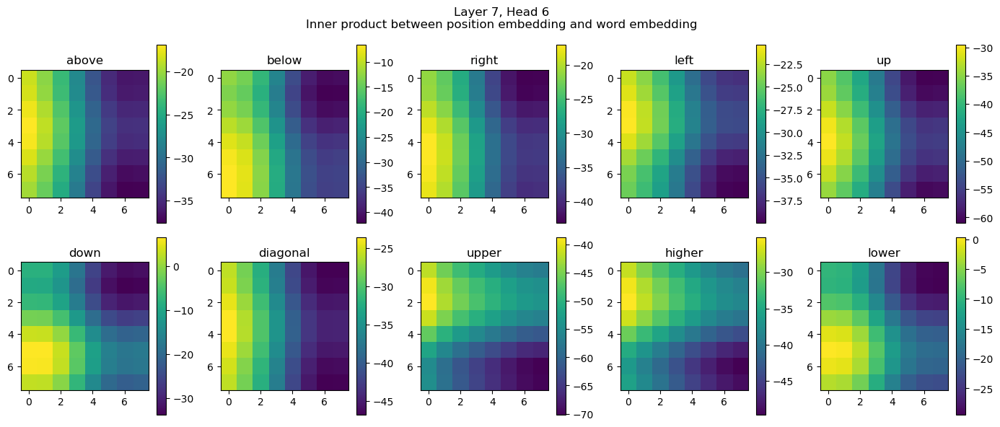

Layer 7, Head 7
Layer 7, Head 7 has min correlation 0.376953125 | Max inner product 6.82421875 Examine.


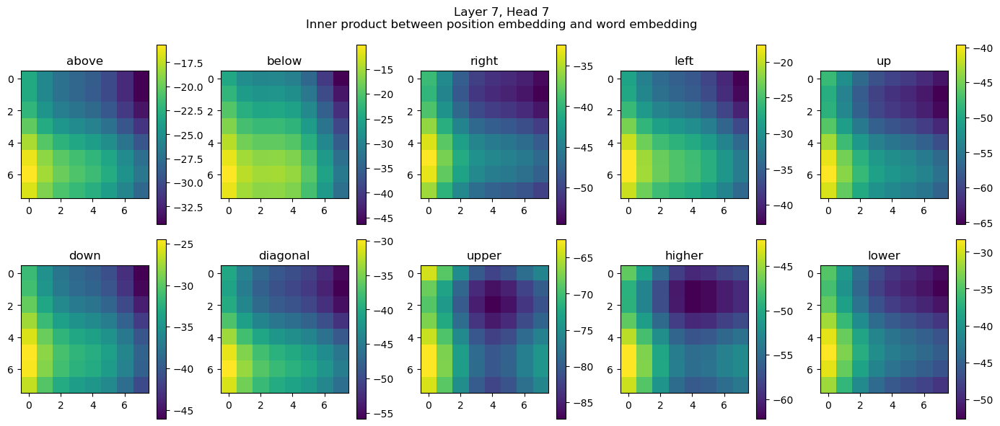

Layer 7, Head 8
Layer 7, Head 9
Layer 7, Head 10
Layer 7, Head 11
Layer 8, Head 0
Layer 8, Head 1
Layer 8, Head 1 has min correlation 0.469482421875 | Max inner product -16.75 Examine.


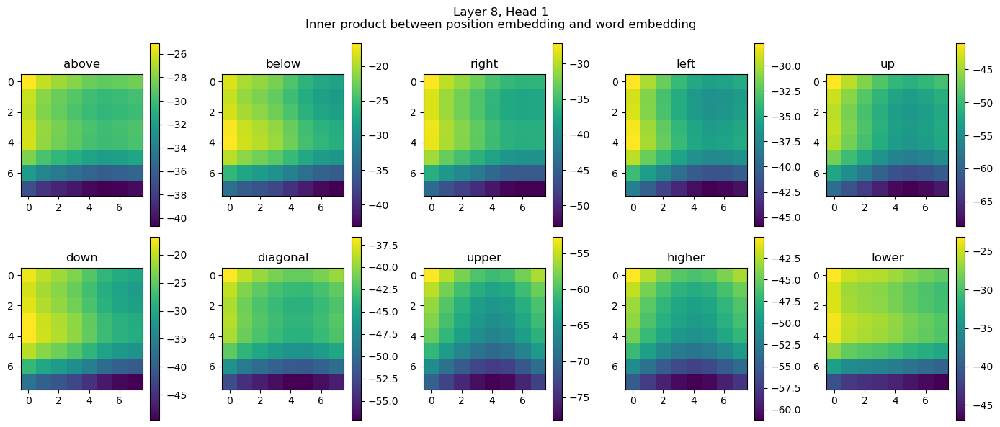

Layer 8, Head 2
Layer 8, Head 2 has min correlation 0.29541015625 | Max inner product 8.703125 Examine.


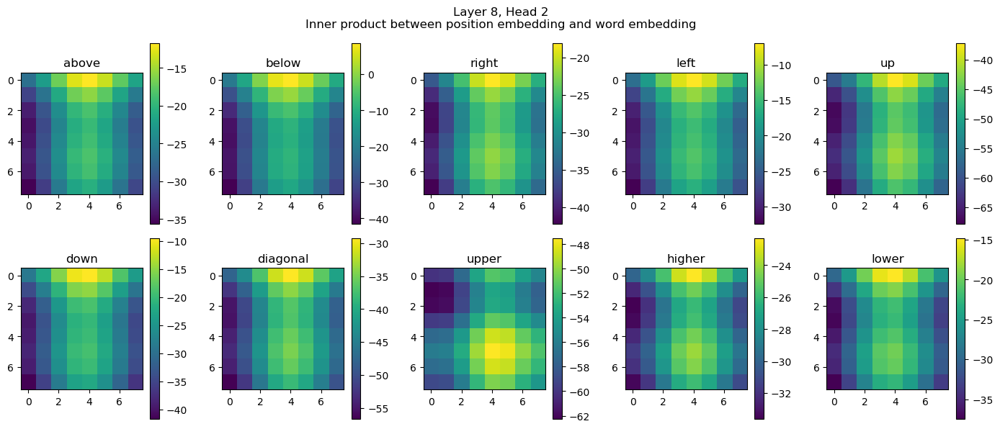

Layer 8, Head 3
Layer 8, Head 4
Layer 8, Head 5
Layer 8, Head 6
Layer 8, Head 6 has min correlation -0.143310546875 | Max inner product 2.31640625 Examine.


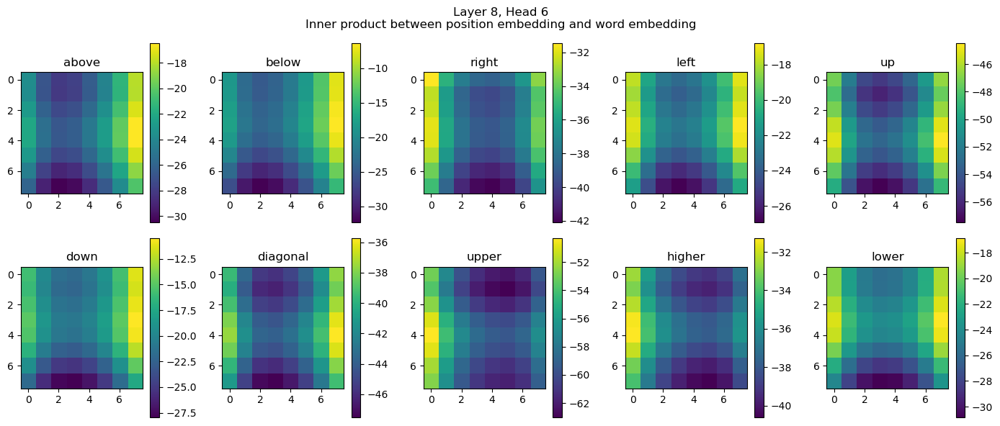

Layer 8, Head 7
Layer 8, Head 7 has min correlation 0.190673828125 | Max inner product 2.29296875 Examine.


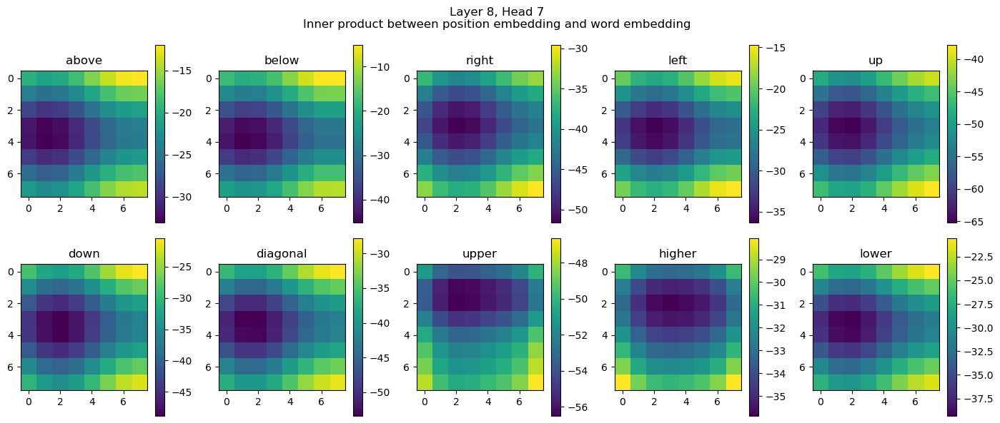

Layer 8, Head 8
Layer 8, Head 9
Layer 8, Head 10
Layer 8, Head 11
Layer 9, Head 0
Layer 9, Head 1
Layer 9, Head 2
Layer 9, Head 3
Layer 9, Head 4
Layer 9, Head 5
Layer 9, Head 6
Layer 9, Head 6 has min correlation 0.28076171875 | Max inner product -4.078125 Examine.


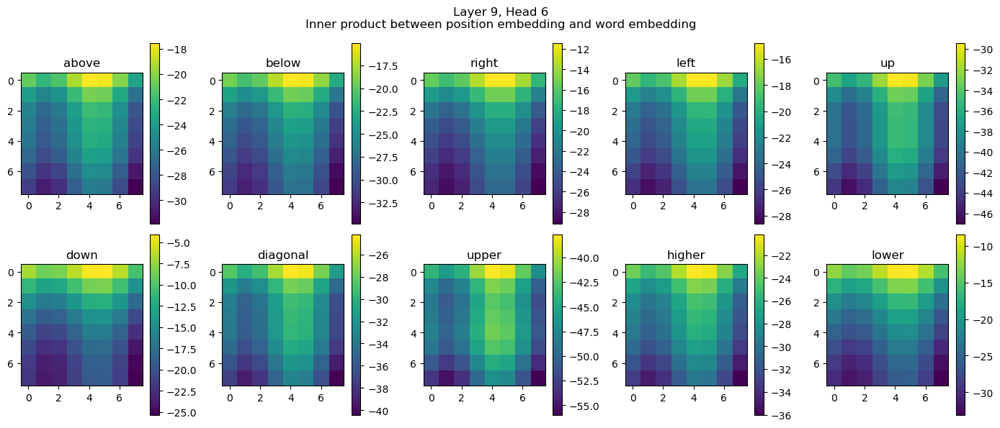

Layer 9, Head 7
Layer 9, Head 8
Layer 9, Head 9
Layer 9, Head 10
Layer 9, Head 11
Layer 10, Head 0
Layer 10, Head 1
Layer 10, Head 2
Layer 10, Head 3
Layer 10, Head 4
Layer 10, Head 5
Layer 10, Head 6
Layer 10, Head 7
Layer 10, Head 8
Layer 10, Head 9
Layer 10, Head 10
Layer 10, Head 11
Layer 11, Head 0
Layer 11, Head 1
Layer 11, Head 2
Layer 11, Head 3
Layer 11, Head 4
Layer 11, Head 5
Layer 11, Head 6
Layer 11, Head 7
Layer 11, Head 8
Layer 11, Head 9
Layer 11, Head 10
Layer 11, Head 11


In [106]:
# define head screening 
hidden_size = pipeline.transformer.config["cross_attention_dim"]
base_size = 8
num_heads = pipeline.transformer.config["num_attention_heads"]
num_layers = pipeline.transformer.config["num_layers"]
head_dim = hidden_size // num_heads
head_idx = 8
layer_idx = 2
    
device = "cuda"
# prompt = "top down bottom up left right below above next to"
prompt_tokenized = ["above", "below", "right", "left", "up", "down", "diagonal", "upper", "higher", "lower", "directly", "from",]
# prompt_tokenized = prompt.split(" ")
token_ids = pipeline.tokenizer.encode(" ".join(prompt_tokenized), max_length=30, truncation=False, return_tensors="pt").to(device)
with torch.no_grad():
    word_embeds = pipeline.text_encoder(token_ids).last_hidden_state # , attn_mask
word_embeds_proj = pipeline.transformer.caption_projection(word_embeds)
pos_embed = get_2d_sincos_pos_embed(hidden_size, (base_size, base_size), base_size=base_size)
pos_embed = torch.from_numpy(pos_embed).unsqueeze(0).half().to(device)

for layer_idx in range(num_layers):
    for head_idx in range(num_heads):   
        print(f"Layer {layer_idx}, Head {head_idx}")
        word_embed_2k = pipeline.transformer.transformer_blocks[layer_idx].attn2.to_k(word_embeds_proj)
        word_embed_2k_h8 = word_embed_2k[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
        word_embed_2v = pipeline.transformer.transformer_blocks[layer_idx].attn2.to_v(word_embeds_proj)
        word_embed_2v_h8 = word_embed_2v[0, :, head_idx*head_dim:(head_idx+1)*head_dim]

        pos_embed_2q = pipeline.transformer.transformer_blocks[layer_idx].attn2.to_q(pos_embed)
        pos_embed_2q_h8 = pos_embed_2q[0, :, head_idx*head_dim:(head_idx+1)*head_dim]
        inner_prods = (pos_embed_2q_h8 @ word_embed_2k_h8.T).detach().cpu()
        corr_matrix = torch.corrcoef(inner_prods[:, :-1].T)
        
        min_corr = corr_matrix.min()
        # padding_inner_prods_max = inner_prods[:, -1].max()
        if min_corr < 0.5:
            print(f"Layer {layer_idx}, Head {head_idx} has min correlation {min_corr.item()} | Max inner product {inner_prods[:, :-1].max().item()} Examine.")
            figh, axs = plt.subplots(2, 5, figsize=(14, 6))
            axs = axs.flatten()
            for i_word in range(min(len(prompt_tokenized), 10)):
                plt.sca(axs[i_word])
                inner_prod = inner_prods[:, i_word:i_word+1]
                plt.imshow(inner_prod.view(base_size, base_size).detach().cpu().numpy(), )
                plt.colorbar()
                plt.title(prompt_tokenized[i_word])
            plt.suptitle(f"Layer {layer_idx}, Head {head_idx}\nInner product between position embedding and word embedding")
            plt.tight_layout()
            plt.show()

In [103]:
corr_matrix = torch.corrcoef(inner_prods.T)

In [104]:
corr_matrix

tensor([[1.0000, 0.9995, 0.9995, 0.9990, 0.9995, 0.9995, 0.9995, 0.9966, 0.9971,
         0.9995, 0.9995, 0.9995, 0.9912],
        [0.9990, 1.0000, 1.0000, 1.0000, 0.9990, 1.0000, 0.9980, 0.9922, 0.9937,
         0.9971, 0.9995, 0.9971, 0.9917],
        [1.0000, 1.0000, 1.0000, 1.0000, 0.9995, 1.0000, 0.9985, 0.9951, 0.9971,
         0.9980, 0.9995, 0.9985, 0.9917],
        [0.9990, 1.0000, 1.0000, 1.0000, 0.9995, 1.0000, 0.9976, 0.9932, 0.9951,
         0.9976, 0.9995, 0.9971, 0.9883],
        [0.9990, 0.9990, 0.9995, 0.9990, 1.0000, 0.9995, 0.9995, 0.9956, 0.9961,
         0.9995, 0.9995, 0.9985, 0.9922],
        [0.9990, 1.0000, 1.0000, 1.0000, 0.9995, 1.0000, 0.9980, 0.9932, 0.9946,
         0.9985, 0.9995, 0.9971, 0.9897],
        [0.9990, 0.9976, 0.9990, 0.9976, 0.9995, 0.9985, 0.9995, 0.9980, 0.9985,
         1.0000, 0.9985, 1.0000, 0.9912],
        [0.9966, 0.9922, 0.9951, 0.9932, 0.9956, 0.9927, 0.9976, 1.0000, 1.0000,
         0.9976, 0.9956, 0.9985, 0.9858],
        [0.9971,